# Machine Learning-Based Clustering of Sepsis Patients in Intensive Care Settings

# importing the required libraries 
imports necessary libraries for data manipulation, visualization, machine learning, and statistical analysis in Python.

In [30]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
import matplotlib.cm as cm
import seaborn as sns

import math
from math import pi

from sklearn.model_selection import train_test_split
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import silhouette_score, make_scorer
from scipy.stats import uniform
from sklearn.manifold import TSNE
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score

import scipy.stats as stats  
from statsmodels.stats.multicomp import pairwise_tukeyhsd

# Read the data

In [3]:
data = pd.read_csv("AVG_sepsis_data.csv")

In [4]:
data

,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_mbp,avg_resp_rate,avg_temperature,avg_spo2,...,Congestive_Heart_Failure,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag,death_between_intime_outtime
0,72,1,5,112.96,101.67,64.07,73.57,19.66,36.67,97.41,...,1,0,0,1,0,1.0,1.0,0.0,0.0,0.0
1,82,0,2,78.32,110.69,42.34,60.14,21.11,36.81,97.26,...,1,0,0,0,0,1.0,1.0,0.0,0.0,0.0
2,69,1,6,78.14,106.04,50.40,70.15,19.57,36.66,97.81,...,0,0,0,1,0,1.0,1.0,1.0,0.0,0.0
3,51,0,2,87.18,115.46,72.85,82.44,17.40,37.13,97.97,...,0,0,0,0,0,1.0,0.0,0.0,0.0,0.0
4,78,0,3,83.28,101.55,53.08,72.53,19.41,36.34,95.26,...,1,1,0,0,0,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32843,65,1,2,101.00,100.57,70.43,76.43,17.17,37.26,98.00,...,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0
32844,59,0,3,96.67,96.78,69.56,75.78,23.78,37.36,99.89,...,1,0,0,0,1,0.0,0.0,0.0,0.0,0.0
32845,84,1,7,75.03,109.83,54.17,57.43,22.88,37.03,91.29,...,1,0,1,0,1,0.0,0.0,0.0,1.0,1.0
32846,71,0,3,132.80,121.00,88.00,98.00,28.00,NaN,79.40,...,0,0,1,0,0,0.0,0.0,0.0,1.0,1.0


showing the number of rows and columns.


In [5]:
data.shape

(32848, 45)

displays a concise summary of the data

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32848 entries, 0 to 32847
Data columns (total 45 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   anchor_age                      32848 non-null  int64  
 1   gender                          32848 non-null  int64  
 2   sofa_score                      32848 non-null  int64  
 3   avg_heart_rate                  32848 non-null  float64
 4   avg_sbp                         32845 non-null  float64
 5   avg_dbp                         32845 non-null  float64
 6   avg_mbp                         32847 non-null  float64
 7   avg_resp_rate                   32842 non-null  float64
 8   avg_temperature                 32670 non-null  float64
 9   avg_spo2                        32840 non-null  float64
 10  avg_aniongap                    32716 non-null  float64
 11  avg_bicarbonate                 32739 non-null  float64
 12  avg_bun                         

calculates the number of missing values in each column

In [7]:
data.isnull().sum()

anchor_age                            0
gender                                0
sofa_score                            0
avg_heart_rate                        0
avg_sbp                               3
avg_dbp                               3
avg_mbp                               1
avg_resp_rate                         6
avg_temperature                     178
avg_spo2                              8
avg_aniongap                        132
avg_bicarbonate                     109
avg_bun                             113
avg_calcium                        1483
avg_chloride                        106
avg_creatinine                      112
avg_glucose                         168
avg_sodium                          105
avg_potassium                       114
avg_hematocrit                      152
avg_hemoglobin                      175
avg_platelet                        177
avg_wbc                             174
avg_pco2                           7496
avg_ph                             6825


Display basic summary statistics


In [201]:
summary_stats = data.describe().T
summary_stats

,count,mean,std,min,25%,50%,75%,max
anchor_age,32848.0,64.718065,15.963707,18.00,55.0000,66.000,77.0000,91.00
gender,32848.0,0.421152,0.493751,0.00,0.0000,0.000,1.0000,1.00
sofa_score,32848.0,3.657392,2.010841,2.00,2.0000,3.000,4.0000,20.00
avg_heart_rate,32848.0,86.457628,13.843081,35.44,76.7500,85.630,95.4700,149.31
avg_sbp,32845.0,117.537331,15.242348,47.60,106.9000,115.730,126.7800,200.00
avg_dbp,32845.0,61.848483,9.833556,24.92,55.1600,61.040,67.7300,117.15
avg_mbp,32847.0,77.155277,9.910680,32.32,70.4600,76.000,82.9100,159.47
avg_resp_rate,32842.0,19.862424,3.671227,8.98,17.2200,19.480,22.1000,44.43
avg_temperature,32670.0,36.882505,0.479959,30.89,36.6400,36.865,37.1400,39.67
avg_spo2,32840.0,96.584662,2.231637,46.60,95.6700,96.850,97.9200,100.00


In [48]:
data.columns

Index(['anchor_age', 'gender', 'sofa_score', 'avg_heart_rate', 'avg_sbp',
       'avg_dbp', 'avg_mbp', 'avg_resp_rate', 'avg_temperature', 'avg_spo2',
       'avg_aniongap', 'avg_bicarbonate', 'avg_bun', 'avg_calcium',
       'avg_chloride', 'avg_creatinine', 'avg_glucose', 'avg_sodium',
       'avg_potassium', 'avg_hematocrit', 'avg_hemoglobin', 'avg_platelet',
       'avg_wbc', 'avg_pco2', 'avg_ph', 'avg_po2', 'avg_inr', 'avg_pt',
       'avg_ptt', 'avg_Alanine_transaminase', 'avg_Alkaline_phosphatase',
       'avg_Aspartate_transaminase', 'avg_Total_bilirubin', 'hypertension',
       'Diabetes_Mellitus', 'Congestive_Heart_Failure',
       'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
       'Old_Myocardial_Infarction', 'ventilation_status',
       'use_of_vasopressor_medications', 'dialysis_active',
       'hospital_expire_flag', 'death_between_intime_outtime'],
      dtype='object')

This code plots histograms to visualize the distribution of various data columns before   imputation with the mean


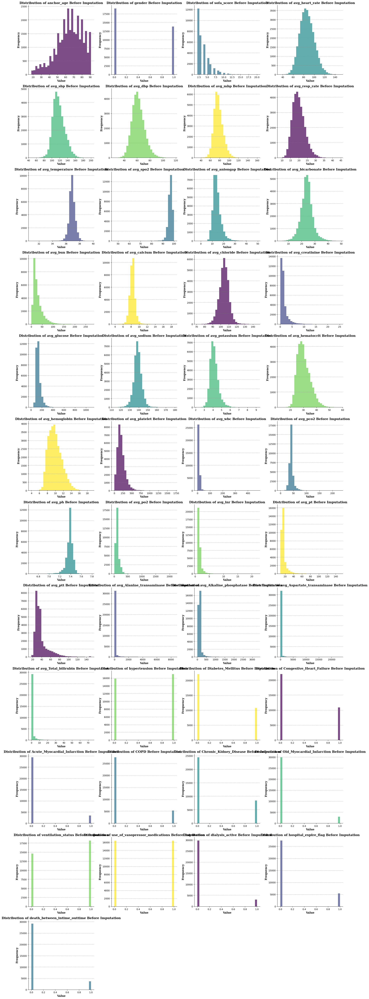

In [206]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color palette from RGB values
custom_colors = [
    rgb_to_hex([68, 1, 84]),   # Color 1
    rgb_to_hex([64, 71, 136]), # Color 2
    rgb_to_hex([45, 112, 142]),# Color 3
    rgb_to_hex([35, 138, 141]),# Color 4
    rgb_to_hex([60, 183, 117]),# Color 5
    rgb_to_hex([115, 208, 85]),# Color 6
    rgb_to_hex([253, 231, 37]) # Color 7
]

# Importing Matplotlib colors for color validation

# Function to plot histograms with a custom color palette
def plot_histograms(data, columns, colors, title_suffix='', columns_per_row=4):
    # Ensure the color list contains valid color values
    colors = [rgb_to_hex(c) if isinstance(c, list) else c for c in colors]
    assert all([mcolors.is_color_like(c) for c in colors]), "One or more colors are invalid."

    num_columns = len(columns)
    num_rows = math.ceil(num_columns / columns_per_row)
    
    # Create a grid of subplots
    fig, axes = plt.subplots(nrows=num_rows, ncols=columns_per_row, figsize=(20, 5 * num_rows))
    axes = axes.flatten()
    
    # Plot each column with a different color from the custom palette
    for idx, col in enumerate(columns):
        if col in data.columns:
            color_idx = idx % len(colors)  # Ensure colors loop if necessary
            color = colors[color_idx]  # Get the correct color for the current plot
            axes[idx].hist(data[col].dropna(), bins=30, color=color, alpha=0.7)  # Use the valid color
            axes[idx].set_title(f'Distribution of {col} {title_suffix}', fontsize=14, fontweight='bold', family='serif')
            axes[idx].set_xlabel('Value', fontsize=12, fontweight='bold', family='serif')
            axes[idx].set_ylabel('Frequency', fontsize=12, fontweight='bold', family='serif')
            axes[idx].yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Add gridlines
            axes[idx].spines['top'].set_visible(False)  # Hide top spine
            axes[idx].spines['right'].set_visible(False)  # Hide right spine
        else:
            axes[idx].set_visible(False)  # Hide unused subplots
    
    # Hide any extra subplots that are not needed
    for i in range(num_columns, len(axes)):
        axes[i].axis('off')  # Hide unused plots
    
    # Adjust layout for a clean appearance
    plt.tight_layout()
    plt.show()


# List of columns with minimal missing values
minimal_missing_cols = [
    'anchor_age', 'gender', 'sofa_score', 'avg_heart_rate', 'avg_sbp', 'avg_dbp', 'avg_mbp', 'avg_resp_rate', 'avg_temperature', 'avg_spo2',
    'avg_aniongap', 'avg_bicarbonate', 'avg_bun', 'avg_calcium', 'avg_chloride', 'avg_creatinine', 'avg_glucose', 'avg_sodium', 'avg_potassium',
    'avg_hematocrit', 'avg_hemoglobin', 'avg_platelet', 'avg_wbc', 'avg_pco2', 'avg_ph', 'avg_po2', 'avg_inr', 'avg_pt', 'avg_ptt',
    'avg_Alanine_transaminase', 'avg_Alkaline_phosphatase', 'avg_Aspartate_transaminase', 'avg_Total_bilirubin', 'hypertension', 'Diabetes_Mellitus',
    'Congestive_Heart_Failure', 'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease', 'Old_Myocardial_Infarction', 'ventilation_status',
    'use_of_vasopressor_medications', 'dialysis_active', 'hospital_expire_flag', 'death_between_intime_outtime'
]

# Plot histograms with custom color palette
plot_histograms(data, minimal_missing_cols, custom_colors, 'Before Imputation')

fills missing values in the data with the mean of each column


In [8]:
data = data.fillna(data.mean())
data.isnull().sum()

anchor_age                        0
gender                            0
sofa_score                        0
avg_heart_rate                    0
avg_sbp                           0
avg_dbp                           0
avg_mbp                           0
avg_resp_rate                     0
avg_temperature                   0
avg_spo2                          0
avg_aniongap                      0
avg_bicarbonate                   0
avg_bun                           0
avg_calcium                       0
avg_chloride                      0
avg_creatinine                    0
avg_glucose                       0
avg_sodium                        0
avg_potassium                     0
avg_hematocrit                    0
avg_hemoglobin                    0
avg_platelet                      0
avg_wbc                           0
avg_pco2                          0
avg_ph                            0
avg_po2                           0
avg_inr                           0
avg_pt                      

#Display basic summary statistics after the imputation


In [204]:
summary_stats = data.describe().T
summary_stats

,count,mean,std,min,25%,50%,75%,max
anchor_age,32848.0,64.718065,15.963707,18.00,55.0000,66.000000,77.000000,91.00
gender,32848.0,0.421152,0.493751,0.00,0.0000,0.000000,1.000000,1.00
sofa_score,32848.0,3.657392,2.010841,2.00,2.0000,3.000000,4.000000,20.00
avg_heart_rate,32848.0,86.457628,13.843081,35.44,76.7500,85.630000,95.470000,149.31
avg_sbp,32848.0,117.537331,15.241652,47.60,106.9000,115.740000,126.780000,200.00
avg_dbp,32848.0,61.848483,9.833107,24.92,55.1675,61.040000,67.730000,117.15
avg_mbp,32848.0,77.155277,9.910529,32.32,70.4600,76.000000,82.910000,159.47
avg_resp_rate,32848.0,19.862424,3.670892,8.98,17.2200,19.480000,22.100000,44.43
avg_temperature,32848.0,36.882505,0.478657,30.89,36.6400,36.870000,37.140000,39.67
avg_spo2,32848.0,96.584662,2.231366,46.60,95.6700,96.850000,97.920000,100.00


This code plots histograms to visualize the distribution of various data columns after  imputation with the mean


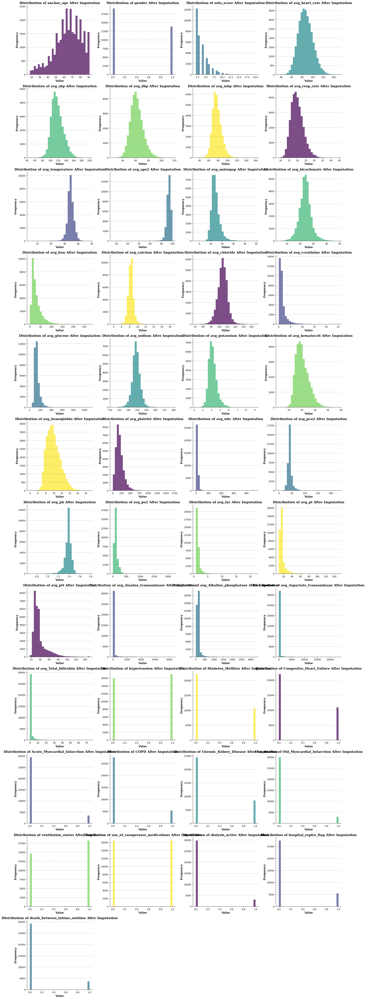

In [216]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)
# Custom color palette from RGB values
custom_colors = [
    rgb_to_hex([68, 1, 84]),   # Color 1
    rgb_to_hex([64, 71, 136]), # Color 2
    rgb_to_hex([45, 112, 142]),# Color 3
    rgb_to_hex([35, 138, 141]),# Color 4
    rgb_to_hex([60, 183, 117]),# Color 5
    rgb_to_hex([115, 208, 85]),# Color 6
    rgb_to_hex([253, 231, 37]) # Color 7
]

# Validate colors
assert all([isinstance(color, str) for color in custom_colors]), "Invalid color in the color list"

# Function to plot histograms with custom color palette
def plot_histograms(data, columns, colors, title_suffix='', columns_per_row=4):
    # Ensure 'data' is a DataFrame
    if not isinstance(data, pd.DataFrame):
        raise TypeError("Expected 'data' to be a DataFrame.")

    # Ensure the color list contains valid color values
    colors = [rgb_to_hex(c) if isinstance(c, list) else c for c in colors]
    assert all([mcolors.is_color_like(c) for c in colors]), "One or more colors are invalid."

    num_columns = len(columns)
    num_rows = math.ceil(num_columns / columns_per_row)

    # Create grid of subplots
    fig, axes = plt.subplots(nrows=num_rows, ncols=columns_per_row, figsize=(20, 5 * num_rows))
    axes = axes.flatten()

    # Plot each column with a different color from the custom palette
    for idx, col in enumerate(columns):
        if col in data.columns:
            color_idx = idx % len(colors)  # Ensure colors loop if necessary
            color = colors[color_idx]  # Get the correct color for the current plot
            axes[idx].hist(data[col].dropna(), bins=30, color=color, alpha=0.7)  # Use the valid color
            axes[idx].set_title(f'Distribution of {col} {title_suffix}', fontsize=14, fontweight='bold', family='serif')
            axes[idx].set_xlabel('Value', fontsize=12, fontweight='bold', family='serif')
            axes[idx].set_ylabel('Frequency', fontsize=12, fontweight='bold', family='serif')
            axes[idx].yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Add gridlines
            axes[idx].spines['top'].set_visible(False)  # Hide top spine
            axes[idx].spines['right'].set_visible(False)  # Hide right spine
        else:
            axes[idx].set_visible(False)  # Hide unused subplots

    # Hide any extra subplots that are not needed
    for i in range(num_columns, len(axes)):
        axes[i].axis("off")  # Hide unused plots

    # Adjust layout for a clean appearance
    plt.tight_layout()
    plt.show()


plot_histograms(data, minimal_missing_cols, custom_colors, 'After Imputation')

This code creates a histogram with a Kernel Density Estimate (KDE) overlay for the 'anchor_age' column in the data,


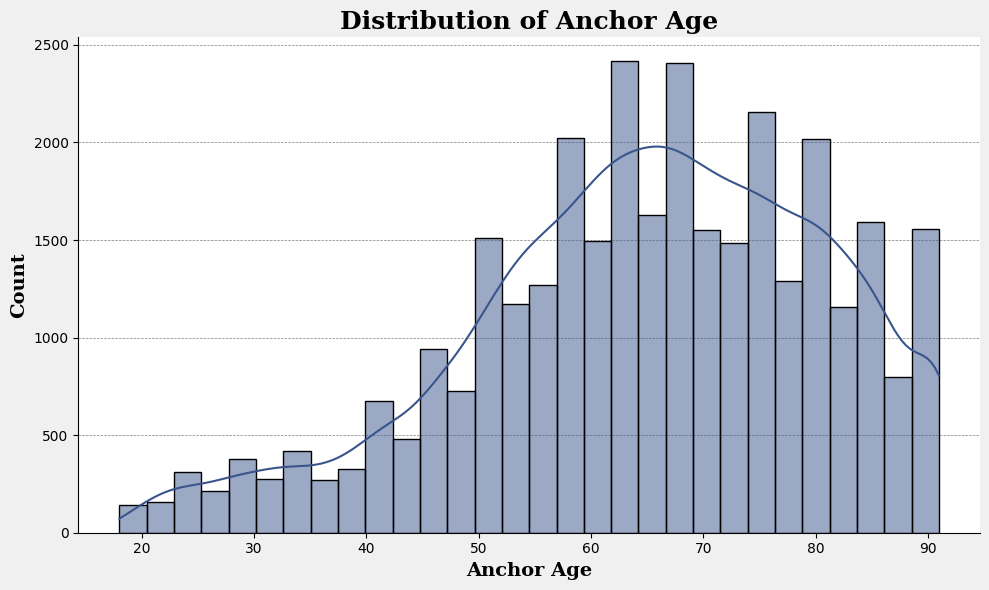

In [217]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color from RGB
custom_color = rgb_to_hex([57, 85, 140]) 

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background color for the entire plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background for the figure

# Create a histogram with KDE and custom color
sns.histplot(data['anchor_age'], bins=30, kde=True, color=custom_color, ax=ax)

# Set a custom plot title with font properties
ax.set_title('Distribution of Anchor Age', fontsize=18, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Light gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the plot

# Customize x-axis and y-axis labels
ax.set_xlabel('Anchor Age', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis

# Hide unnecessary spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

This code creates a countplot to visualize the distribution of genders ('Male' and 'Female') in the data


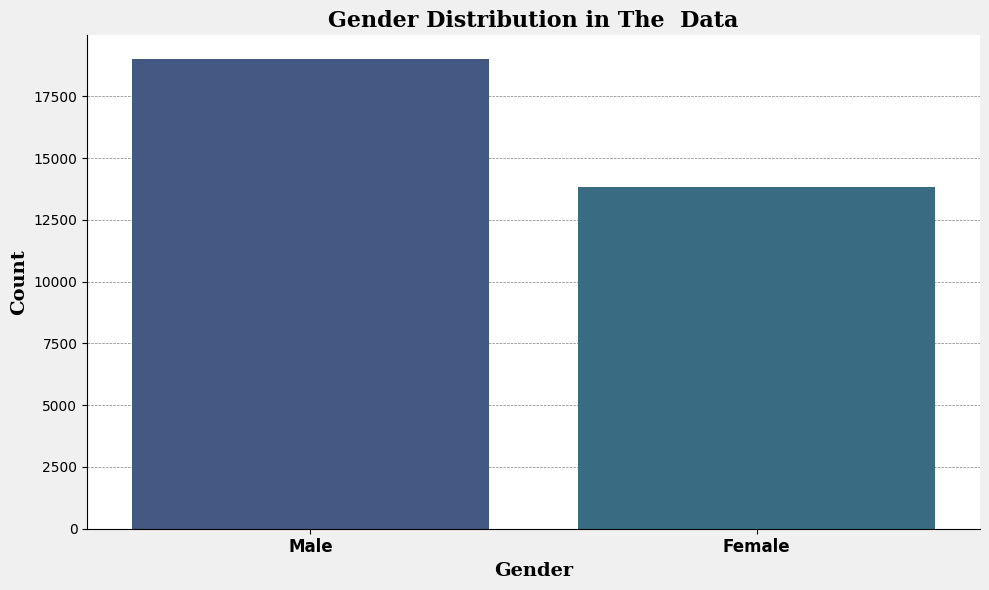

In [222]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Convert RGB values to hexadecimal
color1 = rgb_to_hex([57, 85, 140])  # Color for 'Male'
color2 = rgb_to_hex([45, 112, 142])    # Color for 'Female'

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background for the plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background

# Create a countplot with a customized palette
sns.countplot(x='gender', data=data, palette=[color1, color2], ax=ax)

# Set plot title with customized font and alignment
ax.set_title('Gender Distribution in The  Data', fontsize=16, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the bars

# Customize x-axis and y-axis labels
ax.set_xlabel('Gender', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis label
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis label

# Customize the x-axis ticks and labels to replace '0' and '1' with 'Male' and 'Female'
ax.set_xticklabels(['Male', 'Female'], fontsize=12, fontweight='bold')  # Set custom labels for the x-axis

# Hide the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

This code generates two pie charts to visualize the distribution of two categorical variables ('hospital_expire_flag' and 'death_between_intime_outtime') in the dataset. Each pie chart represents the proportion of two categories ('Survived' and 'Death').

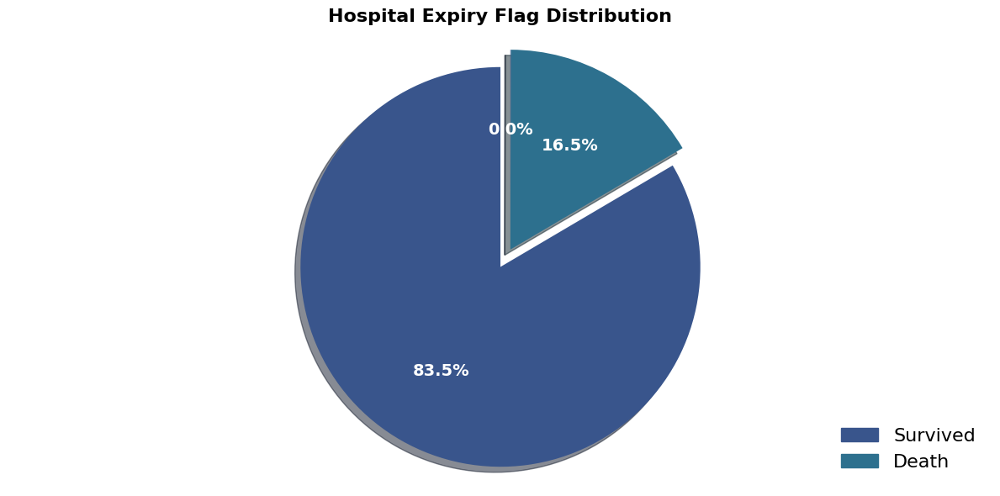

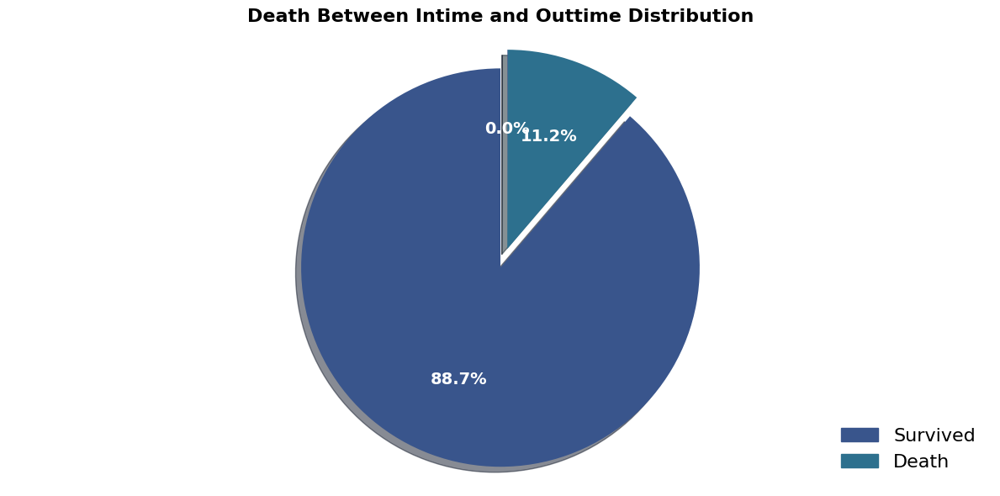

In [230]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([57, 85, 140])  # Color for 'Survived'
color2 = rgb_to_hex([45, 112, 142])   # Color for 'Death'

# Text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Values to remove
values_to_remove = {0.16489005, 0.11223122}

# Filter the DataFrame by removing specific values
data_filtered = data[~data['hospital_expire_flag'].isin(values_to_remove)]
data_filtered = data_filtered[~data_filtered['death_between_intime_outtime'].isin(values_to_remove)]

# Ensure the length of 'explode' matches the number of pie chart segments
hospital_expire_counts = data_filtered['hospital_expire_flag'].value_counts()
explode = [0.1 if i == 0 else 0 for i in range(len(hospital_expire_counts))]

# Pie chart for 'hospital_expire_flag'
plt.figure(figsize=(12, 6))
hospital_expire_counts.plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=explode
)
plt.title('Hospital Expiry Flag Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Custom legend indicating what each color represents
legend_handles = [
    mpatches.Patch(color=color1, label='Survived'),  # Color for 'Survived'
    mpatches.Patch(color=color2, label='Death')      # Color for 'Death'
]

plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

# Create pie chart for 'death_between_intime_outtime'
death_between_counts = data_filtered['death_between_intime_outtime'].value_counts()

# Adjust the 'explode' list to match the number of segments
explode = [0.1 if i == 0 else 0 for i in range(len(death_between_counts))]

plt.figure(figsize=(12, 6))
death_between_counts.plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=explode
)
plt.title('Death Between Intime and Outtime Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add the same custom legend
plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()


This code generates pie charts to visualize the distribution of binary outcomes across several clinical variables. Each pie chart represents the proportion of outcomes labeled as '0' and '1'

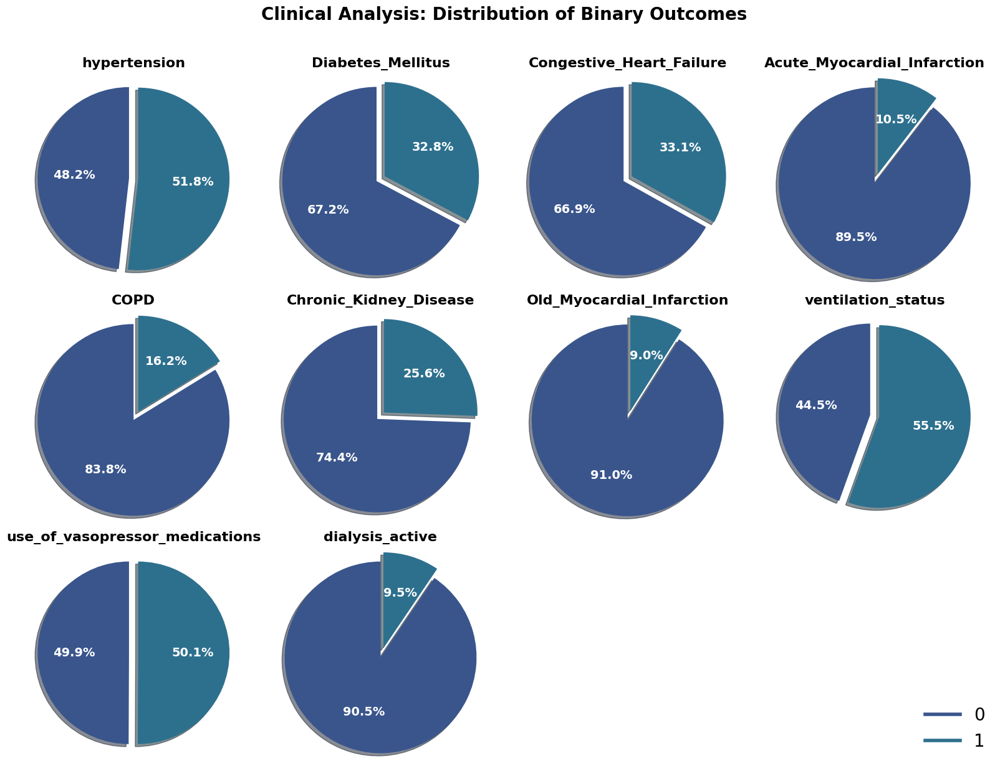

In [228]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom colors
color1 = rgb_to_hex([57, 85, 140])  #0
color2 = rgb_to_hex([45, 112, 142])   #1

# Custom text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Binary columns to plot
binary_columns = ['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
                   'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
                   'Old_Myocardial_Infarction', 'ventilation_status',
                   'use_of_vasopressor_medications', 'dialysis_active']

# DataFrame with binary values
binary_data = data[binary_columns]

# Get normalized counts of 0 and 1 in each column
binary_counts = binary_data.apply(lambda x: x.value_counts(normalize=True))

# Create a subplot grid with 3 rows and 4 columns
num_columns = len(binary_columns)
num_rows = (num_columns + 3) // 4  # Ceiling division to determine rows
fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(16, 12))
fig.suptitle('Clinical Analysis: Distribution of Binary Outcomes', y=1.02, fontsize=20, fontweight='bold')  # Title with font customization


# Plot pie charts with custom styling
for i, column in enumerate(binary_columns):
    ax = axes[i // 4, i % 4]
    if column in binary_counts.columns:
        explode = [0.1, 0]  # Explode the first slice to add emphasis
        
        binary_counts[column].plot.pie(
            autopct='%1.1f%%', startangle=90, ax=ax, colors=[color1, color2], textprops=textprops, labels=None, explode=explode, shadow=True
        )
        ax.set_title(column, fontsize=16, fontweight='bold')  # Title with bold font
        ax.axis('equal')  # Ensures the pie chart remains circular
        ax.xaxis.set_visible(False)  # Hide x-axis
        ax.yaxis.set_visible(False)  # Hide y-axis
        
        # Set subplot background color

# Hide unused plots if there are extra subplot spaces
if num_columns < axes.size:
    for extra_ax in axes.flatten()[num_columns:]:
        extra_ax.axis("off")  # Hide unused plots

# Add a custom legend indicating which color represents '0' and which represents '1'
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='0'),  # Line indicating color for '0'
    plt.Line2D([0], [0], color=color2, lw=4, label='1')   # Line indicating color for '1'
]

# Place the legend in the lower-right corner
fig.legend(handles=legend_handles, loc='lower right', fontsize=20, frameon=False)  # Custom legend

# Adjust layout and display
plt.tight_layout()
plt.show()

This code calculates the correlation matrix for the  data and visualizes it using a heatmap.

<AxesSubplot: >

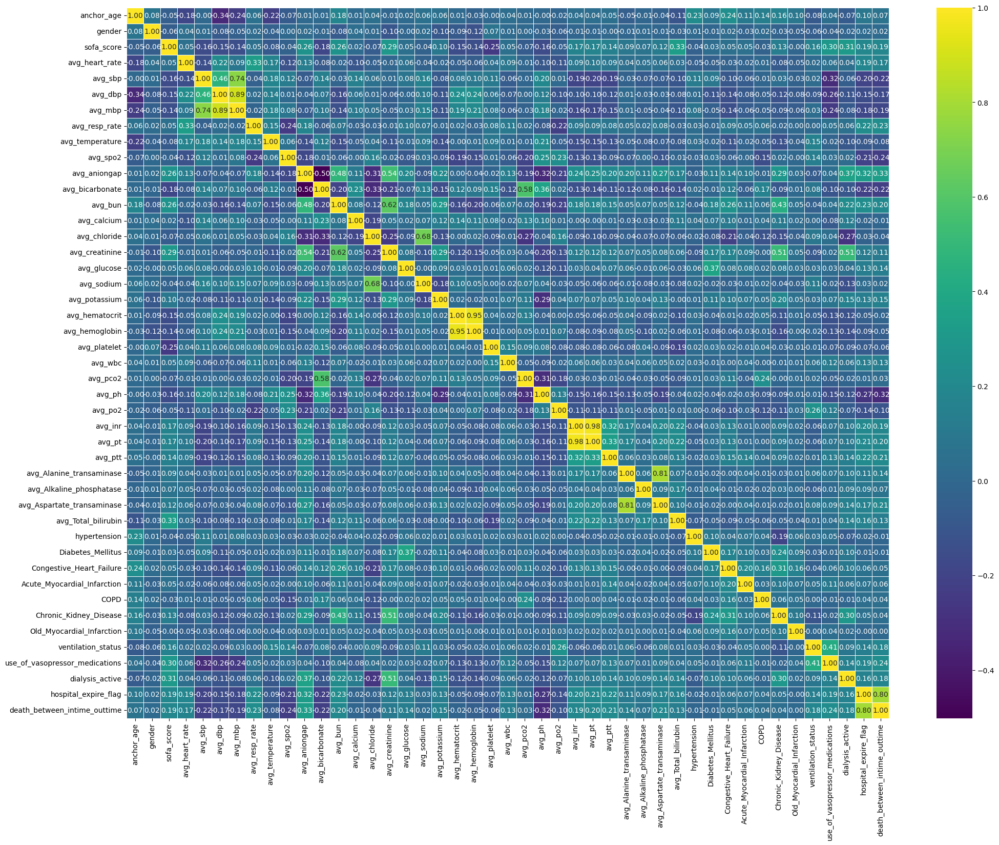

In [17]:
# Calculate correlation matrix
correlation_matrix = data.corr()

plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5, annot_kws={"size": 10})

This code calculates the correlation matrix for the DataFrame data and identifies features with correlation coefficients greater than 0.70. These highly correlated features are then dropped from the dataset to reduce multicollinearity issues.

In [9]:
# Calculate the correlation matrix
corr_matrix = data.corr()

# Select the upper triangle of the correlation matrix
# Changed from 'np.bool' to 'bool' to avoid the deprecation warning
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

# Find features with correlation greater than 0.75
to_drop = [column for column in upper.columns if any(upper[column] > 0.70)]

# Drop highly correlated features
data_reduced = data.drop(to_drop, axis=1)

data_reduced  

,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,Diabetes_Mellitus,Congestive_Heart_Failure,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag
0,72,1,5,112.96,101.67,64.07,19.66,36.670000,97.41,13.000000,...,0,1,0,0,1,0,1.0,1.0,0.0,0.0
1,82,0,2,78.32,110.69,42.34,21.11,36.810000,97.26,14.580000,...,0,1,0,0,0,0,1.0,1.0,0.0,0.0
2,69,1,6,78.14,106.04,50.40,19.57,36.660000,97.81,18.050000,...,0,0,0,0,1,0,1.0,1.0,1.0,0.0
3,51,0,2,87.18,115.46,72.85,17.40,37.130000,97.97,14.220000,...,0,0,0,0,0,0,1.0,0.0,0.0,0.0
4,78,0,3,83.28,101.55,53.08,19.41,36.340000,95.26,20.320000,...,0,1,1,0,0,0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32843,65,1,2,101.00,100.57,70.43,17.17,37.260000,98.00,14.194059,...,1,0,0,0,0,0,0.0,0.0,0.0,1.0
32844,59,0,3,96.67,96.78,69.56,23.78,37.360000,99.89,14.194059,...,1,1,0,0,0,1,0.0,0.0,0.0,0.0
32845,84,1,7,75.03,109.83,54.17,22.88,37.030000,91.29,14.194059,...,0,1,0,1,0,1,0.0,0.0,0.0,1.0
32846,71,0,3,132.80,121.00,88.00,28.00,36.882505,79.40,14.194059,...,0,0,0,1,0,0,0.0,0.0,0.0,1.0


In [19]:
# Filter the correlation matrix to find highly correlated features
threshold = 0.7 # Define the threshold for correlation coefficient
highly_correlated = (correlation_matrix.abs() > threshold) & (correlation_matrix.abs() < 1.0)

# Get the indices of highly correlated features excluding self-correlations
correlated_features = [(i, j) for i in range(correlation_matrix.shape[0]) for j in range(i+1, correlation_matrix.shape[1])
                       if highly_correlated.iloc[i, j] and i != j]

# Print the highly correlated features and their correlation coefficients
for i, j in correlated_features:
    print(f"Features '{correlation_matrix.columns[i]}' and '{correlation_matrix.columns[j]}' are highly correlated with a correlation coefficient of {correlation_matrix.iloc[i, j]:.2f}")


Features 'avg_sbp' and 'avg_mbp' are highly correlated with a correlation coefficient of 0.74
Features 'avg_dbp' and 'avg_mbp' are highly correlated with a correlation coefficient of 0.89
Features 'avg_hematocrit' and 'avg_hemoglobin' are highly correlated with a correlation coefficient of 0.95
Features 'avg_inr' and 'avg_pt' are highly correlated with a correlation coefficient of 0.98
Features 'avg_Alanine_transaminase' and 'avg_Aspartate_transaminase' are highly correlated with a correlation coefficient of 0.81
Features 'hospital_expire_flag' and 'death_between_intime_outtime' are highly correlated with a correlation coefficient of 0.80


In [20]:
to_drop

['avg_mbp',
 'avg_hemoglobin',
 'avg_pt',
 'avg_Aspartate_transaminase',
 'death_between_intime_outtime']

In [12]:
# Drop non-clusterable columns
columns_to_drop = ['hospital_expire_flag']
# Drop the specified columns from the DataFrame
data_reduced.drop(columns=columns_to_drop, inplace=True)

In [13]:
data_reduced.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32848 entries, 0 to 32847
Data columns (total 39 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   anchor_age                      32848 non-null  int64  
 1   gender                          32848 non-null  int64  
 2   sofa_score                      32848 non-null  int64  
 3   avg_heart_rate                  32848 non-null  float64
 4   avg_sbp                         32848 non-null  float64
 5   avg_dbp                         32848 non-null  float64
 6   avg_resp_rate                   32848 non-null  float64
 7   avg_temperature                 32848 non-null  float64
 8   avg_spo2                        32848 non-null  float64
 9   avg_aniongap                    32848 non-null  float64
 10  avg_bicarbonate                 32848 non-null  float64
 11  avg_bun                         32848 non-null  float64
 12  avg_calcium                     

This code performs a train-test split on the reduced dataset data_reduced, creating training and testing sets with a ratio of 80% for training and 20% for testing
It then prints the shapes of the resulting sets to verify the split

In [14]:
# Perform train-test split
X_train, X_test = train_test_split(data_reduced, test_size=0.2, random_state=42)

# Check the shapes of the resulting sets
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)

X_train shape: (26278, 39)
X_test shape: (6570, 39)


# GMM (C=7 , TOC=full identified using random search range(2,10)

This code uses an Isolation Forest model to detect outliers in the training set `X_train`. Outliers are identified with the value -1 in the `outliers` array, while inliers are marked with the value 1. The code then counts the number of outliers detected and removes them from the training set `X_train`.

In [19]:
iso_forest = IsolationForest(n_estimators=100, contamination='auto', random_state=42)
outliers = iso_forest.fit_predict(X_train)

# The variable 'outliers' is an array with the value -1 for outliers and 1 for inliers

# Count the number of outliers
n_outliers = (outliers == -1).sum()
print(f"Number of outliers detected: {n_outliers}")

# Remove the outliers from the dataset
X_train = X_train[outliers != -1]

Number of outliers detected: 2541


In [20]:
outliers

array([ 1,  1,  1, ...,  1, -1,  1])

In [129]:
X_train

,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,hypertension,Diabetes_Mellitus,Congestive_Heart_Failure,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active
1114,72,0,2,86.12,133.11,59.34,22.41,36.87,96.86,18.90,...,1,0,0,0,0,0,0,1.0,1.0,1.0
9658,62,0,4,90.90,110.64,57.67,21.46,36.78,96.41,15.63,...,0,1,1,0,0,1,0,0.0,1.0,0.0
11326,83,0,4,77.86,107.88,51.53,26.71,37.06,98.86,12.15,...,1,0,1,0,0,0,0,1.0,1.0,0.0
20023,85,0,2,68.23,130.23,66.27,19.73,36.67,97.48,14.00,...,1,0,1,0,0,0,0,0.0,0.0,0.0
11067,56,0,2,78.00,98.93,59.71,17.45,36.76,95.65,11.20,...,0,1,0,0,0,0,0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16850,52,0,6,88.79,137.02,87.34,19.25,37.42,97.20,16.25,...,0,1,0,0,0,1,0,0.0,0.0,0.0
6265,56,0,2,80.38,137.60,72.89,24.22,36.91,96.05,15.00,...,1,1,0,0,0,0,0,0.0,0.0,0.0
11284,78,1,2,59.20,138.82,58.15,19.88,36.50,97.36,9.29,...,0,0,0,0,1,0,0,1.0,0.0,0.0
860,72,1,4,70.52,115.37,48.09,24.43,35.63,97.93,25.90,...,1,1,1,0,0,0,0,1.0,1.0,1.0


Step 0: Standardize the Data
StandardScaler: This is a preprocessing class from scikit-learn used to standardize features by removing the mean and scaling to unit variance. This is crucial because many machine learning algorithms perform better when numerical input variables are scaled to a standard scale.

- scales the training and test data separately to avoid data leakage, ensuring that the scaling parameters are computed only on the training data



Step 1: Gaussian Mixture Model (GMM) Clustering
Hyperparameter Space: This dictionary defines the space over which the hyperparameters for the GMM will be searched. n_components represents the number of clusters to be formed, ranging from 2 to 9. covariance_type specifies the type of covariance parameters to use, where:
full (each component has its own general covariance matrix),
tied (all components share the same general covariance matrix),
diag (each component has its own diagonal covariance matrix),
spherical (each component has its own single variance).

 step 2 : Perform random search for GMM
`RandomizedSearchCV` is used with Gaussian Mixture Models (GMM) to efficiently tune hyperparameters through random sampling. This approach tests a predefined number of parameter combinations (20 in this case) and uses the GMM's `score` function to evaluate them. This function measures the average log-likelihood, which indicates how well the model fits the data. The goal of `RandomizedSearchCV` is to maximize this score, effectively searching for the model parameters that best capture the underlying patterns in the data, leading to the most accurate clustering outcome.

In [21]:
# Step 0: Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_train)

# Step 1: Gaussian Mixture Model (GMM) clustering
# Define the hyperparameter space for GMM
param_dist_gmm = {
    'n_components': np.arange(2, 10),
    'covariance_type': ['full', 'tied', 'diag', 'spherical']
}

# Create GMM model
gmm = GaussianMixture()

# step 2 : Perform random search for GMM
random_search_gmm = RandomizedSearchCV(gmm, param_distributions=param_dist_gmm, n_iter=20, random_state=42)
random_search_gmm.fit(X_scaled)

# Get the best hyperparameters for GMM
best_params_gmm = random_search_gmm.best_params_

# Apply the best GMM model to the data
best_gmm = random_search_gmm.best_estimator_
best_gmm_labels_train = best_gmm.fit_predict(X_scaled)

C:\Users\nabee\anaconda3\envs\TensorFlow\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "C:\Users\nabee\anaconda3\envs\TensorFlow\lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


The best_params_gmm variable contains the best hyperparameters found through the random search for the Gaussian Mixture Model (GMM).

In [22]:
best_params_gmm

{'n_components': 7, 'covariance_type': 'full'}

This code calculates and prints the number of clusters and the number of data points in each cluster for the Gaussian Mixture Model (GMM) clustering results

In [23]:
# Count clusters and data points for GMM
gmm_cluster_count = len(set(best_gmm_labels_train))
gmm_cluster_points = {i: np.sum(best_gmm_labels_train == i) for i in range(gmm_cluster_count)}

print("GMM Clustering:")
print("Number of clusters:", gmm_cluster_count)
print("Number of data points in each cluster:")
for cluster, points in gmm_cluster_points.items():
    print(f"Cluster {cluster}: {points} data points")

GMM Clustering:
Number of clusters: 7
Number of data points in each cluster:
Cluster 0: 1352 data points
Cluster 1: 378 data points
Cluster 2: 12347 data points
Cluster 3: 1456 data points
Cluster 4: 1803 data points
Cluster 5: 6146 data points
Cluster 6: 255 data points


This code calculates the Silhouette Score for the Gaussian Mixture Model (GMM) clustering results, providing a measure of how well-defined the clusters are. The Silhouette Score ranges from -1 to 1, where a higher score indicates better clustering results.

In [24]:
# Evaluate GMM
silhouette_score_gmm = silhouette_score(X_scaled, best_gmm_labels_train)
print("Silhouette Score for GMM:", silhouette_score_gmm)

Silhouette Score for GMM: 0.07475589565913597


This code applies t-distributed Stochastic Neighbor Embedding (t-SNE) for dimensionality reduction to visualize the clusters obtained from the Gaussian Mixture Model (GMM) clustering in a two-dimensional space. The clusters are visualized using a scatter plot with t-SNE-transformed data, where each point represents a data instance, colored by its assigned cluster label.

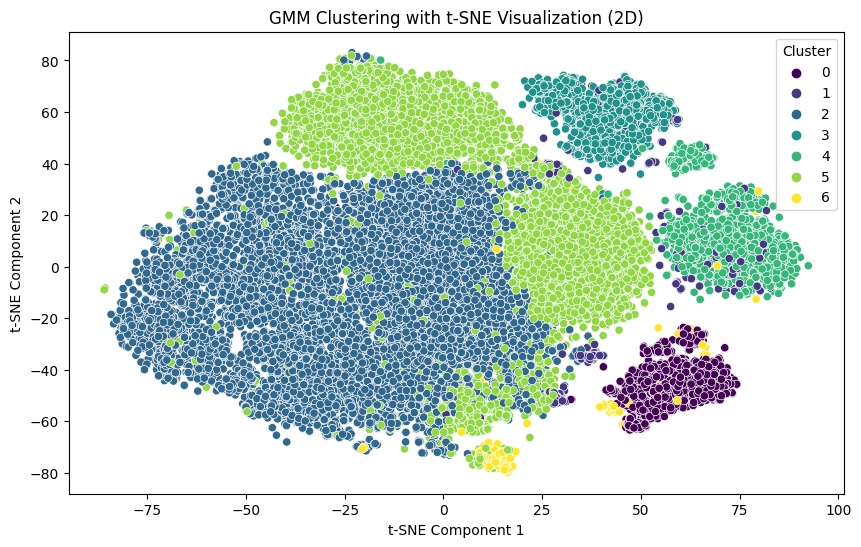

In [25]:
# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
X_tsne_2d = tsne.fit_transform(X_scaled)

# Visualize clusters using t-SNE with sns.scatterplot
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_tsne_2d[:, 0], y=X_tsne_2d[:, 1], hue=best_gmm_labels_train, palette='viridis', legend='full')
plt.title('GMM Clustering with t-SNE Visualization (2D)')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend(title='Cluster')
plt.show()

This code saves the trained Gaussian Mixture Model (GMM) to a file named "best_gmm_model.joblib" using the joblib library

In [27]:
# Save the trained GMM to a file using joblib
import joblib

model_filename = "best_gmm_model.joblib"
joblib.dump(best_gmm, model_filename)

print(f"Model saved to {model_filename}")

# Optional: Load the model back to check it's working
loaded_gmm = joblib.load(model_filename)

Model saved to best_gmm_model.joblib


In [28]:
from joblib import dump, load

# Then you can use dump to save your model and scaler
dump(scaler, 'scaler.pkl')
dump(best_gmm, 'best_gmm_model.pkl')

['best_gmm_model.pkl']

This code scales the test data using the same scaler that was used for the training data. Then, it applies the best Gaussian Mixture Model (GMM) to the scaled test data to obtain cluster labels. The Silhouette Score is calculated for the test data to evaluate the clustering results. Additionally, the clustering results are visualized using t-distributed Stochastic Neighbor Embedding (t-SNE) for a two-dimensional visualization of the clusters in the test data.

Silhouette Score for Test Data (GMM): 0.058772268361297994


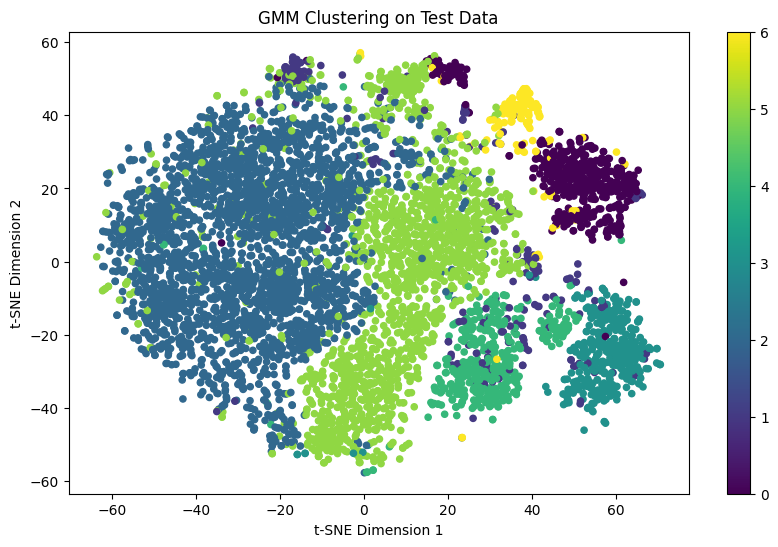

In [29]:
# Scale the test data with the same scaler used for the training data
X_test_scaled = scaler.transform(X_test)

# Apply the best GMM model to the test data
best_gmm_labels_test = best_gmm.predict(X_test_scaled)

# Calculate silhouette score for the test data
sil_score_gmm_test = silhouette_score(X_test_scaled, best_gmm_labels_test)

# Evaluate the clustering results
print("Silhouette Score for Test Data (GMM):", sil_score_gmm_test)

# Plot the clustering results with t-SNE for visualization
# This helps to understand the clustering visually
tsne = TSNE(n_components=2, random_state=42)
X_test_tsne = tsne.fit_transform(X_test_scaled)

plt.figure(figsize=(10, 6))
plt.scatter(X_test_tsne[:, 0], X_test_tsne[:, 1], c=best_gmm_labels_test, cmap='viridis', s=20)
plt.title('GMM Clustering on Test Data')
plt.xlabel('t-SNE Dimension 1')
plt.ylabel('t-SNE Dimension 2')
plt.colorbar()
plt.show()

This code assigns the columns 'hospital_expire_flag' and 'death_between_intime_outtime' from the original dataset `data` to the training set `X_train`. This allows these columns to be included in the training data for analysis purposes.

In [30]:
X_train[['hospital_expire_flag', 'death_between_intime_outtime']] =data[['hospital_expire_flag', 'death_between_intime_outtime']]

This code creates a new column named 'cluster' in the DataFrame `X_train` to store the cluster labels obtained from the Gaussian Mixture Model (GMM). Then, it iterates over each unique cluster label and filters the data points belonging to that cluster. Finally, it exports the data points of each cluster to a separate CSV file, named based on the cluster label.
-  for  analysis and exploration of individual clusters.

In [137]:
# Create a new column in your dataframe to store cluster labels
X_train['cluster'] = best_gmm_labels_train

# Iterate over each cluster
for cluster_label in X_train['cluster'].unique():
    # Filter data points belonging to the current cluster
    cluster_data = X_train[X_train['cluster'] == cluster_label]

    # Export the cluster data to a CSV file
    cluster_data.to_csv(f'cluster_{cluster_label}_data.csv', index=False)

# Reads the CSV files
Each DataFrame contains the data points belonging to a specific cluster

In [51]:
cluster_data0 = pd.read_csv('cluster_0_data.csv')
cluster_data1 = pd.read_csv('cluster_1_data.csv')
cluster_data2 = pd.read_csv('cluster_2_data.csv')
cluster_data3 = pd.read_csv('cluster_3_data.csv')
cluster_data4 = pd.read_csv('cluster_4_data.csv')
cluster_data5 = pd.read_csv('cluster_5_data.csv')
cluster_data6 = pd.read_csv('cluster_6_data.csv')

In [52]:
# Load the datasets
cluster_data = []
for i in range(7):
    df = pd.read_csv(f'cluster_{i}_data.csv')
    print(f"Cluster {i} - Number of rows: {len(df)}, Number of columns: {len(df.columns)}")
    cluster_data.append(df)

Cluster 0 - Number of rows: 1352, Number of columns: 42
Cluster 1 - Number of rows: 378, Number of columns: 42
Cluster 2 - Number of rows: 12347, Number of columns: 42
Cluster 3 - Number of rows: 1456, Number of columns: 42
Cluster 4 - Number of rows: 1803, Number of columns: 42
Cluster 5 - Number of rows: 6146, Number of columns: 42
Cluster 6 - Number of rows: 255, Number of columns: 42


This code iterates over each cluster's DataFrame in the cluster_data list, displaying the descriptive statistics for each cluster's data

In [17]:
for i, data in enumerate(cluster_data):
    print(f"Cluster {i} Descriptive Statistics:")
    display(data.describe())

Cluster 0 Descriptive Statistics:


,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag,death_between_intime_outtime,cluster
count,1352.000000,1352.000000,1352.000000,1352.000000,1352.000000,1352.000000,1352.000000,1352.000000,1352.000000,1352.000000,...,1352.000000,1352.000000,1352.000000,1352.000000,1352.000000,1352.000000,1352.0,1352.000000,1352.000000,1352.0
mean,62.383136,0.397929,5.369822,87.792655,115.127929,57.997241,20.521191,36.777260,97.204874,16.715784,...,0.091716,0.090237,0.609467,0.052515,0.763314,0.776627,1.0,0.289445,0.224278,0.0
std,14.743841,0.489652,2.797520,12.685813,14.689868,9.253281,3.455813,0.375733,1.453461,2.819875,...,0.288731,0.286627,0.488050,0.223145,0.425205,0.416660,0.0,0.453448,0.417084,0.0
min,19.000000,0.000000,2.000000,50.830000,72.670000,35.410000,10.870000,35.200000,87.600000,8.450000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,0.000000,0.0
25%,53.750000,0.000000,3.000000,78.967500,104.950000,51.635000,18.000000,36.567500,96.330000,14.837500,...,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.0,0.000000,0.000000,0.0
50%,63.000000,0.000000,5.000000,87.450000,113.250000,57.290000,20.200000,36.770000,97.370000,16.520000,...,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.0,0.000000,0.000000,0.0
75%,73.000000,1.000000,7.000000,96.405000,123.900000,63.487500,22.940000,37.000000,98.240000,18.372500,...,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.0,1.000000,0.000000,0.0
max,91.000000,1.000000,20.000000,133.050000,179.790000,99.740000,33.780000,38.270000,99.960000,29.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000,0.0


Cluster 1 Descriptive Statistics:


,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag,death_between_intime_outtime,cluster
count,378.000000,378.000000,378.000000,378.000000,378.000000,378.000000,378.000000,378.000000,378.000000,378.00000,...,378.000000,378.000000,378.000000,378.000000,378.000000,378.000000,378.0,378.000000,378.000000,378.0
mean,69.140212,0.394180,3.931217,88.155317,114.110178,60.196134,20.787196,36.827308,96.494101,15.14955,...,0.402116,0.087302,0.256614,0.227513,0.460317,0.523810,0.0,0.280423,0.166667,1.0
std,15.498573,0.489322,1.955887,13.772974,13.314146,8.939626,3.756478,0.438964,1.770532,3.16169,...,0.490975,0.282651,0.437343,0.419782,0.499083,0.500095,0.0,0.449801,0.373172,0.0
min,21.000000,0.000000,2.000000,53.710000,78.510000,28.590000,11.950000,35.090000,88.980000,1.33000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,1.0
25%,61.000000,0.000000,2.000000,79.735000,105.822500,54.407500,18.065000,36.590000,95.432500,13.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,1.0
50%,71.000000,0.000000,3.500000,86.920000,112.085000,59.510000,20.470000,36.805000,96.565000,14.74500,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.0,0.000000,0.000000,1.0
75%,82.000000,1.000000,5.000000,97.657500,121.915000,65.677500,23.227500,37.047500,97.855000,17.00000,...,1.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.0,1.000000,0.000000,1.0
max,91.000000,1.000000,12.000000,133.000000,168.060000,87.480000,31.320000,38.560000,99.880000,27.25000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.0


Cluster 2 Descriptive Statistics:


,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag,death_between_intime_outtime,cluster
count,12347.000000,12347.000000,12347.000000,12347.000000,12347.000000,12347.000000,12347.000000,12347.000000,12347.000000,12347.000000,...,12347.0,12347.0,12347.0,12347.0,12347.000000,12347.000000,12347.0,12347.000000,12347.000000,12347.0
mean,61.658541,0.436624,3.220134,86.542339,118.394704,63.433761,19.558675,36.967909,96.850771,12.946369,...,0.0,0.0,0.0,0.0,0.569207,0.462784,0.0,0.097432,0.060312,2.0
std,17.140830,0.495987,1.561102,13.812390,14.186157,9.372609,3.637367,0.455705,1.634245,2.572690,...,0.0,0.0,0.0,0.0,0.495207,0.498633,0.0,0.296444,0.237972,0.0
min,18.000000,0.000000,2.000000,36.000000,68.330000,29.890000,9.210000,33.470000,84.000000,4.500000,...,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,2.0
25%,51.000000,0.000000,2.000000,76.775000,108.080000,56.930000,16.940000,36.700000,95.900000,11.170000,...,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,2.0
50%,63.000000,0.000000,3.000000,85.700000,116.750000,62.580000,19.150000,36.940000,96.990000,12.750000,...,0.0,0.0,0.0,0.0,1.000000,0.000000,0.0,0.000000,0.000000,2.0
75%,75.000000,1.000000,4.000000,95.570000,127.390000,69.115000,21.770000,37.240000,98.000000,14.400000,...,0.0,0.0,0.0,0.0,1.000000,1.000000,0.0,0.000000,0.000000,2.0
max,91.000000,1.000000,15.000000,149.310000,180.750000,115.650000,37.570000,39.420000,100.000000,33.000000,...,0.0,0.0,0.0,0.0,1.000000,1.000000,0.0,1.000000,1.000000,2.0


Cluster 3 Descriptive Statistics:


,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag,death_between_intime_outtime,cluster
count,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,...,1456.0,1456.000000,1456.000000,1456.0,1456.000000,1456.000000,1456.0,1456.000000,1456.000000,1456.0
mean,70.365385,0.364698,3.289835,83.424409,117.960989,59.862184,19.549348,36.854044,96.732493,13.220299,...,0.0,0.196429,0.289148,1.0,0.566621,0.528159,0.0,0.083791,0.048764,3.0
std,12.001879,0.481511,1.524077,12.181392,14.221756,8.386412,3.231614,0.384116,1.563667,2.578758,...,0.0,0.397433,0.453523,0.0,0.495712,0.499378,0.0,0.277170,0.215448,0.0
min,25.000000,0.000000,2.000000,51.030000,72.240000,38.700000,11.440000,34.300000,88.110000,6.500000,...,0.0,0.000000,0.000000,1.0,0.000000,0.000000,0.0,0.000000,0.000000,3.0
25%,62.000000,0.000000,2.000000,74.757500,108.250000,54.277500,17.080000,36.640000,95.707500,11.500000,...,0.0,0.000000,0.000000,1.0,0.000000,0.000000,0.0,0.000000,0.000000,3.0
50%,71.000000,0.000000,3.000000,82.710000,116.125000,59.075000,19.125000,36.830000,96.850000,13.000000,...,0.0,0.000000,0.000000,1.0,1.000000,1.000000,0.0,0.000000,0.000000,3.0
75%,80.000000,1.000000,4.000000,91.170000,126.750000,64.640000,21.492500,37.060000,97.860000,14.910000,...,0.0,0.000000,1.000000,1.0,1.000000,1.000000,0.0,0.000000,0.000000,3.0
max,91.000000,1.000000,13.000000,132.740000,171.940000,91.520000,35.070000,38.270000,100.000000,29.000000,...,0.0,1.000000,1.000000,1.0,1.000000,1.000000,0.0,1.000000,1.000000,3.0


Cluster 4 Descriptive Statistics:


,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag,death_between_intime_outtime,cluster
count,1803.000000,1803.000000,1803.000000,1803.000000,1803.000000,1803.000000,1803.000000,1803.000000,1803.000000,1803.000000,...,1803.0,1803.000000,1803.000000,1803.000000,1803.000000,1803.000000,1803.0,1803.000000,1803.000000,1803.0
mean,70.726567,0.381032,3.452579,84.538730,115.917399,59.968175,20.049639,36.894884,96.756828,13.742421,...,1.0,0.160288,0.281753,0.114254,0.623960,0.636162,0.0,0.134312,0.076601,4.0
std,12.679482,0.485775,1.625391,12.126314,12.958273,8.520808,3.155776,0.403767,1.535742,2.690742,...,0.0,0.366975,0.449978,0.318208,0.484525,0.481236,0.0,0.340970,0.265928,0.0
min,19.000000,0.000000,2.000000,48.720000,67.420000,36.240000,11.000000,35.260000,85.760000,6.000000,...,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,4.0
25%,63.000000,0.000000,2.000000,76.280000,107.080000,54.055000,17.770000,36.670000,95.845000,12.000000,...,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,4.0
50%,72.000000,0.000000,3.000000,84.190000,114.430000,59.330000,19.720000,36.880000,96.840000,13.600000,...,1.0,0.000000,0.000000,0.000000,1.000000,1.000000,0.0,0.000000,0.000000,4.0
75%,80.000000,1.000000,4.000000,91.945000,123.075000,65.425000,22.050000,37.130000,97.845000,15.320000,...,1.0,0.000000,1.000000,0.000000,1.000000,1.000000,0.0,0.000000,0.000000,4.0
max,91.000000,1.000000,11.000000,124.780000,172.680000,98.370000,35.490000,38.690000,100.000000,26.670000,...,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,4.0


Cluster 5 Descriptive Statistics:


,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag,death_between_intime_outtime,cluster
count,6146.000000,6146.000000,6146.000000,6146.000000,6146.000000,6146.000000,6146.000000,6146.000000,6146.000000,6146.000000,...,6146.0,6146.000000,6146.000000,6146.0,6146.000000,6146.000000,6146.0,6146.000000,6146.000000,6146.0
mean,68.600716,0.432476,3.585747,85.673295,118.738101,61.406179,19.840970,36.835856,96.362319,14.121223,...,0.0,0.432151,0.531240,0.0,0.479499,0.420111,0.0,0.154002,0.089218,5.0
std,14.109177,0.495460,1.879326,13.656888,15.530156,9.674770,3.421901,0.410242,2.141072,3.089609,...,0.0,0.495415,0.499064,0.0,0.499620,0.493617,0.0,0.360887,0.284997,0.0
min,18.000000,0.000000,2.000000,35.440000,68.820000,29.720000,10.000000,34.460000,54.730000,-1.000000,...,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,5.0
25%,59.000000,0.000000,2.000000,75.992500,107.510000,54.742500,17.390000,36.610000,95.310000,12.000000,...,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,5.0
50%,70.000000,0.000000,3.000000,85.055000,116.855000,60.575000,19.580000,36.820000,96.590000,13.935000,...,0.0,0.000000,1.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,5.0
75%,80.000000,1.000000,4.000000,94.917500,128.442500,67.390000,22.000000,37.060000,97.710000,16.000000,...,0.0,1.000000,1.000000,0.0,1.000000,1.000000,0.0,0.000000,0.000000,5.0
max,91.000000,1.000000,16.000000,134.500000,188.500000,109.370000,34.320000,38.890000,100.000000,33.000000,...,0.0,1.000000,1.000000,0.0,1.000000,1.000000,0.0,1.000000,1.000000,5.0


Cluster 6 Descriptive Statistics:


,anchor_age,gender,sofa_score,avg_heart_rate,avg_sbp,avg_dbp,avg_resp_rate,avg_temperature,avg_spo2,avg_aniongap,...,Acute_Myocardial_Infarction,COPD,Chronic_Kidney_Disease,Old_Myocardial_Infarction,ventilation_status,use_of_vasopressor_medications,dialysis_active,hospital_expire_flag,death_between_intime_outtime,cluster
count,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,...,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.0
mean,56.380392,0.396078,4.615686,89.015255,118.601059,65.479608,20.663490,36.750402,96.863608,16.240824,...,0.141176,0.066667,0.172549,0.023529,0.827451,0.745098,0.329412,0.309804,0.278431,6.0
std,16.851143,0.490043,2.492775,11.962536,14.755760,9.866934,3.689569,0.990061,1.725122,3.835123,...,0.348888,0.249934,0.378600,0.151876,0.378600,0.436663,0.470924,0.463322,0.449108,0.0
min,19.000000,0.000000,2.000000,42.540000,72.410000,39.170000,10.970000,31.690000,90.740000,8.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.0
25%,43.000000,0.000000,3.000000,82.500000,107.640000,58.420000,17.935000,36.645000,96.190000,13.365000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,6.0
50%,58.000000,0.000000,4.000000,88.530000,115.590000,64.520000,20.280000,36.910000,97.070000,15.810000,...,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,6.0
75%,69.000000,1.000000,6.000000,96.405000,128.495000,71.915000,22.955000,37.185000,98.000000,18.500000,...,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,6.0
max,91.000000,1.000000,15.000000,122.360000,159.180000,96.720000,30.930000,38.760000,100.000000,31.100000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,6.0


Normality Tests: Since we need to decide between ANOVA and Kruskal-Wallis tests, we should conduct normality tests (e.g., Shapiro-Wilk test) for each continuous variable. If the p-value is less than 0.05, the data is not normally distributed, suggesting the need for non-parametric tests.

- This code imports the stats module from SciPy and performs normality tests for each numerical column in each cluster's DataFrame

In [259]:
# Importing the stats module from SciPy
# Perform normality tests for each cluster
for i, data in enumerate(cluster_data):
    print(f"Cluster {i} Normality Test Results:")
    for column in data.select_dtypes(include=['float64', 'int64']).columns:
        stat, p_value = stats.shapiro(data[column])
        print(f"{column}: {'Normal' if p_value > 0.05 else 'Not Normal'} (p-value: {p_value:.5f})")


Cluster 0 Normality Test Results:
anchor_age: Not Normal (p-value: 0.00000)
gender: Not Normal (p-value: 0.00000)
sofa_score: Not Normal (p-value: 0.00000)
avg_heart_rate: Normal (p-value: 0.74081)
avg_sbp: Not Normal (p-value: 0.00000)
avg_dbp: Not Normal (p-value: 0.00000)
avg_resp_rate: Not Normal (p-value: 0.00000)
avg_temperature: Not Normal (p-value: 0.00000)
avg_spo2: Not Normal (p-value: 0.00000)
avg_aniongap: Not Normal (p-value: 0.00000)
avg_bicarbonate: Not Normal (p-value: 0.00001)
avg_bun: Not Normal (p-value: 0.00000)
avg_calcium: Not Normal (p-value: 0.00000)
avg_chloride: Not Normal (p-value: 0.00227)
avg_creatinine: Not Normal (p-value: 0.00000)
avg_glucose: Not Normal (p-value: 0.00000)
avg_sodium: Not Normal (p-value: 0.00009)
avg_potassium: Not Normal (p-value: 0.00000)
avg_hematocrit: Not Normal (p-value: 0.00000)
avg_platelet: Not Normal (p-value: 0.00000)
avg_wbc: Not Normal (p-value: 0.00000)
avg_pco2: Not Normal (p-value: 0.00000)
avg_ph: Not Normal (p-value: 0

C:\Users\nabee\anaconda3\envs\TensorFlow\lib\site-packages\scipy\stats\_morestats.py:1813: UserWarning: Input data for shapiro has range zero. The results may not be accurate.
  warnings.warn("Input data for shapiro has range zero. The results "
C:\Users\nabee\anaconda3\envs\TensorFlow\lib\site-packages\scipy\stats\_morestats.py:1816: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


Based on our normality test results, almost all variables across the different clusters do not follow a normal distribution, as indicated by the very low p-values. This is common in real-world data, especially in medical datasets where biological measures often deviate from normality due to various factors including underlying diseases, measurement error, or skewed distributions within the population.

Normal Variables: There are a few variables, such as 'avg_heart_rate' in some clusters and 'dialysis_active' across clusters, that do follow a normal distribution or have a p-value indicating normality due to a large sample size. For these, it's okay to use parametric tests like ANOVA if comparing only those clusters. However, consistency in the type of test across all variables may be preferred for simplicity.

- This code performs statistical tests to identify significant variables across all clusters. It includes functions for performing the Kruskal-Wallis test for continuous variables and the Chi-square test for categorical variables. The Kruskal-Wallis test assesses whether there are statistically significant differences between the medians of different groups, while the Chi-square test assesses the independence between categorical variables.

In [260]:
from scipy.stats import kruskal, chi2_contingency
import numpy as np

# Function to perform Kruskal-Wallis test across all clusters for a given variable
def perform_kruskal_wallis(cluster_data, variable):
    # Extracting the data for the variable from each cluster
    samples = [data[variable].values for data in cluster_data if variable in data.columns]
    stat, p_value = kruskal(*samples)
    return p_value

# Function to perform Chi-square test across all clusters for a given variable
def perform_chi_square(cluster_data, variable):
    # Constructing the contingency table
    contingency_table = np.array([data[variable].value_counts().reindex(range(len(cluster_data)), fill_value=0).values for data in cluster_data])
    stat, p_value, _, _ = chi2_contingency(contingency_table)
    return p_value

# Perform Kruskal-Wallis test for all continuous variables
kw_p_values = {variable: perform_kruskal_wallis(cluster_data, variable) for variable in cluster_data[0].select_dtypes(include=['float64', 'int64']).columns}

# Perform Chi-square test for all categorical variables
chi_p_values = {variable: perform_chi_square(cluster_data, variable) for variable in cluster_data[0].select_dtypes(include=['category', 'object']).columns}

# Function to adjust p-values using Benjamini-Hochberg procedure
def benjamini_hochberg(p_values):
    sorted_p_values = np.sort(list(p_values.values()))
    sorted_p_indices = np.argsort(list(p_values.values()))
    adjusted_p_values = np.empty(len(sorted_p_values))
    n = len(sorted_p_values)
    for i, p_value in enumerate(sorted_p_values):
        adjusted_p_values[sorted_p_indices[i]] = min(p_value * n / (i + 1), 1.0)
    return dict(zip(p_values.keys(), adjusted_p_values))

# Adjusting the p-values for multiple testing
adjusted_kw_p_values = benjamini_hochberg(kw_p_values)
adjusted_chi_p_values = benjamini_hochberg(chi_p_values)

# Interpreting the results
significant_kw_vars = {k: v for k, v in adjusted_kw_p_values.items() if v < 0.05}
significant_chi_vars = {k: v for k, v in adjusted_chi_p_values.items() if v < 0.05}

print('Significant continuous variables after correction:', significant_kw_vars)
print('Significant categorical variables after correction:', significant_chi_vars)


Significant continuous variables after correction: {'anchor_age': 2.12149744224182e-267, 'gender': 3.8909364983909215e-09, 'sofa_score': 3.707454430431685e-261, 'avg_heart_rate': 1.4748687396731814e-29, 'avg_sbp': 4.073607973350808e-27, 'avg_dbp': 1.3655976052180016e-162, 'avg_resp_rate': 9.248778395744019e-43, 'avg_temperature': 2.5962896754629097e-130, 'avg_spo2': 5.511038620491992e-76, 'avg_aniongap': 0.0, 'avg_bicarbonate': 1.7171511561238226e-42, 'avg_bun': 0.0, 'avg_calcium': 3.6835017297562806e-90, 'avg_chloride': 2.1879477207268386e-258, 'avg_creatinine': 0.0, 'avg_glucose': 5.054999827127764e-38, 'avg_sodium': 1.2443083323909653e-52, 'avg_potassium': 1.4980776663697585e-143, 'avg_hematocrit': 3.298078192737166e-116, 'avg_platelet': 3.9779919726500716e-47, 'avg_wbc': 1.1816571131969262e-62, 'avg_pco2': 1.606663693785737e-50, 'avg_ph': 5.942762559971958e-81, 'avg_po2': 5.80939602149141e-141, 'avg_inr': 4.882830842684339e-152, 'avg_ptt': 3.6795275669424865e-192, 'avg_Alanine_tran

all the continuous variables listed have statistically significant differences across the clusters, as their p-values are all well below the typical alpha level of 0.05. This means that these variables can effectively discriminate between the different patient clusters.

Here is a breakdown of what the results imply:

Extremely Low P-values (0 or close to 0): For variables like avg_aniongap, avg_bun, avg_creatinine, Congestive_Heart_Failure, Acute_Myocardial_Infarction, COPD, Chronic_Kidney_Disease, Old_Myocardial_Infarction, dialysis_active, and cluster, the p-values are so low that they are effectively zero. This indicates an extremely strong statistical significance and suggests that these variables may be some of the most important features distinguishing the clusters.

Very Low P-values: Other variables like anchor_age, avg_heart_rate, avg_sbp, and avg_dbp, although not exactly zero, still have very low p-values indicating strong evidence against the null hypothesis of no difference across clusters.

Variables with Higher P-values (but still < 0.05): Some variables like avg_Total_bilirubin have higher p-values compared to others but are still significant. The higher the p-value (yet <0.05), the less strong the evidence is against the null hypothesis.

Implications for Clinical Practice: These significant variables could potentially be used to characterize the patient groups in each cluster and might be associated with different clinical outcomes, risks, or treatment responses. For example, patients in different clusters may have different average scores for sofa_score or avg_heart_rate, which could imply varying severities of sepsis and thus necessitate different treatment approaches.

Considerations for Further Research: The findings need to be interpreted in the context of clinical expertise and should be investigated further in a clinical setting to determine their relevance to patient care.

In [261]:
# Define the binary columns you're interested in
binary_variables = [
   'hospital_expire_flag', 'death_between_intime_outtime', 'gender', 'hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
    'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
    'Old_Myocardial_Infarction', 'ventilation_status',
    'use_of_vasopressor_medications', 'dialysis_active'
]
from scipy.stats import chi2_contingency

# Example of Chi-square test for binary variable across all clusters
def perform_chi_square_for_binary(cluster_data, variable):
    # Constructing the contingency table
    contingency_table = np.array([data[variable].value_counts().reindex([0, 1], fill_value=0).values for data in cluster_data])
    stat, p_value, _, _ = chi2_contingency(contingency_table)
    return p_value

binary_p_values = {variable: perform_chi_square_for_binary(cluster_data, variable) for variable in binary_variables}
binary_p_values

{'hospital_expire_flag': 3.406909747273427e-132,
 'death_between_intime_outtime': 3.2965593815566605e-134,
 'gender': 3.88712153296423e-09,
 'hypertension': 1.3363935309337677e-105,
 'Diabetes_Mellitus': 6.524878363040914e-147,
 'Congestive_Heart_Failure': 0.0,
 'Acute_Myocardial_Infarction': 0.0,
 'COPD': 0.0,
 'Chronic_Kidney_Disease': 0.0,
 'Old_Myocardial_Infarction': 0.0,
 'ventilation_status': 1.902106701500096e-107,
 'use_of_vasopressor_medications': 2.032502739542912e-176,
 'dialysis_active': 0.0}

The p-values you've reported for your binary features are very small, which suggests that there are statistically significant differences in the proportions of these binary outcomes across the clusters. Let's go through them one by one:

hospital_expire_flag (p-value ~ 0): The presence or absence of this flag differs significantly across the clusters, which could be indicative of variations in mortality rates within each cluster.

death_between_intime_outtime (p-value ~ 0): Similar to the hospital expire flag, this variable shows significant differences across clusters, possibly related to the timing of patient deaths relative to their hospital stay.

gender (p-value = 3.89e-09): The distribution of gender is significantly different across clusters, suggesting that there may be gender-related differences in how patients cluster, which could reflect differences in disease presentation or outcomes between men and women.

hypertension (p-value ~ 0): The proportion of patients with hypertension is significantly different across the clusters, which might be related to the severity or type of sepsis or the overall health profile of the patients in each cluster.

Diabetes_Mellitus (p-value ~ 0): The occurrence of diabetes mellitus varies significantly across the clusters, potentially affecting the clusters' response to treatment or overall prognosis.

Congestive_Heart_Failure, Acute_Myocardial_Infarction, COPD, Chronic_Kidney_Disease, Old_Myocardial_Infarction (p-values = 0): These variables show that there are significant differences in the prevalence of these conditions across the clusters, indicating that these comorbidities may play a role in the clustering process, perhaps due to their influence on the clinical characteristics of sepsis.

ventilation_status (p-value ~ 0): Whether or not patients required mechanical ventilation differs significantly across the clusters, suggesting differences in respiratory complications or disease severity.

use_of_vasopressor_medications (p-value ~ 0): The use of vasopressor medications, which are often used in septic shock, varies significantly across clusters, hinting at different levels of hemodynamic instability or shock among the clusters.

dialysis_active (p-value = 0): The need for dialysis, indicative of renal failure, differs across clusters, pointing to variations in kidney function or acute kidney injury as a factor in cluster differentiation.

Each of these binary variables shows strong evidence of being distributed differently across your patient clusters. This information can be vital for understanding the characteristics of each cluster, which can, in turn, inform more personalized treatment strategies and provide insight into prognostic factors for different patient groups.

These results would likely have implications for clinical practice, as they could help to identify patient subgroups that are at higher risk and might benefit from more aggressive monitoring or therapeutic strategies. Additionally, they can guide healthcare providers in understanding the patterns and correlations between various health conditions and sepsis outcomes.

-  statistical results demonstrate highly significant differences across the clusters for both continuous and categorical variables, which suggests that your clustering has effectively separated patients into distinct groups based on their clinical profiles.

In [263]:
from scipy.stats import chi2_contingency

data_combined = pd.concat(cluster_data, ignore_index=True)

# Assuming 'data_combined' contains the combined cluster data
for feature in binary_columns:
    # Create a contingency table
    contingency_table = pd.crosstab(data_combined['cluster'], data_combined[feature])
    # Perform the chi-squared test
    chi2, p, dof, expected = chi2_contingency(contingency_table)
    print(f"Chi-squared test for {feature}:")
    print(f"Chi2 Statistic: {chi2}, P-value: {p}\n")

Chi-squared test for hypertension:
Chi2 Statistic: 503.7079055082766, P-value: 1.3363935309337677e-105

Chi-squared test for Diabetes_Mellitus:
Chi2 Statistic: 695.2384157388482, P-value: 6.524878363040914e-147

Chi-squared test for Congestive_Heart_Failure:
Chi2 Statistic: 2157.859191945472, P-value: 0.0

Chi-squared test for Acute_Myocardial_Infarction:
Chi2 Statistic: 20848.675629904053, P-value: 0.0

Chi-squared test for COPD:
Chi2 Statistic: 6330.559598173561, P-value: 0.0

Chi-squared test for Chronic_Kidney_Disease:
Chi2 Statistic: 8305.466616769858, P-value: 0.0

Chi-squared test for Old_Myocardial_Infarction:
Chi2 Statistic: 19199.67230012543, P-value: 0.0

Chi-squared test for ventilation_status:
Chi2 Statistic: 512.2795005123336, P-value: 1.902106701500096e-107

Chi-squared test for use_of_vasopressor_medications:
Chi2 Statistic: 831.8366956343673, P-value: 2.032502739542912e-176

Chi-squared test for dialysis_active:
Chi2 Statistic: 22745.921401546155, P-value: 0.0



- First, it concatenates SOFA scores from each cluster's DataFrame into a single DataFrame called all_sofa_scores. It also creates an array cluster_labels to indicate the cluster number for each SOFA score.

- Then, it runs Tukey's HSD test using pairwise_tukeyhsd() from the statsmodels library. This test compares the means of SOFA scores between clusters while accounting for multiple comparisons. The significance level is set to 0.05.

- The results of the Tukey HSD test provide insights into whether there are statistically significant differences in mean SOFA scores between any pair of clusters.

In [264]:
# Combine the SOFA scores into a single data frame
all_sofa_scores = pd.concat([data['sofa_score'] for data in cluster_data], ignore_index=True)

# Create an array that indicates the cluster number for each SOFA score
cluster_labels = []
for i, data in enumerate(cluster_data):
    cluster_labels.extend([i] * len(data['sofa_score']))  # Corrected reference to cluster data

# Run Tukey's HSD test
tukey_results = pairwise_tukeyhsd(endog=all_sofa_scores, groups=cluster_labels, alpha=0.05)

print(tukey_results)

Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
     0      1  -1.4386    0.0 -1.7406 -1.1366   True
     0      2  -2.1497    0.0 -2.2984  -2.001   True
     0      3    -2.08    0.0  -2.276  -1.884   True
     0      4  -1.9172    0.0  -2.104 -1.7305   True
     0      5  -1.7841    0.0   -1.94 -1.6282   True
     0      6  -0.7541    0.0 -1.1085 -0.3998   True
     1      2  -0.7111    0.0 -0.9821 -0.4401   True
     1      3  -0.6414    0.0  -0.941 -0.3418   True
     1      4  -0.4786    0.0 -0.7722  -0.185   True
     1      5  -0.3455  0.004 -0.6205 -0.0704   True
     1      6   0.6845    0.0  0.2639  1.1051   True
     2      3   0.0697 0.7862 -0.0741  0.2135  False
     2      4   0.2324    0.0  0.1016  0.3633   True
     2      5   0.3656    0.0  0.2846  0.4466   True
     2      6   1.3956    0.0  1.0672  1.7239   True
     3      4   0.1627 0.1187 -0.0201  0.3456 

- This code concatenates the 'hospital_expire_flag' and 'death_between_intime_outtime' data from all clusters into separate series. Then, it creates an array of cluster labels corresponding to the concatenated data.

- Afterward, Tukey's Honestly Significant Difference (HSD) test is performed separately for 'hospital_expire_flag' and 'death_between_intime_outtime'. This test compares the means of these variables between clusters while considering multiple comparisons. The significance level is set to 0.05.

- The results of the Tukey HSD test provide insights into whether there are statistically significant differences in the means of 'hospital_expire_flag' and 'death_between_intime_outtime' between any pair of clusters.

In [239]:
# Concatenate the 'hospital_expire_flag' data from all clusters into one series
all_hospital_expire_flags = pd.concat([cluster_data[i]['hospital_expire_flag'] for i in range(7)], ignore_index=True)

# Concatenate the 'death_between_intime_outtime' data from all clusters into one series
all_death_flags = pd.concat([cluster_data[i]['death_between_intime_outtime'] for i in range(7)], ignore_index=True)

# Create an array of cluster labels corresponding to the concatenated data
cluster_labels = []
for i in range(7):
    cluster_labels.extend([i] * len(cluster_data[i]))

# Run Tukey's HSD test for 'hospital_expire_flag'
tukey_results_expire = pairwise_tukeyhsd(
    endog=all_hospital_expire_flags,
    groups=cluster_labels,
    alpha=0.05
)

# Run Tukey's HSD test for 'death_between_intime_outtime'
tukey_results_death = pairwise_tukeyhsd(
    endog=all_death_flags,
    groups=cluster_labels,
    alpha=0.05
)

print("Tukey HSD test for 'hospital_expire_flag':")
print(tukey_results_expire)
print("\nTukey HSD test for 'death_between_intime_outtime':")
print(tukey_results_death)

Tukey HSD test for 'hospital_expire_flag':
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
     0      1   -0.009 0.9992  -0.066  0.0479  False
     0      2   -0.192    0.0 -0.2201  -0.164   True
     0      3  -0.2057    0.0 -0.2426 -0.1687   True
     0      4  -0.1551    0.0 -0.1903 -0.1199   True
     0      5  -0.1354    0.0 -0.1648  -0.106   True
     0      6   0.0204 0.9729 -0.0465  0.0872  False
     1      2   -0.183    0.0 -0.2341 -0.1319   True
     1      3  -0.1966    0.0 -0.2531 -0.1401   True
     1      4  -0.1461    0.0 -0.2015 -0.0907   True
     1      5  -0.1264    0.0 -0.1783 -0.0746   True
     1      6   0.0294 0.9306 -0.0499  0.1087  False
     2      3  -0.0136 0.7552 -0.0408  0.0135  False
     2      4   0.0369 0.0002  0.0122  0.0616   True
     2      5   0.0566    0.0  0.0413  0.0719   True
     2      6   0.2124    0.0  0.1504  0.2743   True
   

# Analysis each cluster 

# cluster_data0


This code snippet creates a histogram with a kernel density estimate (KDE) for the distribution of 'anchor_age' in cluster 0

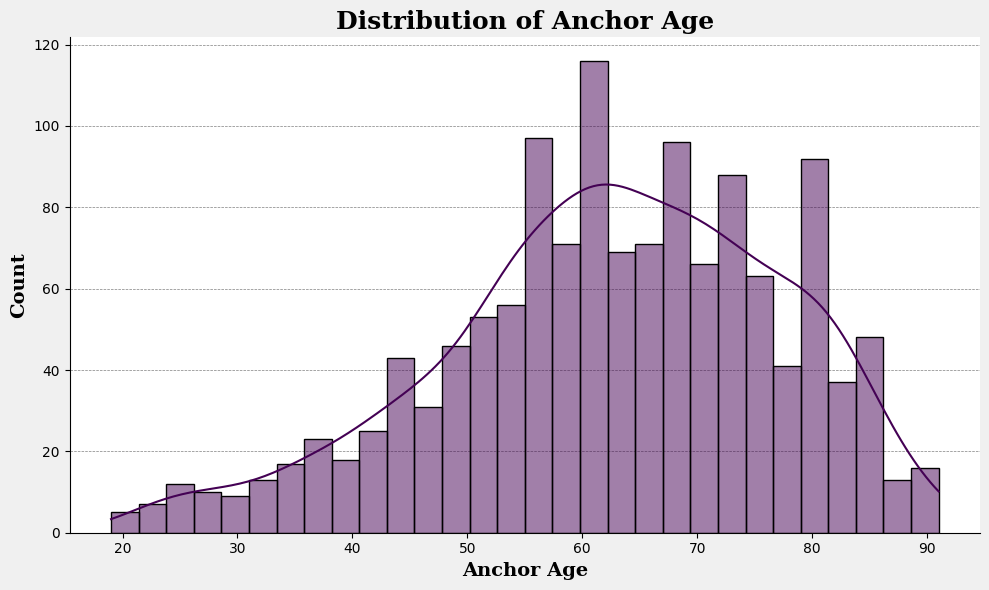

In [28]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color from RGB
custom_color = rgb_to_hex([68, 1, 84])  # #440154

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background color for the entire plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background for the figure

# Create a histogram with KDE and custom color
sns.histplot(cluster_data0['anchor_age'], bins=30, kde=True, color=custom_color, ax=ax)

# Set a custom plot title with font properties
ax.set_title('Distribution of Anchor Age', fontsize=18, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Light gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the plot

# Customize x-axis and y-axis labels
ax.set_xlabel('Anchor Age', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis

# Hide unnecessary spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

This code snippet creates a countplot showing the gender distribution in cluster data 0

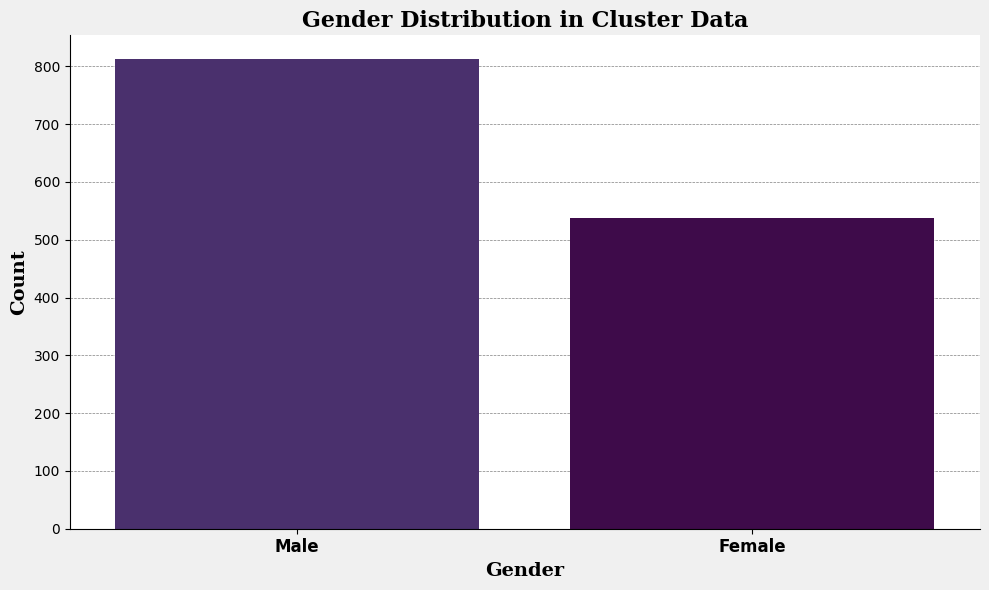

In [117]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Convert RGB values to hexadecimal
color1 = rgb_to_hex([72, 38, 119])  # Color for 'Male'
color2 = rgb_to_hex([68, 1, 84])    # Color for 'Female'

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background for the plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background

# Create a countplot with a customized palette
sns.countplot(x='gender', data=cluster_data0, palette=[color1, color2], ax=ax)

# Set plot title with customized font and alignment
ax.set_title('Gender Distribution in Cluster Data', fontsize=16, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the bars

# Customize x-axis and y-axis labels
ax.set_xlabel('Gender', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis label
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis label

# Customize the x-axis ticks and labels to replace '0' and '1' with 'Male' and 'Female'
ax.set_xticklabels(['Male', 'Female'], fontsize=12, fontweight='bold')  # Set custom labels for the x-axis

# Hide the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

This code snippet generates two pie charts to visualize the distribution of 'hospital_expire_flag' and 'death_between_intime_outtime' in cluster data 0.

<Figure size 1200x600 with 0 Axes>

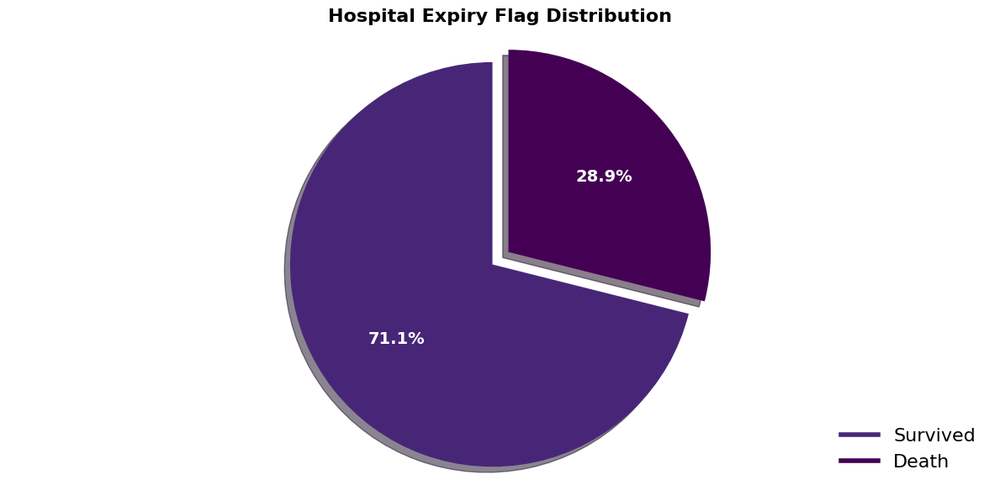

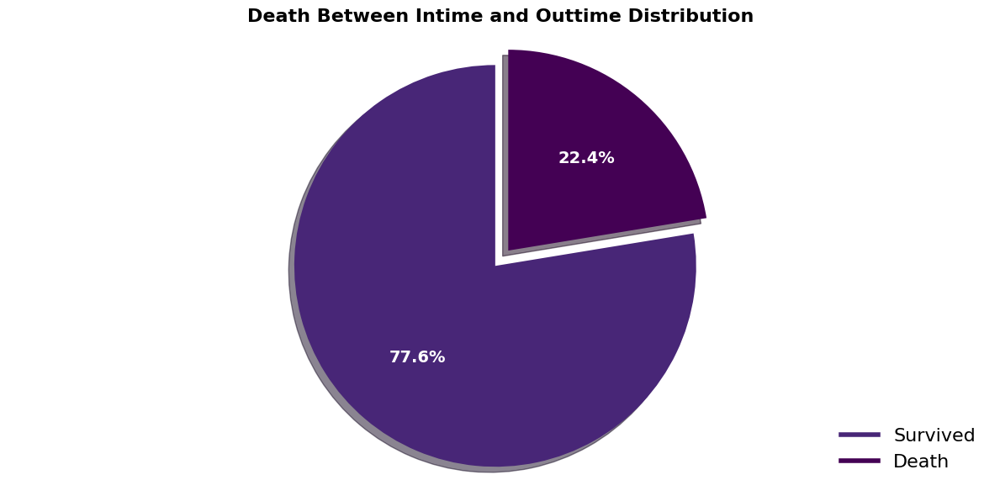

In [40]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([72, 38, 119])  # #482878 for 'Survived'
color2 = rgb_to_hex([68, 1, 84])    # #440154 for 'Death'

# Text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Set the background color for the plot
plt.figure(figsize=(12, 6)).patch.set_facecolor('#e0e0e0')  # Light gray background

# Pie chart for 'hospital_expire_flag' without explicit labels
plt.figure(figsize=(12, 6))
cluster_data0['hospital_expire_flag'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Hospital Expiry Flag Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add a custom legend indicating what each color represents
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='Survived'),  # Color for 'Survived'
    plt.Line2D([0], [0], color=color2, lw=4, label='Death')      # Color for 'Death'
]

plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

# Pie chart for 'death_between_intime_outtime' with similar changes
plt.figure(figsize=(12, 6))
cluster_data0['death_between_intime_outtime'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Death Between Intime and Outtime Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add the same custom legend
plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

This code generates pie charts to visualize the distribution of binary outcomes in cluster data 0. The binary outcomes include 'hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure', 'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease', 'Old_Myocardial_Infarction', 'ventilation_status', 'use_of_vasopressor_medications', and 'dialysis_active'

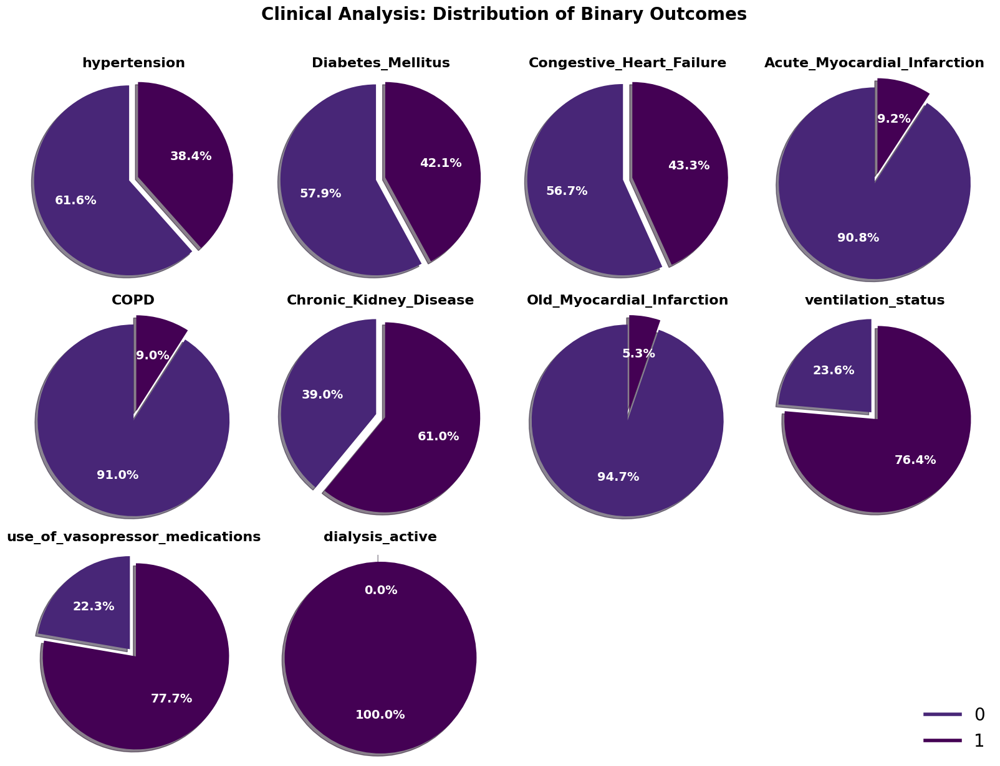

In [119]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom colors
color1 = rgb_to_hex([72, 38, 119])  #  for '0'
color2 = rgb_to_hex([68, 1, 84])    #  for '1'

# Custom text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Binary columns to plot
binary_columns = ['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
                   'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
                   'Old_Myocardial_Infarction', 'ventilation_status',
                   'use_of_vasopressor_medications', 'dialysis_active']

# DataFrame with binary values
binary_data = cluster_data0[binary_columns]

# Get normalized counts of 0 and 1 in each column
binary_counts = binary_data.apply(lambda x: x.value_counts(normalize=True))

# Create a subplot grid with 3 rows and 4 columns
num_columns = len(binary_columns)
num_rows = (num_columns + 3) // 4  # Ceiling division to determine rows
fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(16, 12))
fig.suptitle('Clinical Analysis: Distribution of Binary Outcomes', y=1.02, fontsize=20, fontweight='bold')  # Title with font customization


# Plot pie charts with custom styling
for i, column in enumerate(binary_columns):
    ax = axes[i // 4, i % 4]
    if column in binary_counts.columns:
        explode = [0.1, 0]  # Explode the first slice to add emphasis
        
        binary_counts[column].plot.pie(
            autopct='%1.1f%%', startangle=90, ax=ax, colors=[color1, color2], textprops=textprops, labels=None, explode=explode, shadow=True
        )
        ax.set_title(column, fontsize=16, fontweight='bold')  # Title with bold font
        ax.axis('equal')  # Ensures the pie chart remains circular
        ax.xaxis.set_visible(False)  # Hide x-axis
        ax.yaxis.set_visible(False)  # Hide y-axis
        
        # Set subplot background color

# Hide unused plots if there are extra subplot spaces
if num_columns < axes.size:
    for extra_ax in axes.flatten()[num_columns:]:
        extra_ax.axis("off")  # Hide unused plots

# Add a custom legend indicating which color represents '0' and which represents '1'
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='0'),  # Line indicating color for '0'
    plt.Line2D([0], [0], color=color2, lw=4, label='1')   # Line indicating color for '1'
]

# Place the legend in the lower-right corner
fig.legend(handles=legend_handles, loc='lower right', fontsize=20, frameon=False)  # Custom legend

# Adjust layout and display
plt.tight_layout()
plt.show()

<AxesSubplot: >

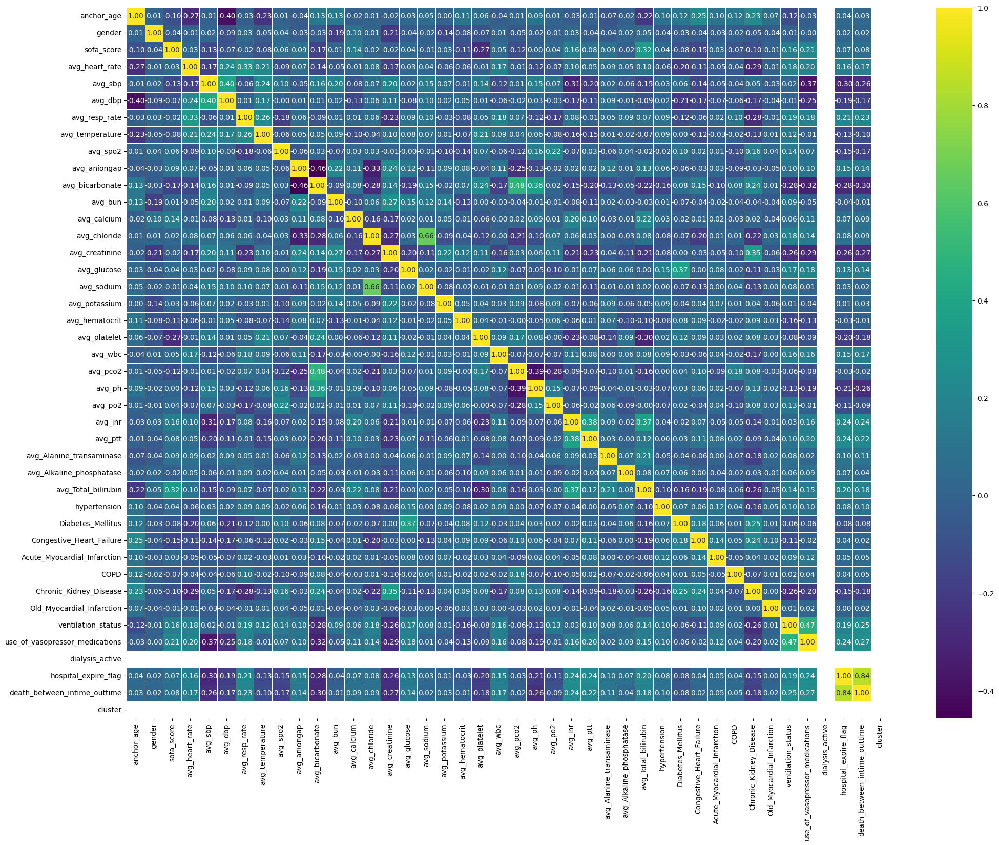

In [41]:
# Calculate correlation matrix
correlation_matrix = cluster_data0.corr()

plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5, annot_kws={"size": 10})

# cluster_data1

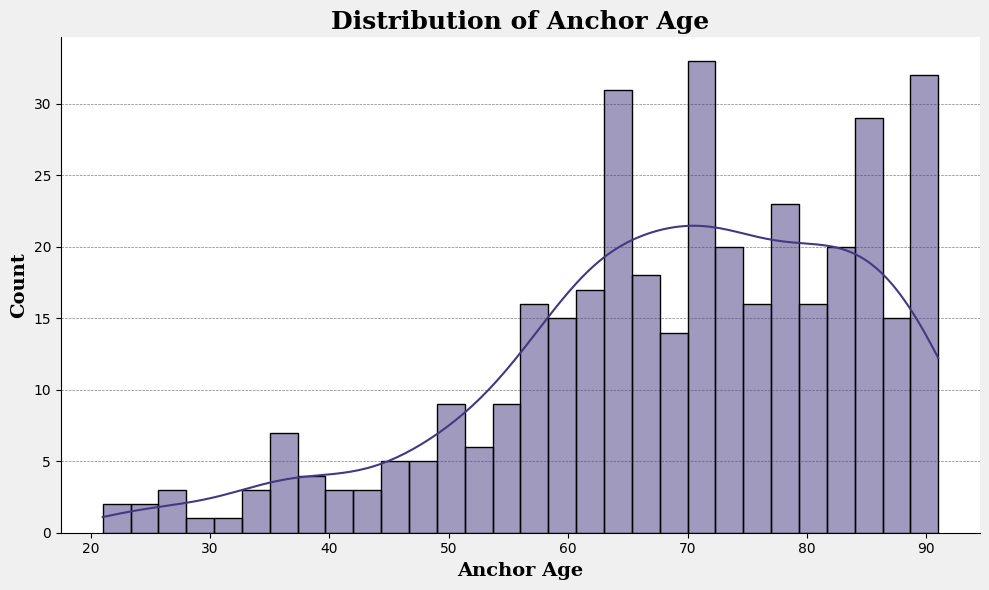

In [120]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color from RGB
custom_color = rgb_to_hex([69, 55, 129])  # #440154

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background color for the entire plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background for the figure

# Create a histogram with KDE and custom color
sns.histplot(cluster_data1['anchor_age'], bins=30, kde=True, color=custom_color, ax=ax)

# Set a custom plot title with font properties
ax.set_title('Distribution of Anchor Age', fontsize=18, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Light gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the plot

# Customize x-axis and y-axis labels
ax.set_xlabel('Anchor Age', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis

# Hide unnecessary spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

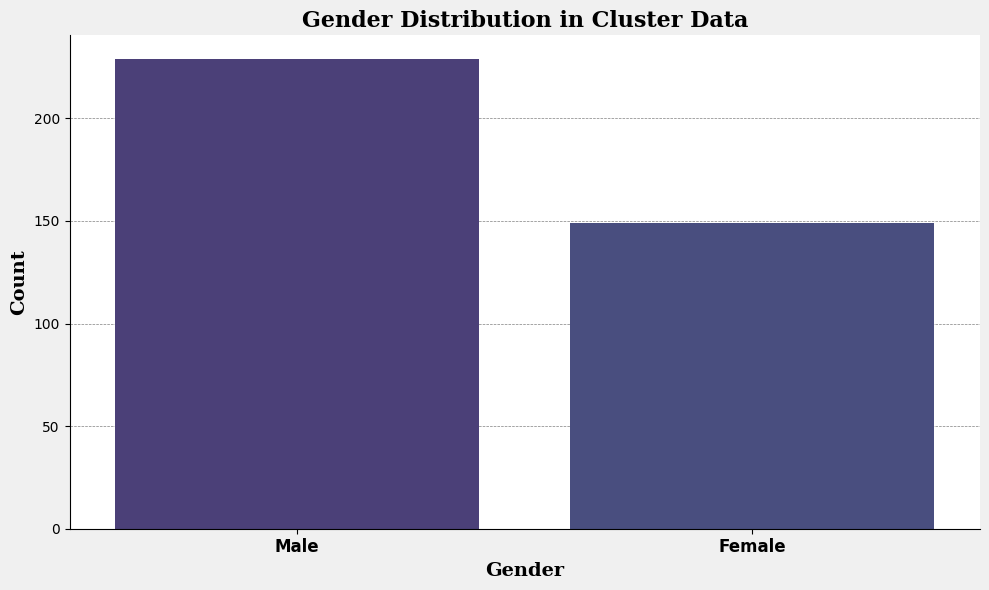

In [121]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Convert RGB values to hexadecimal
color1 = rgb_to_hex([69, 55, 129])  # Color for 'Male'
color2 = rgb_to_hex([64, 71, 136])    # Color for 'Female'

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background for the plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background

# Create a countplot with a customized palette
sns.countplot(x='gender', data=cluster_data1, palette=[color1, color2], ax=ax)

# Set plot title with customized font and alignment
ax.set_title('Gender Distribution in Cluster Data', fontsize=16, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the bars

# Customize x-axis and y-axis labels
ax.set_xlabel('Gender', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis label
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis label

# Customize the x-axis ticks and labels to replace '0' and '1' with 'Male' and 'Female'
ax.set_xticklabels(['Male', 'Female'], fontsize=12, fontweight='bold')  # Set custom labels for the x-axis

# Hide the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

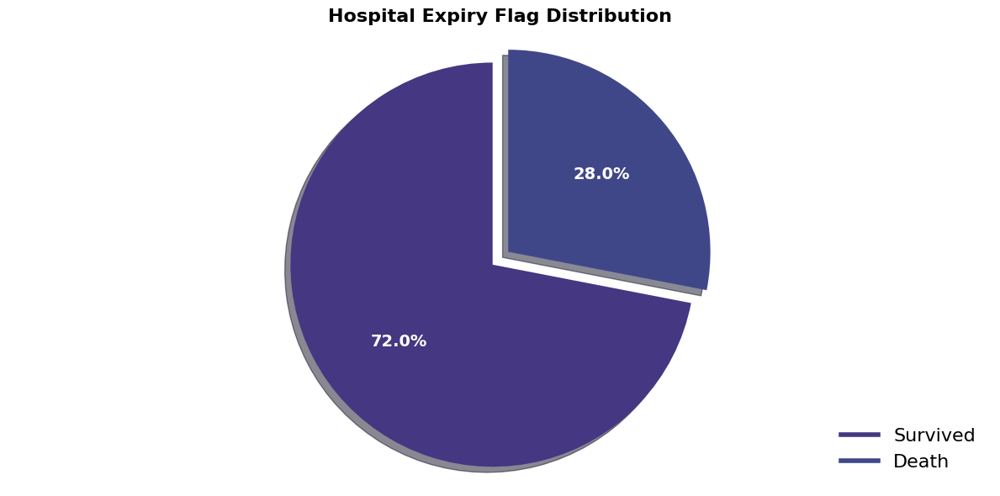

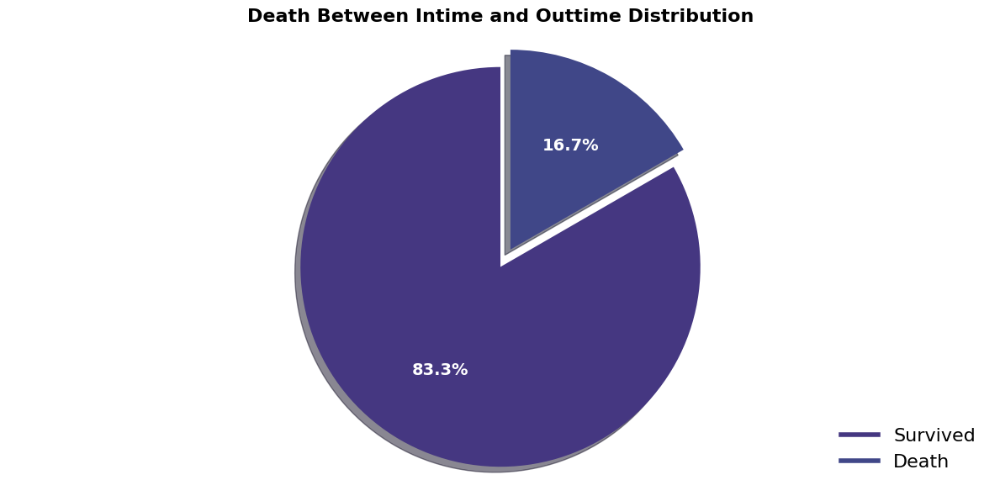

In [122]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([69, 55, 129])  # #482878 for 'Survived'
color2 = rgb_to_hex([64, 71, 136])  # #440154 for 'Death'

# Text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Set the background color for the plot
plt.figure(figsize=(12, 6)).patch.set_facecolor('#e0e0e0')  # Light gray background

# Pie chart for 'hospital_expire_flag' without explicit labels
plt.figure(figsize=(12, 6))
cluster_data1['hospital_expire_flag'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Hospital Expiry Flag Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add a custom legend indicating what each color represents
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='Survived'),  # Color for 'Survived'
    plt.Line2D([0], [0], color=color2, lw=4, label='Death')      # Color for 'Death'
]

plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

# Pie chart for 'death_between_intime_outtime' with similar changes
plt.figure(figsize=(12, 6))
cluster_data1['death_between_intime_outtime'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Death Between Intime and Outtime Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add the same custom legend
plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

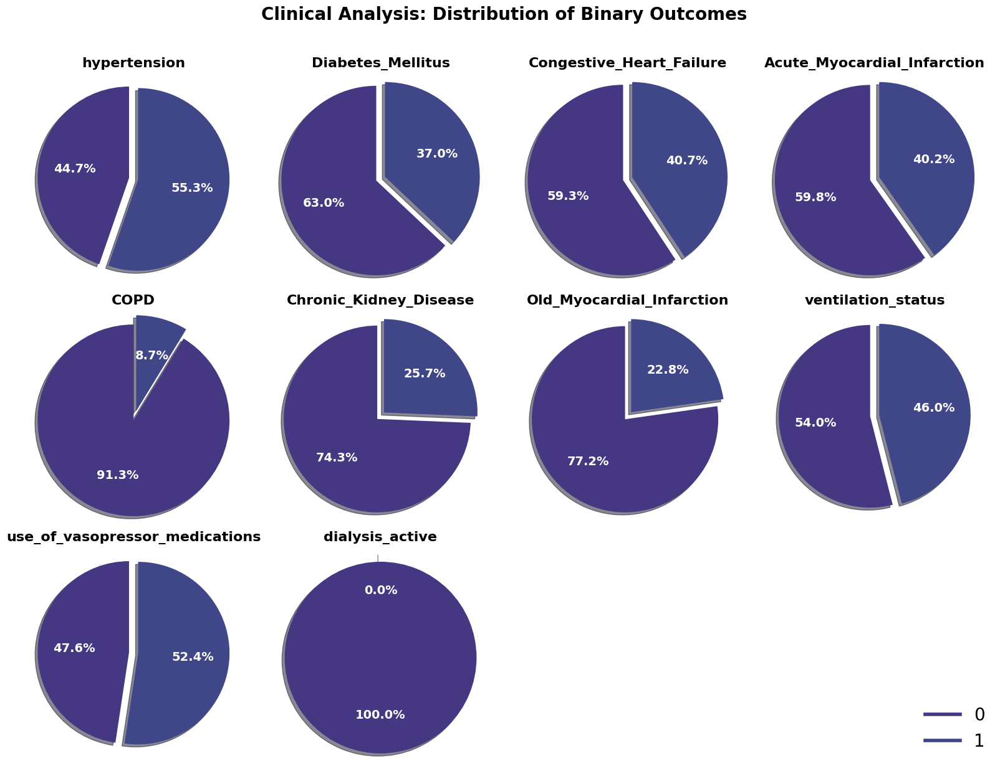

In [123]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom colors
color1 = rgb_to_hex([69, 55, 129])  # #482878 for '0'
color2 = rgb_to_hex([64, 71, 136])    # #440154 for '1'

# Custom text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Binary columns to plot
binary_columns = ['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
                   'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
                   'Old_Myocardial_Infarction', 'ventilation_status',
                   'use_of_vasopressor_medications', 'dialysis_active']

# DataFrame with binary values
binary_data = cluster_data1[binary_columns]

# Get normalized counts of 0 and 1 in each column
binary_counts = binary_data.apply(lambda x: x.value_counts(normalize=True))

# Create a subplot grid with 3 rows and 4 columns
num_columns = len(binary_columns)
num_rows = (num_columns + 3) // 4  # Ceiling division to determine rows
fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(16, 12))
fig.suptitle('Clinical Analysis: Distribution of Binary Outcomes', y=1.02, fontsize=20, fontweight='bold')  # Title with font customization


# Plot pie charts with custom styling
for i, column in enumerate(binary_columns):
    ax = axes[i // 4, i % 4]
    if column in binary_counts.columns:
        explode = [0.1, 0]  # Explode the first slice to add emphasis
        
        binary_counts[column].plot.pie(
            autopct='%1.1f%%', startangle=90, ax=ax, colors=[color1, color2], textprops=textprops, labels=None, explode=explode, shadow=True
        )
        ax.set_title(column, fontsize=16, fontweight='bold')  # Title with bold font
        ax.axis('equal')  # Ensures the pie chart remains circular
        ax.xaxis.set_visible(False)  # Hide x-axis
        ax.yaxis.set_visible(False)  # Hide y-axis
        
        # Set subplot background color

# Hide unused plots if there are extra subplot spaces
if num_columns < axes.size:
    for extra_ax in axes.flatten()[num_columns:]:
        extra_ax.axis("off")  # Hide unused plots

# Add a custom legend indicating which color represents '0' and which represents '1'
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='0'),  # Line indicating color for '0'
    plt.Line2D([0], [0], color=color2, lw=4, label='1')   # Line indicating color for '1'
]

# Place the legend in the lower-right corner
fig.legend(handles=legend_handles, loc='lower right', fontsize=20, frameon=False)  # Custom legend

# Adjust layout and display
plt.tight_layout()
plt.show()

<AxesSubplot: >

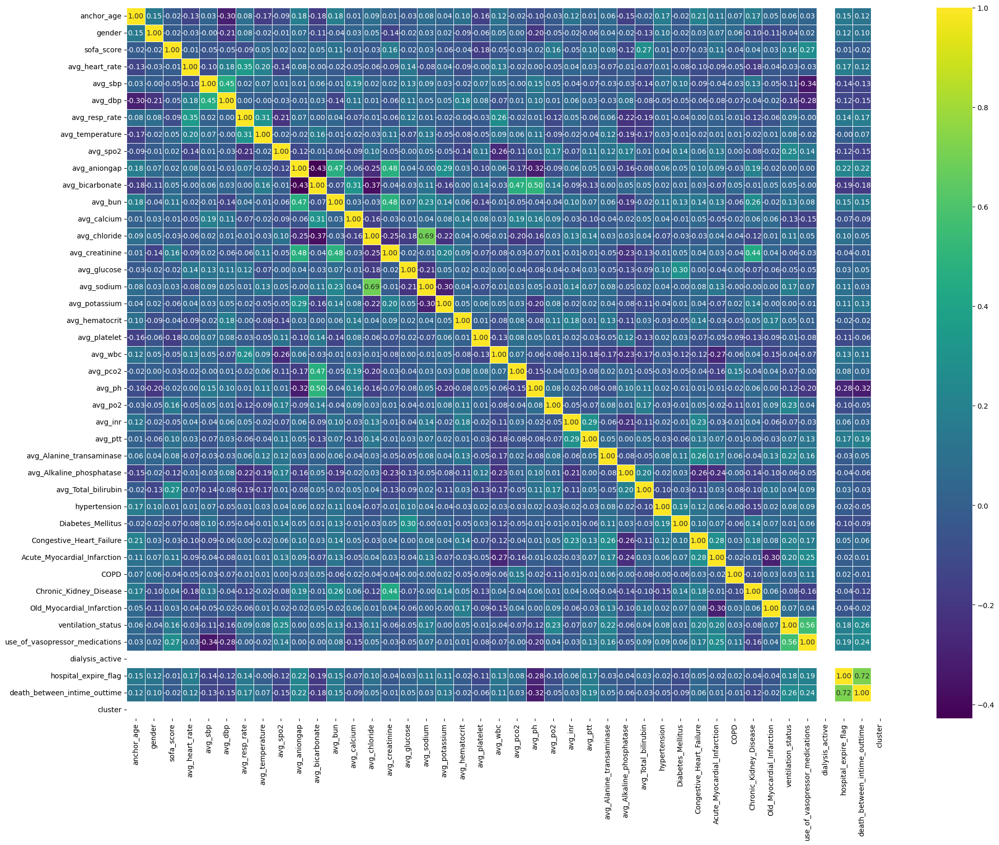

In [42]:
# Calculate correlation matrix
correlation_matrix = cluster_data1.corr()

plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5, annot_kws={"size": 10})

# cluster_data2

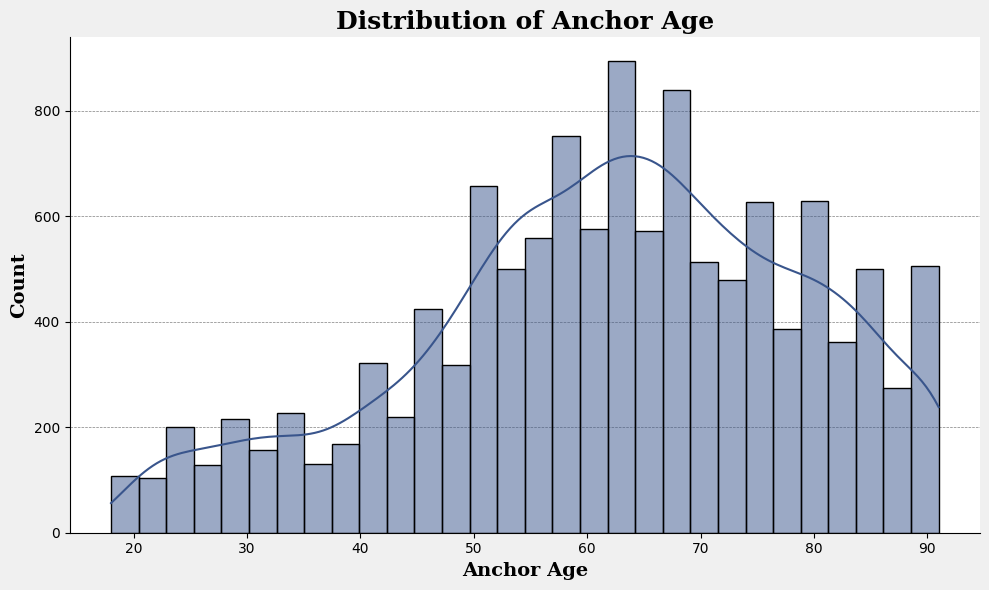

In [125]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color from RGB
custom_color = rgb_to_hex([57, 85, 140]) 

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background color for the entire plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background for the figure

# Create a histogram with KDE and custom color
sns.histplot(cluster_data2['anchor_age'], bins=30, kde=True, color=custom_color, ax=ax)

# Set a custom plot title with font properties
ax.set_title('Distribution of Anchor Age', fontsize=18, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Light gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the plot

# Customize x-axis and y-axis labels
ax.set_xlabel('Anchor Age', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis

# Hide unnecessary spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

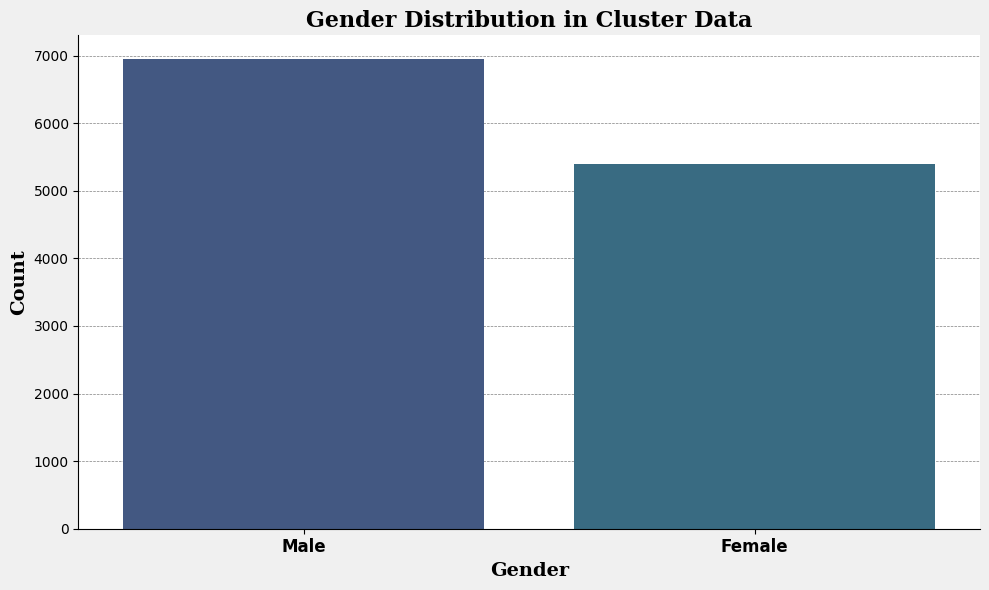

In [127]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Convert RGB values to hexadecimal
color1 = rgb_to_hex([57, 85, 140])  # Color for 'Male'
color2 = rgb_to_hex([45, 112, 142])    # Color for 'Female'

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background for the plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background

# Create a countplot with a customized palette
sns.countplot(x='gender', data=cluster_data2, palette=[color1, color2], ax=ax)

# Set plot title with customized font and alignment
ax.set_title('Gender Distribution in Cluster Data', fontsize=16, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the bars

# Customize x-axis and y-axis labels
ax.set_xlabel('Gender', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis label
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis label

# Customize the x-axis ticks and labels to replace '0' and '1' with 'Male' and 'Female'
ax.set_xticklabels(['Male', 'Female'], fontsize=12, fontweight='bold')  # Set custom labels for the x-axis

# Hide the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

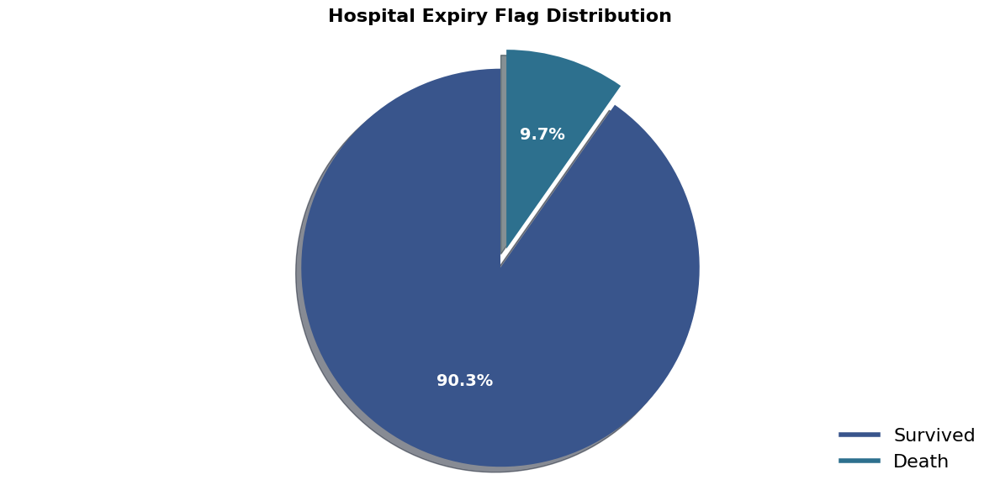

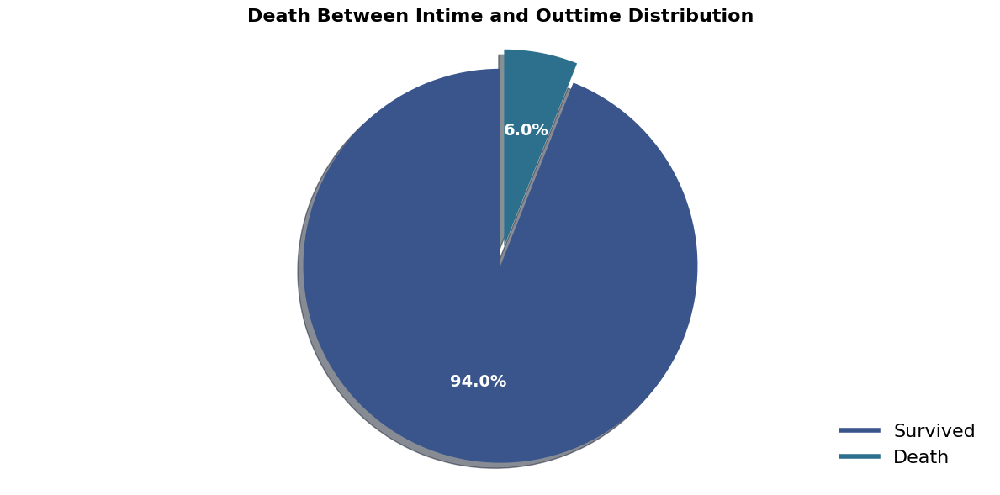

In [132]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([57, 85, 140])  # #482878 for 'Survived'
color2 = rgb_to_hex([45, 112, 142])   # #440154 for 'Death'

# Text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Set the background color for the plot
plt.figure(figsize=(12, 6)).patch.set_facecolor('#e0e0e0')  # Light gray background

# Pie chart for 'hospital_expire_flag' without explicit labels
plt.figure(figsize=(12, 6))
cluster_data2['hospital_expire_flag'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Hospital Expiry Flag Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add a custom legend indicating what each color represents
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='Survived'),  # Color for 'Survived'
    plt.Line2D([0], [0], color=color2, lw=4, label='Death')      # Color for 'Death'
]

plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

# Pie chart for 'death_between_intime_outtime' with similar changes
plt.figure(figsize=(12, 6))
cluster_data2['death_between_intime_outtime'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Death Between Intime and Outtime Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add the same custom legend
plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

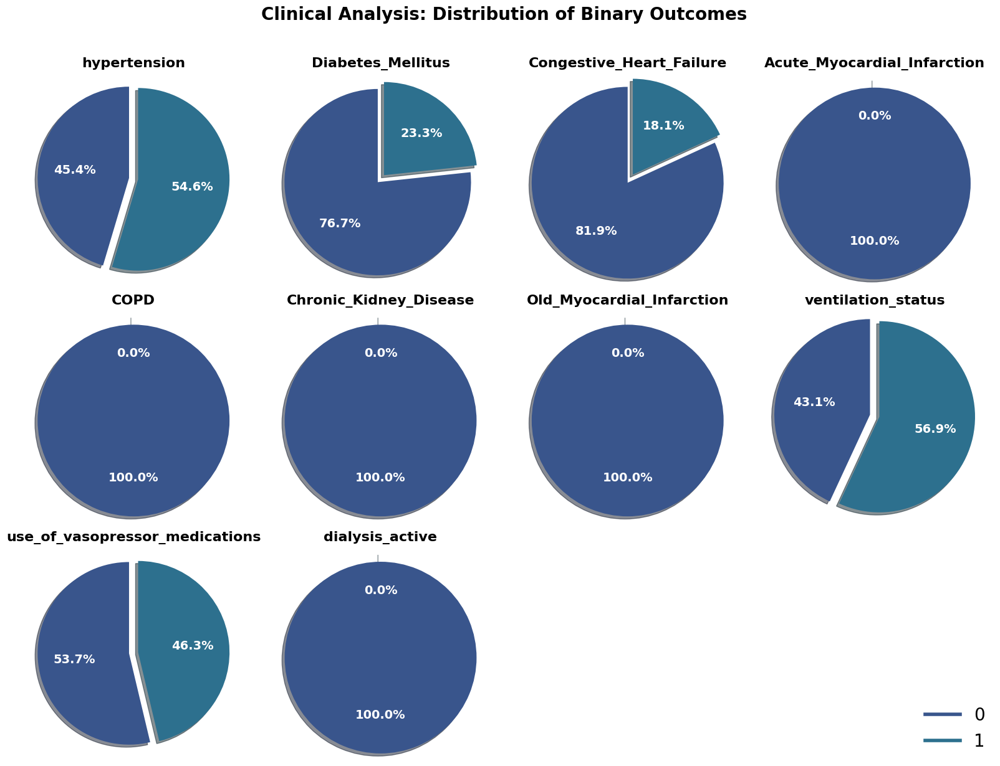

In [133]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom colors
color1 = rgb_to_hex([57, 85, 140]) # #482878 for '0'
color2 = rgb_to_hex([45, 112, 142])    # #440154 for '1'

# Custom text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Binary columns to plot
binary_columns = ['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
                   'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
                   'Old_Myocardial_Infarction', 'ventilation_status',
                   'use_of_vasopressor_medications', 'dialysis_active']

# DataFrame with binary values
binary_data = cluster_data2[binary_columns]

# Get normalized counts of 0 and 1 in each column
binary_counts = binary_data.apply(lambda x: x.value_counts(normalize=True))

# Create a subplot grid with 3 rows and 4 columns
num_columns = len(binary_columns)
num_rows = (num_columns + 3) // 4  # Ceiling division to determine rows
fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(16, 12))
fig.suptitle('Clinical Analysis: Distribution of Binary Outcomes', y=1.02, fontsize=20, fontweight='bold')  # Title with font customization


# Plot pie charts with custom styling
for i, column in enumerate(binary_columns):
    ax = axes[i // 4, i % 4]
    if column in binary_counts.columns:
        explode = [0.1, 0]  # Explode the first slice to add emphasis
        
        binary_counts[column].plot.pie(
            autopct='%1.1f%%', startangle=90, ax=ax, colors=[color1, color2], textprops=textprops, labels=None, explode=explode, shadow=True
        )
        ax.set_title(column, fontsize=16, fontweight='bold')  # Title with bold font
        ax.axis('equal')  # Ensures the pie chart remains circular
        ax.xaxis.set_visible(False)  # Hide x-axis
        ax.yaxis.set_visible(False)  # Hide y-axis
        
        # Set subplot background color

# Hide unused plots if there are extra subplot spaces
if num_columns < axes.size:
    for extra_ax in axes.flatten()[num_columns:]:
        extra_ax.axis("off")  # Hide unused plots

# Add a custom legend indicating which color represents '0' and which represents '1'
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='0'),  # Line indicating color for '0'
    plt.Line2D([0], [0], color=color2, lw=4, label='1')   # Line indicating color for '1'
]

# Place the legend in the lower-right corner
fig.legend(handles=legend_handles, loc='lower right', fontsize=20, frameon=False)  # Custom legend

# Adjust layout and display
plt.tight_layout()
plt.show()

<AxesSubplot: >

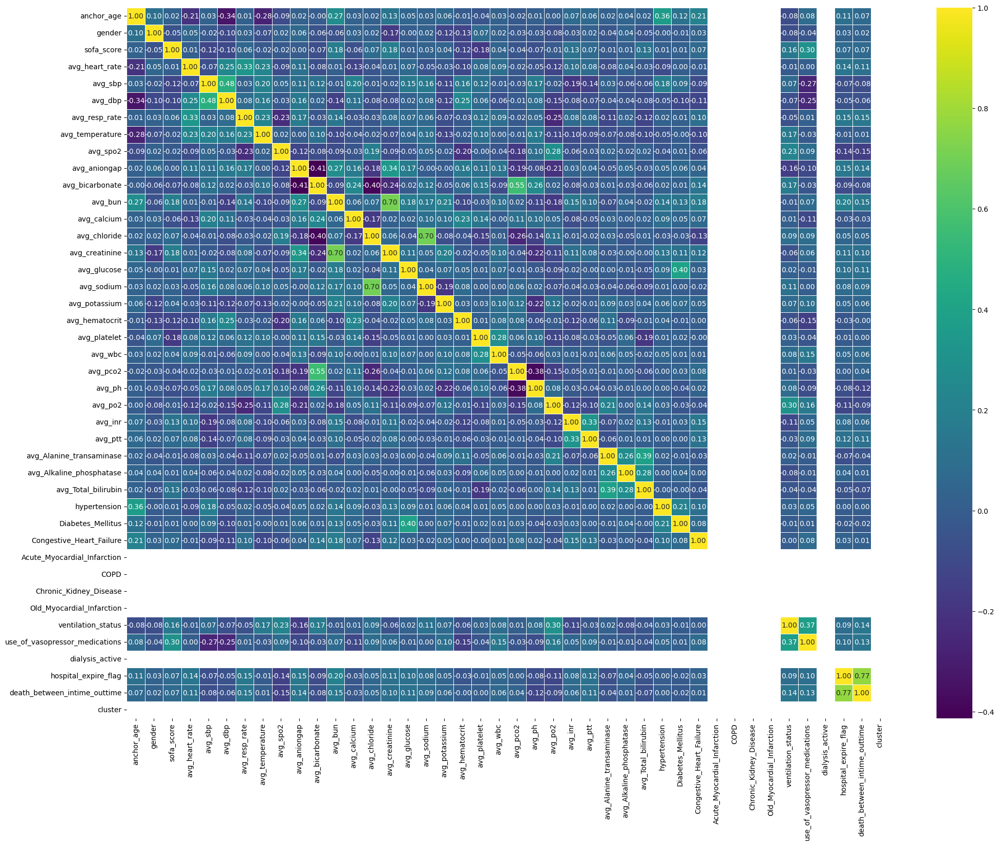

In [43]:
# Calculate correlation matrix
correlation_matrix = cluster_data2.corr()

plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5, annot_kws={"size": 10})

# cluster_data3

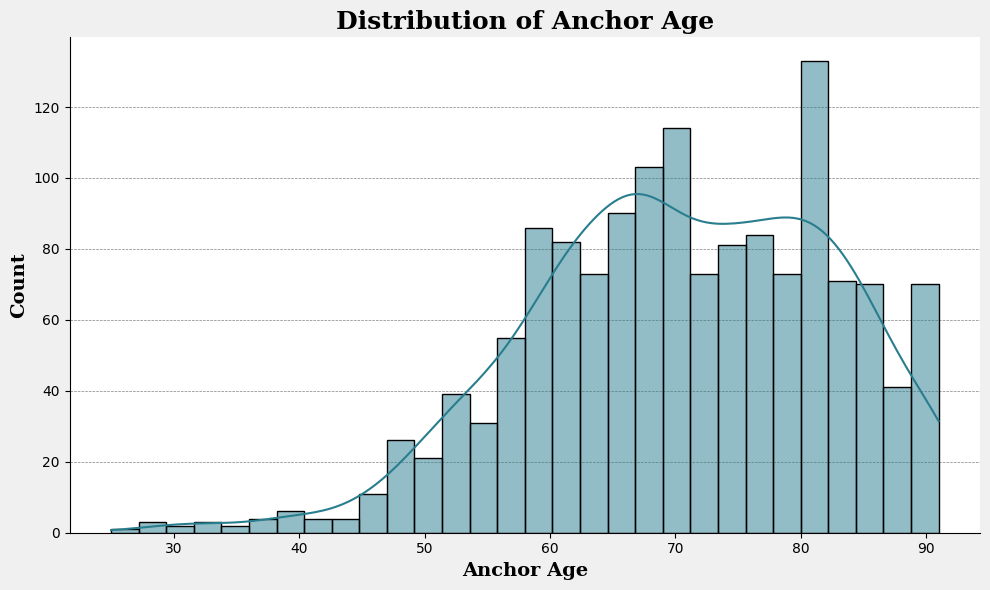

In [130]:
import seaborn as sns
import matplotlib.pyplot as plt

# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color from RGB
custom_color = rgb_to_hex([40, 125, 142]) 

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background color for the entire plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background for the figure

# Create a histogram with KDE and custom color
sns.histplot(cluster_data3['anchor_age'], bins=30, kde=True, color=custom_color, ax=ax)

# Set a custom plot title with font properties
ax.set_title('Distribution of Anchor Age', fontsize=18, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Light gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the plot

# Customize x-axis and y-axis labels
ax.set_xlabel('Anchor Age', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis

# Hide unnecessary spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

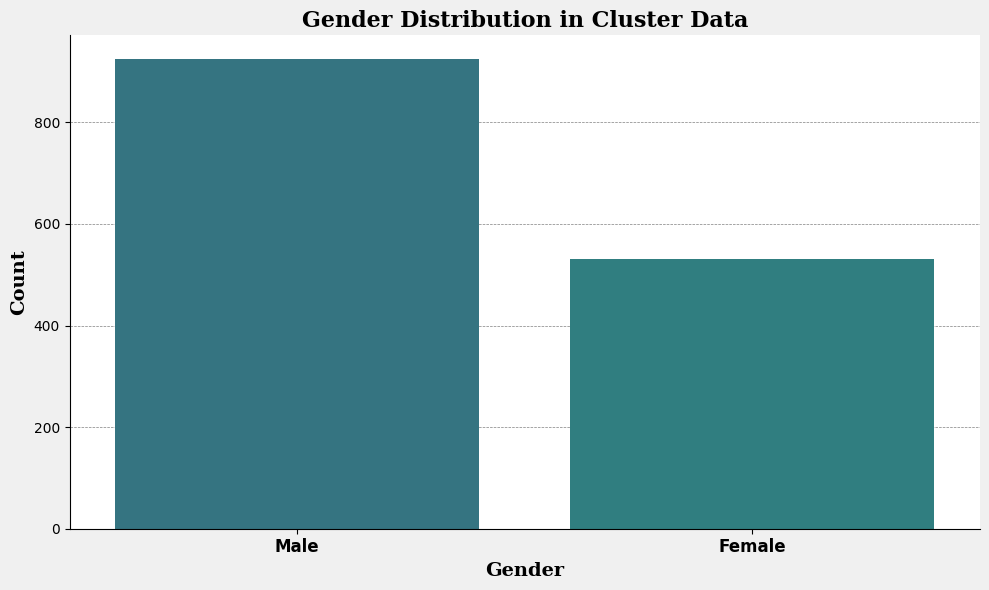

In [131]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Convert RGB values to hexadecimal
color1 = rgb_to_hex([40, 125, 142])  # Color for 'Male'
color2 = rgb_to_hex([35, 138, 141])    # Color for 'Female'

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background for the plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background

# Create a countplot with a customized palette
sns.countplot(x='gender', data=cluster_data3, palette=[color1, color2], ax=ax)

# Set plot title with customized font and alignment
ax.set_title('Gender Distribution in Cluster Data', fontsize=16, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the bars

# Customize x-axis and y-axis labels
ax.set_xlabel('Gender', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis label
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis label

# Customize the x-axis ticks and labels to replace '0' and '1' with 'Male' and 'Female'
ax.set_xticklabels(['Male', 'Female'], fontsize=12, fontweight='bold')  # Set custom labels for the x-axis

# Hide the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

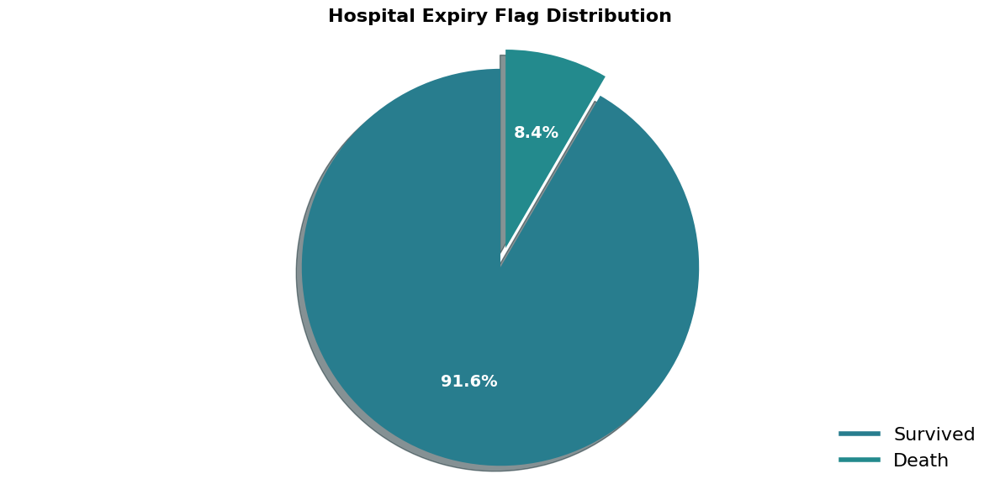

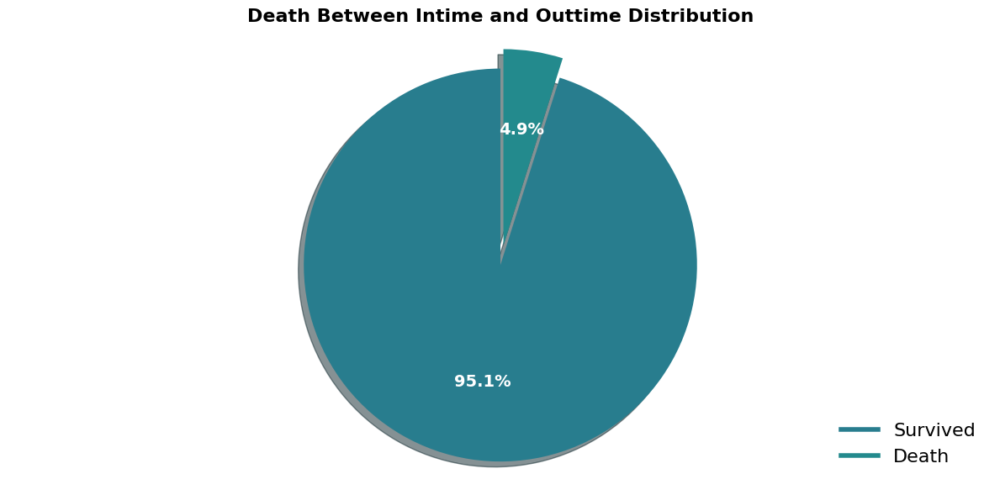

In [134]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([40, 125, 142])  # #482878 for 'Survived'
color2 = rgb_to_hex([35, 138, 141])    # #440154 for 'Death'

# Text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Set the background color for the plot
plt.figure(figsize=(12, 6)).patch.set_facecolor('#e0e0e0')  # Light gray background

# Pie chart for 'hospital_expire_flag' without explicit labels
plt.figure(figsize=(12, 6))
cluster_data3['hospital_expire_flag'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Hospital Expiry Flag Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add a custom legend indicating what each color represents
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='Survived'),  # Color for 'Survived'
    plt.Line2D([0], [0], color=color2, lw=4, label='Death')      # Color for 'Death'
]

plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

# Pie chart for 'death_between_intime_outtime' with similar changes
plt.figure(figsize=(12, 6))
cluster_data3['death_between_intime_outtime'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Death Between Intime and Outtime Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add the same custom legend
plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

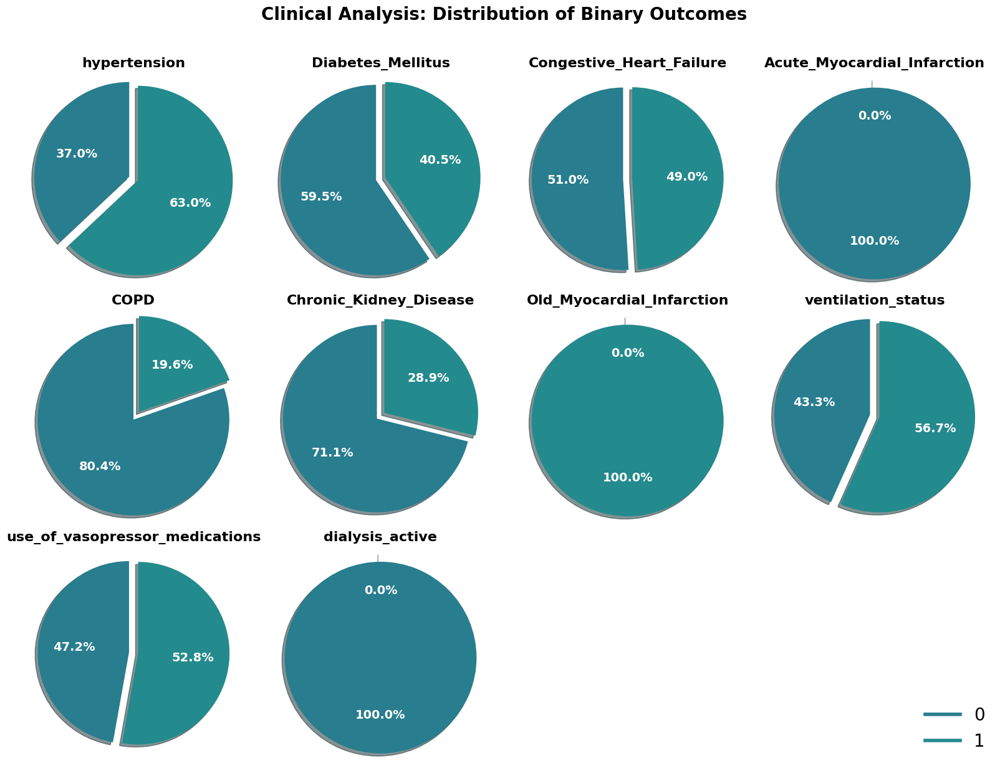

In [135]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([40, 125, 142]) # #482878 for '0'
color2 = rgb_to_hex([35, 138, 141])     # #440154 for '1'

# Custom text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Binary columns to plot
binary_columns = ['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
                   'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
                   'Old_Myocardial_Infarction', 'ventilation_status',
                   'use_of_vasopressor_medications', 'dialysis_active']

# DataFrame with binary values
binary_data = cluster_data3[binary_columns]

# Get normalized counts of 0 and 1 in each column
binary_counts = binary_data.apply(lambda x: x.value_counts(normalize=True))

# Create a subplot grid with 3 rows and 4 columns
num_columns = len(binary_columns)
num_rows = (num_columns + 3) // 4  # Ceiling division to determine rows
fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(16, 12))
fig.suptitle('Clinical Analysis: Distribution of Binary Outcomes', y=1.02, fontsize=20, fontweight='bold')  # Title with font customization


# Plot pie charts with custom styling
for i, column in enumerate(binary_columns):
    ax = axes[i // 4, i % 4]
    if column in binary_counts.columns:
        explode = [0.1, 0]  # Explode the first slice to add emphasis
        
        binary_counts[column].plot.pie(
            autopct='%1.1f%%', startangle=90, ax=ax, colors=[color1, color2], textprops=textprops, labels=None, explode=explode, shadow=True
        )
        ax.set_title(column, fontsize=16, fontweight='bold')  # Title with bold font
        ax.axis('equal')  # Ensures the pie chart remains circular
        ax.xaxis.set_visible(False)  # Hide x-axis
        ax.yaxis.set_visible(False)  # Hide y-axis
        
        # Set subplot background color

# Hide unused plots if there are extra subplot spaces
if num_columns < axes.size:
    for extra_ax in axes.flatten()[num_columns:]:
        extra_ax.axis("off")  # Hide unused plots

# Add a custom legend indicating which color represents '0' and which represents '1'
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='0'),  # Line indicating color for '0'
    plt.Line2D([0], [0], color=color2, lw=4, label='1')   # Line indicating color for '1'
]

# Place the legend in the lower-right corner
fig.legend(handles=legend_handles, loc='lower right', fontsize=20, frameon=False)  # Custom legend

# Adjust layout and display
plt.tight_layout()
plt.show()

<AxesSubplot: >

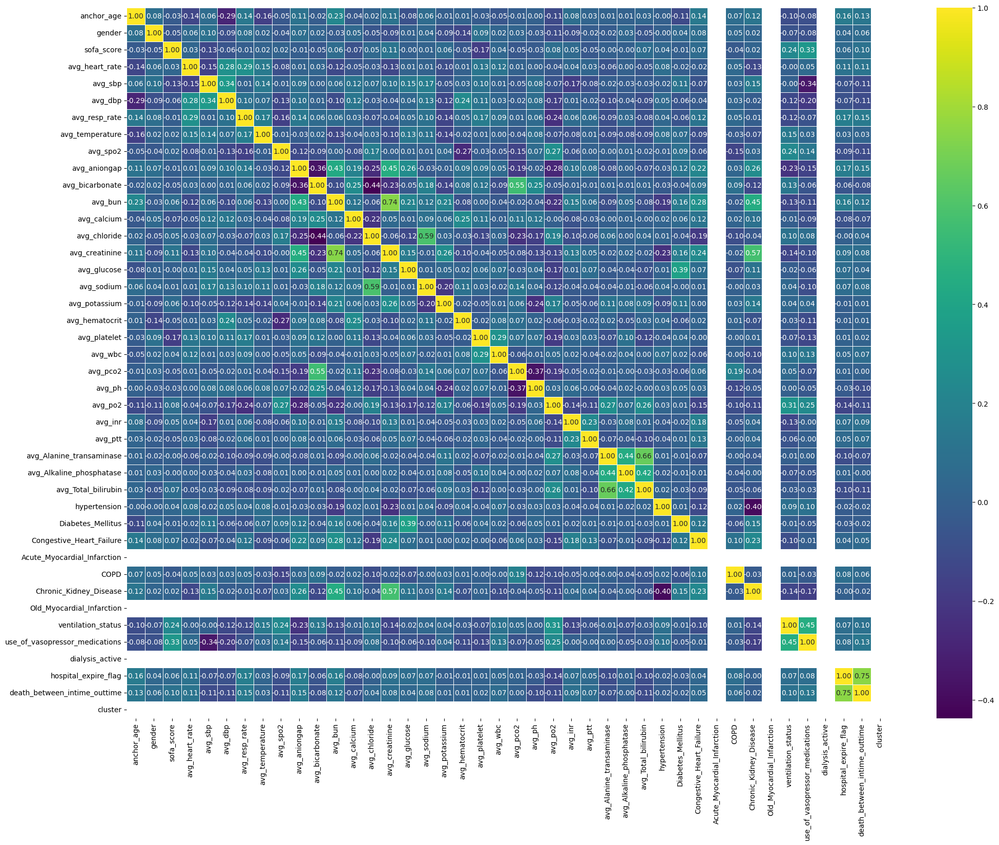

In [44]:
# Calculate correlation matrix
correlation_matrix = cluster_data3.corr()

plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5, annot_kws={"size": 10})

# cluster_data4

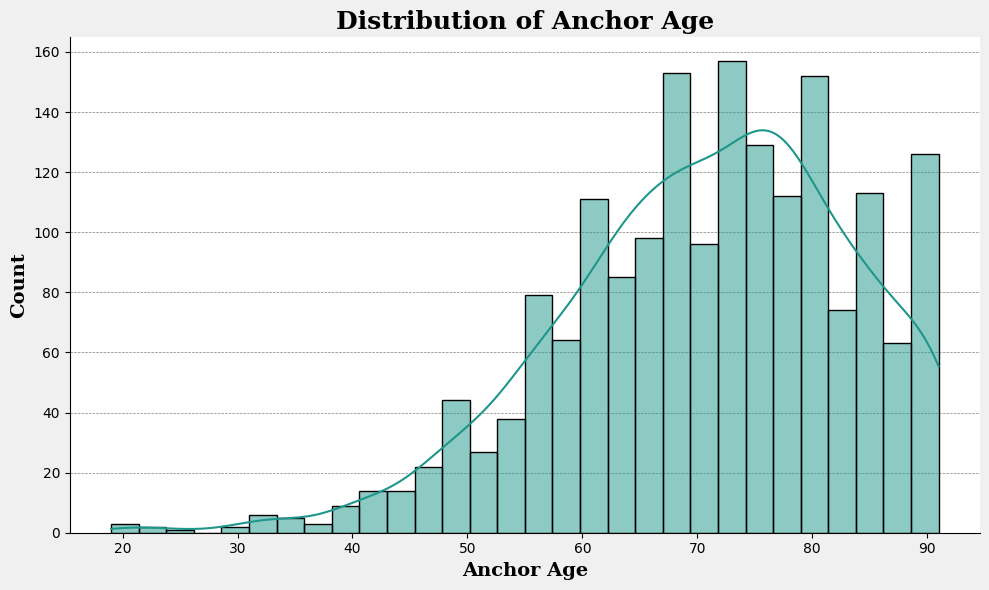

In [136]:
import seaborn as sns
import matplotlib.pyplot as plt

# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color from RGB
custom_color = rgb_to_hex([31, 150, 139]) 

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background color for the entire plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background for the figure

# Create a histogram with KDE and custom color
sns.histplot(cluster_data4['anchor_age'], bins=30, kde=True, color=custom_color, ax=ax)

# Set a custom plot title with font properties
ax.set_title('Distribution of Anchor Age', fontsize=18, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Light gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the plot

# Customize x-axis and y-axis labels
ax.set_xlabel('Anchor Age', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis

# Hide unnecessary spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

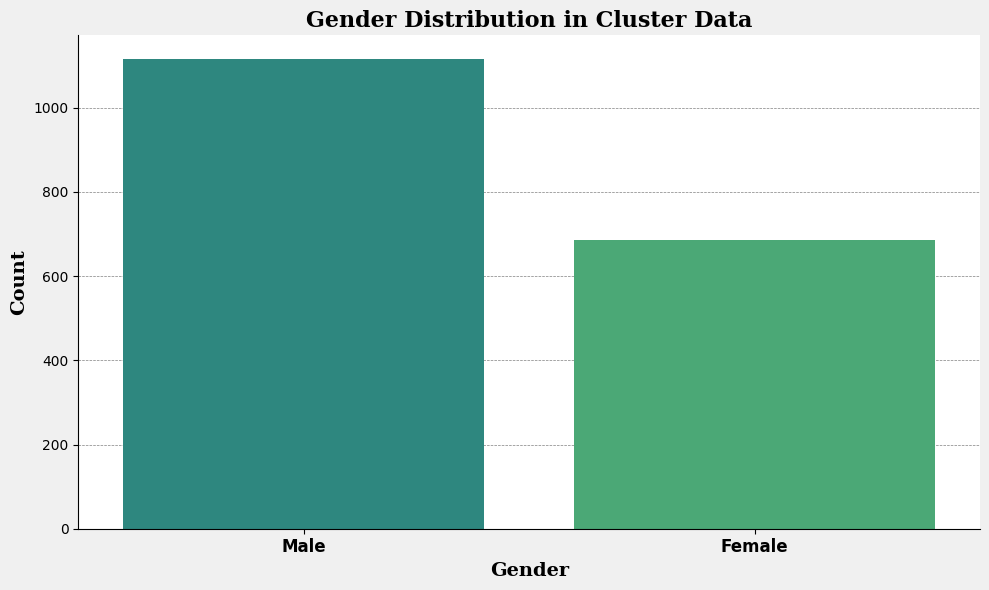

In [144]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Convert RGB values to hexadecimal
color1 = rgb_to_hex([31, 150, 139])  # Color for 'Male'
color2 = rgb_to_hex([60, 183, 117])    # Color for 'Female'

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background for the plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background

# Create a countplot with a customized palette
sns.countplot(x='gender', data=cluster_data4, palette=[color1, color2], ax=ax)

# Set plot title with customized font and alignment
ax.set_title('Gender Distribution in Cluster Data', fontsize=16, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the bars

# Customize x-axis and y-axis labels
ax.set_xlabel('Gender', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis label
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis label

# Customize the x-axis ticks and labels to replace '0' and '1' with 'Male' and 'Female'
ax.set_xticklabels(['Male', 'Female'], fontsize=12, fontweight='bold')  # Set custom labels for the x-axis

# Hide the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

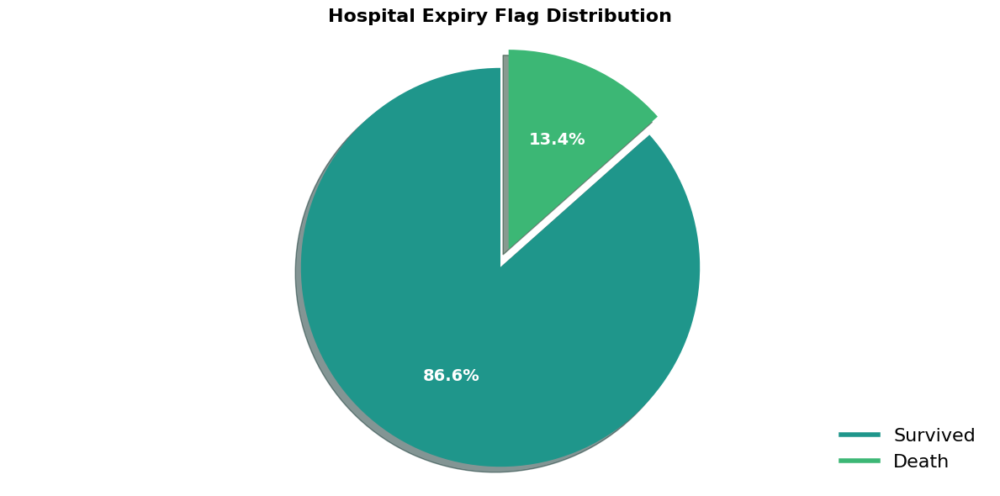

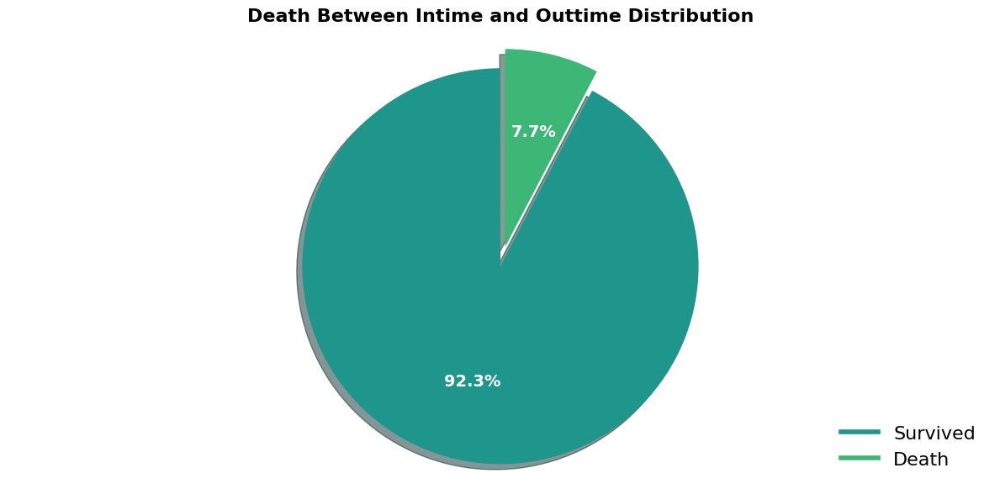

In [143]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([31, 150, 139])  # #482878 for 'Survived'
color2 = rgb_to_hex([60, 183, 117])    # #440154 for 'Death'

# Text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Set the background color for the plot
plt.figure(figsize=(12, 6)).patch.set_facecolor('#e0e0e0')  # Light gray background

# Pie chart for 'hospital_expire_flag' without explicit labels
plt.figure(figsize=(12, 6))
cluster_data4['hospital_expire_flag'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Hospital Expiry Flag Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add a custom legend indicating what each color represents
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='Survived'),  # Color for 'Survived'
    plt.Line2D([0], [0], color=color2, lw=4, label='Death')      # Color for 'Death'
]

plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

# Pie chart for 'death_between_intime_outtime' with similar changes
plt.figure(figsize=(12, 6))
cluster_data4['death_between_intime_outtime'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Death Between Intime and Outtime Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add the same custom legend
plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

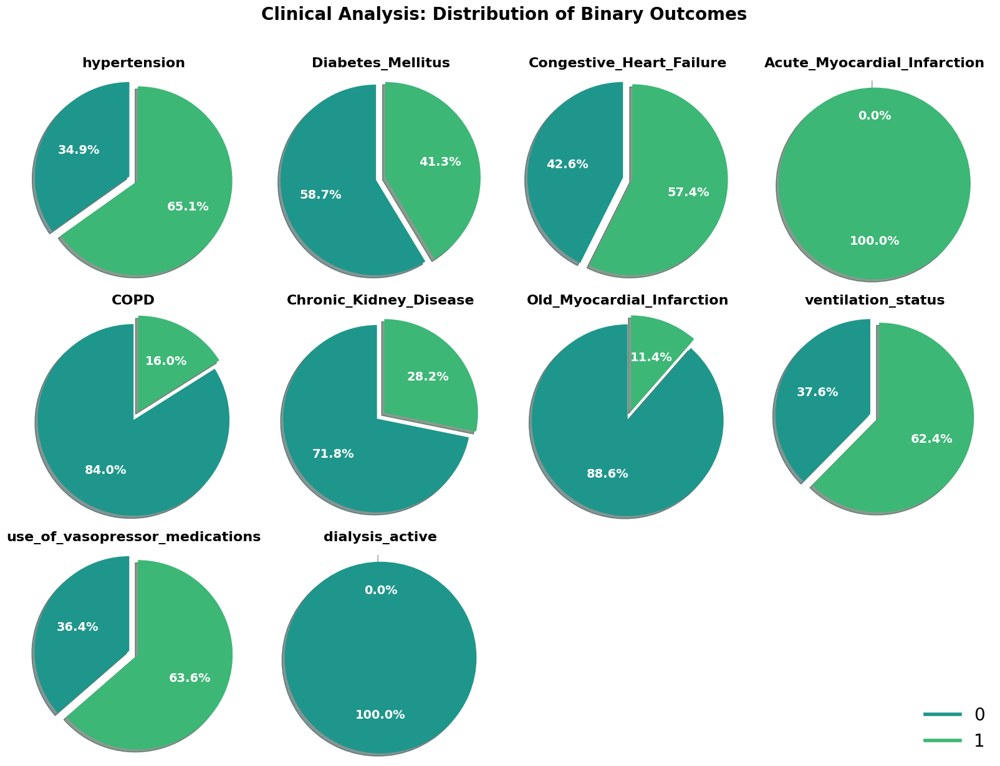

In [142]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([31, 150, 139]) # #482878 for '0'
color2 = rgb_to_hex([60, 183, 117])     # #440154 for '1'

# Custom text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Binary columns to plot
binary_columns = ['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
                   'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
                   'Old_Myocardial_Infarction', 'ventilation_status',
                   'use_of_vasopressor_medications', 'dialysis_active']

# DataFrame with binary values
binary_data = cluster_data4[binary_columns]

# Get normalized counts of 0 and 1 in each column
binary_counts = binary_data.apply(lambda x: x.value_counts(normalize=True))

# Create a subplot grid with 3 rows and 4 columns
num_columns = len(binary_columns)
num_rows = (num_columns + 3) // 4  # Ceiling division to determine rows
fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(16, 12))
fig.suptitle('Clinical Analysis: Distribution of Binary Outcomes', y=1.02, fontsize=20, fontweight='bold')  # Title with font customization


# Plot pie charts with custom styling
for i, column in enumerate(binary_columns):
    ax = axes[i // 4, i % 4]
    if column in binary_counts.columns:
        explode = [0.1, 0]  # Explode the first slice to add emphasis
        
        binary_counts[column].plot.pie(
            autopct='%1.1f%%', startangle=90, ax=ax, colors=[color1, color2], textprops=textprops, labels=None, explode=explode, shadow=True
        )
        ax.set_title(column, fontsize=16, fontweight='bold')  # Title with bold font
        ax.axis('equal')  # Ensures the pie chart remains circular
        ax.xaxis.set_visible(False)  # Hide x-axis
        ax.yaxis.set_visible(False)  # Hide y-axis
        
        # Set subplot background color

# Hide unused plots if there are extra subplot spaces
if num_columns < axes.size:
    for extra_ax in axes.flatten()[num_columns:]:
        extra_ax.axis("off")  # Hide unused plots

# Add a custom legend indicating which color represents '0' and which represents '1'
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='0'),  # Line indicating color for '0'
    plt.Line2D([0], [0], color=color2, lw=4, label='1')   # Line indicating color for '1'
]

# Place the legend in the lower-right corner
fig.legend(handles=legend_handles, loc='lower right', fontsize=20, frameon=False)  # Custom legend

# Adjust layout and display
plt.tight_layout()
plt.show()

<AxesSubplot: >

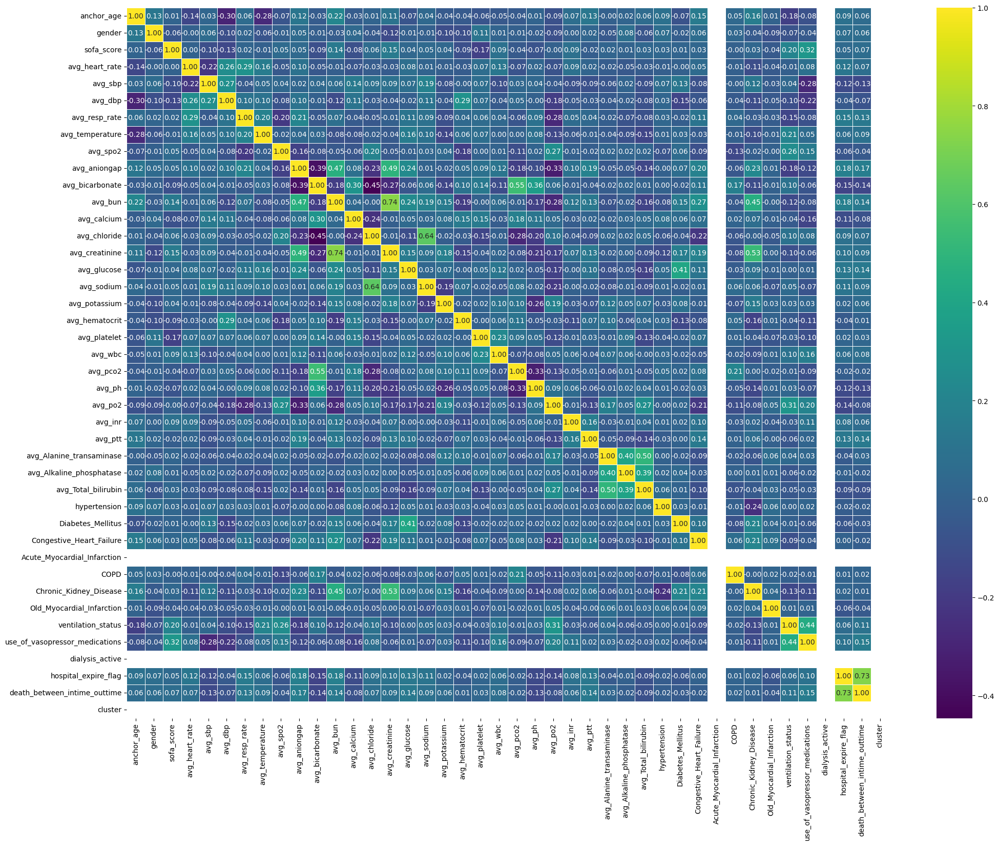

In [45]:
# Calculate correlation matrix
correlation_matrix = cluster_data4.corr()

plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5, annot_kws={"size": 10})

# cluster_data5

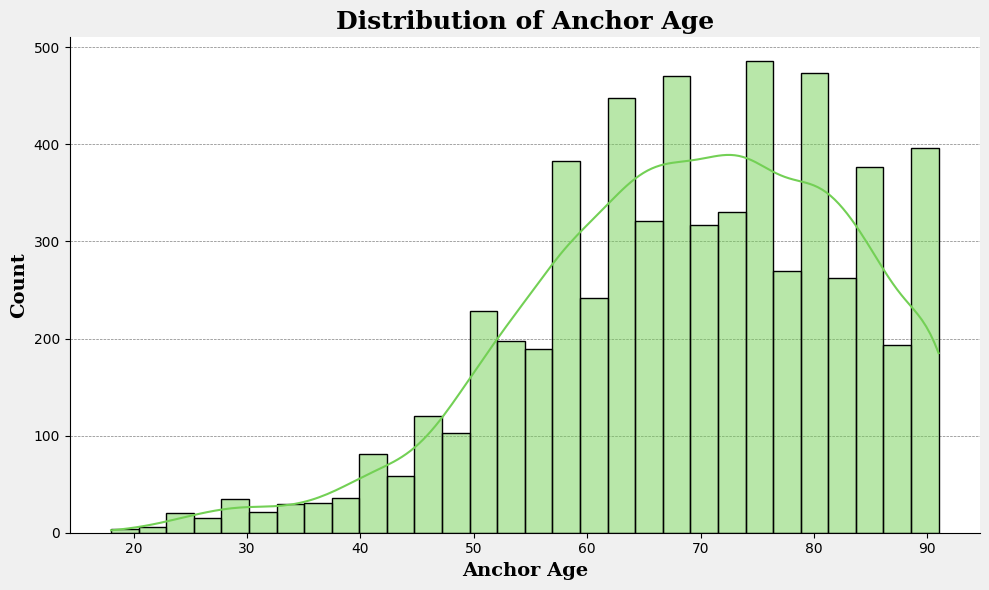

In [145]:
import seaborn as sns
import matplotlib.pyplot as plt

# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color from RGB
custom_color = rgb_to_hex([115, 208, 85]) 

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background color for the entire plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background for the figure

# Create a histogram with KDE and custom color
sns.histplot(cluster_data5['anchor_age'], bins=30, kde=True, color=custom_color, ax=ax)

# Set a custom plot title with font properties
ax.set_title('Distribution of Anchor Age', fontsize=18, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Light gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the plot

# Customize x-axis and y-axis labels
ax.set_xlabel('Anchor Age', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis

# Hide unnecessary spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

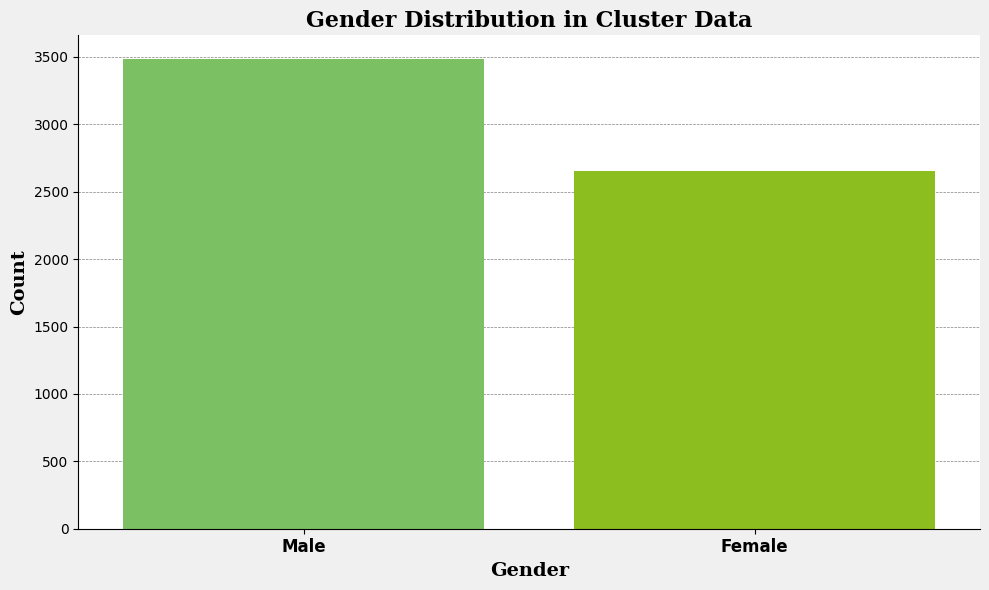

In [146]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Convert RGB values to hexadecimal
color1 = rgb_to_hex([115, 208, 85])  # Color for 'Male'
color2 = rgb_to_hex([149, 216, 6])    # Color for 'Female'

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background for the plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background

# Create a countplot with a customized palette
sns.countplot(x='gender', data=cluster_data5, palette=[color1, color2], ax=ax)

# Set plot title with customized font and alignment
ax.set_title('Gender Distribution in Cluster Data', fontsize=16, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the bars

# Customize x-axis and y-axis labels
ax.set_xlabel('Gender', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis label
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis label

# Customize the x-axis ticks and labels to replace '0' and '1' with 'Male' and 'Female'
ax.set_xticklabels(['Male', 'Female'], fontsize=12, fontweight='bold')  # Set custom labels for the x-axis

# Hide the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

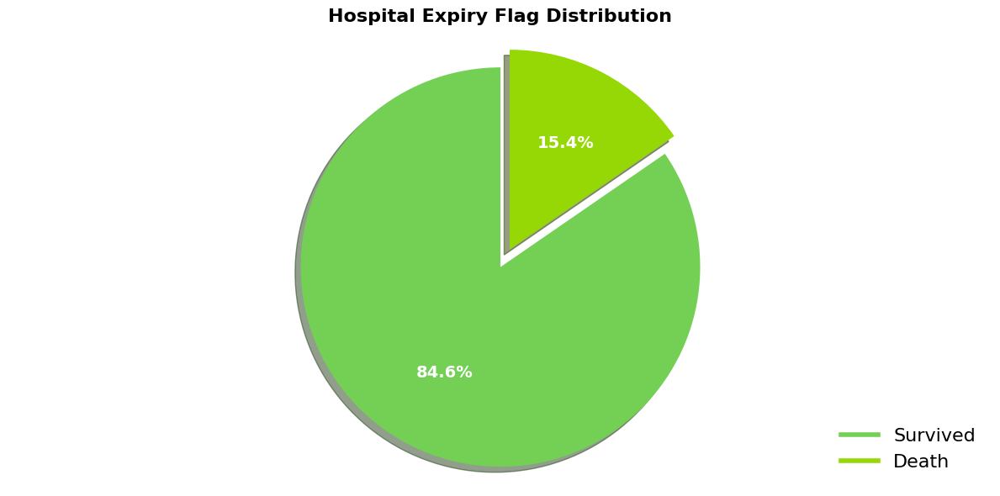

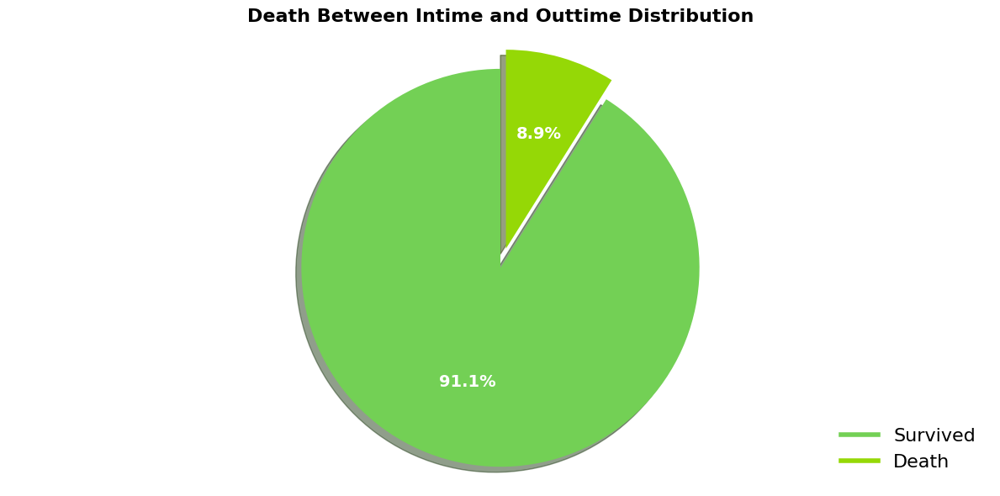

In [147]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([115, 208, 85])  # #482878 for 'Survived'
color2 = rgb_to_hex([149, 216, 6])    # #440154 for 'Death'

# Text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Set the background color for the plot
plt.figure(figsize=(12, 6)).patch.set_facecolor('#e0e0e0')  # Light gray background

# Pie chart for 'hospital_expire_flag' without explicit labels
plt.figure(figsize=(12, 6))
cluster_data5['hospital_expire_flag'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Hospital Expiry Flag Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add a custom legend indicating what each color represents
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='Survived'),  # Color for 'Survived'
    plt.Line2D([0], [0], color=color2, lw=4, label='Death')      # Color for 'Death'
]

plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

# Pie chart for 'death_between_intime_outtime' with similar changes
plt.figure(figsize=(12, 6))
cluster_data5['death_between_intime_outtime'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Death Between Intime and Outtime Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add the same custom legend
plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

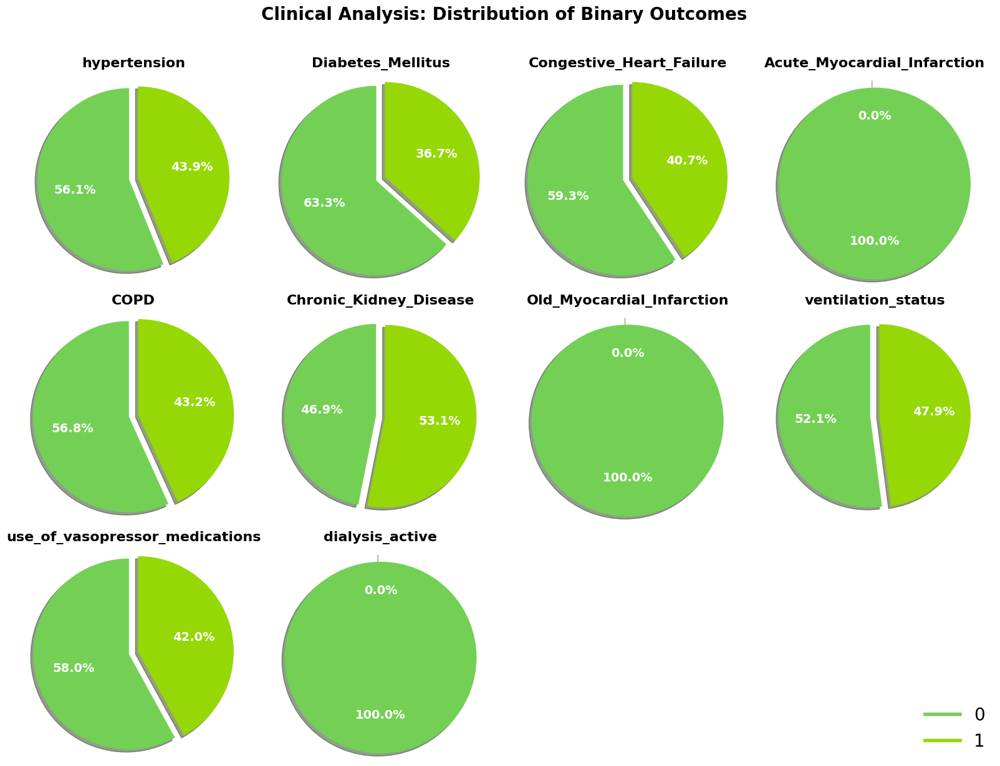

In [148]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([115, 208, 85]) # #482878 for '0'
color2 = rgb_to_hex([149, 216, 6])     # #440154 for '1'

# Custom text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Binary columns to plot
binary_columns = ['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
                   'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
                   'Old_Myocardial_Infarction', 'ventilation_status',
                   'use_of_vasopressor_medications', 'dialysis_active']

# DataFrame with binary values
binary_data = cluster_data5[binary_columns]

# Get normalized counts of 0 and 1 in each column
binary_counts = binary_data.apply(lambda x: x.value_counts(normalize=True))

# Create a subplot grid with 3 rows and 4 columns
num_columns = len(binary_columns)
num_rows = (num_columns + 3) // 4  # Ceiling division to determine rows
fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(16, 12))
fig.suptitle('Clinical Analysis: Distribution of Binary Outcomes', y=1.02, fontsize=20, fontweight='bold')  # Title with font customization


# Plot pie charts with custom styling
for i, column in enumerate(binary_columns):
    ax = axes[i // 4, i % 4]
    if column in binary_counts.columns:
        explode = [0.1, 0]  # Explode the first slice to add emphasis
        
        binary_counts[column].plot.pie(
            autopct='%1.1f%%', startangle=90, ax=ax, colors=[color1, color2], textprops=textprops, labels=None, explode=explode, shadow=True
        )
        ax.set_title(column, fontsize=16, fontweight='bold')  # Title with bold font
        ax.axis('equal')  # Ensures the pie chart remains circular
        ax.xaxis.set_visible(False)  # Hide x-axis
        ax.yaxis.set_visible(False)  # Hide y-axis
        
        # Set subplot background color

# Hide unused plots if there are extra subplot spaces
if num_columns < axes.size:
    for extra_ax in axes.flatten()[num_columns:]:
        extra_ax.axis("off")  # Hide unused plots

# Add a custom legend indicating which color represents '0' and which represents '1'
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='0'),  # Line indicating color for '0'
    plt.Line2D([0], [0], color=color2, lw=4, label='1')   # Line indicating color for '1'
]

# Place the legend in the lower-right corner
fig.legend(handles=legend_handles, loc='lower right', fontsize=20, frameon=False)  # Custom legend

# Adjust layout and display
plt.tight_layout()
plt.show()

<AxesSubplot: >

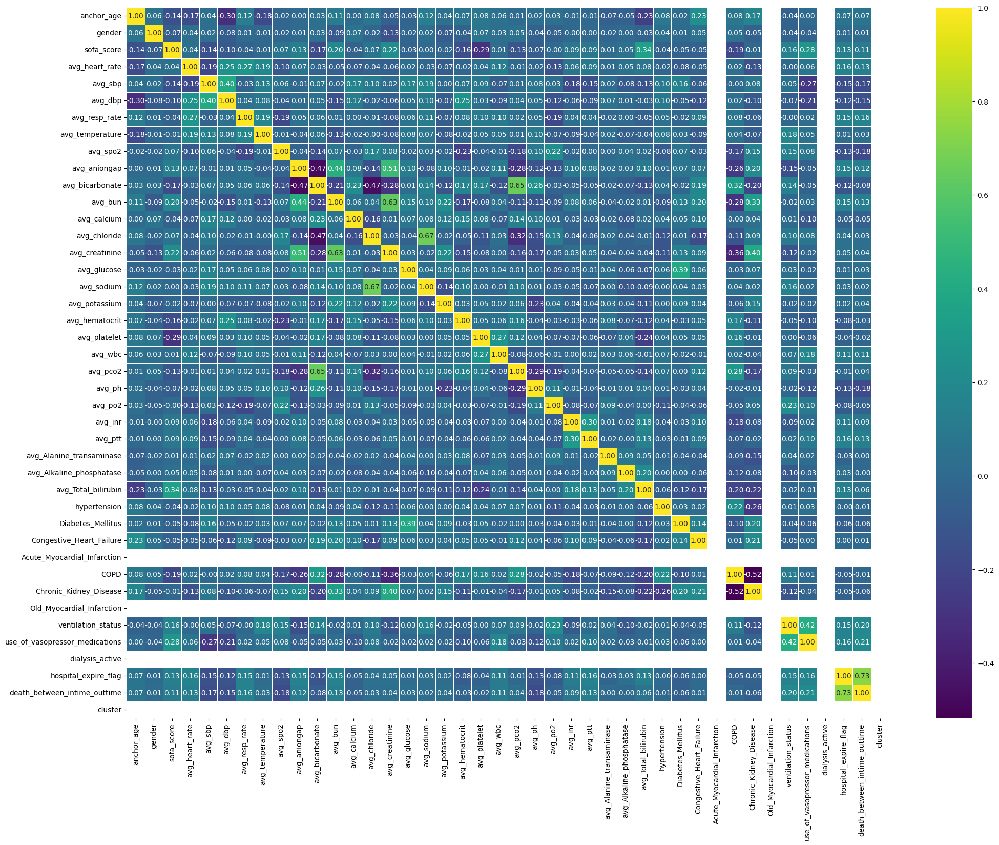

In [46]:
# Calculate correlation matrix
correlation_matrix = cluster_data5.corr()

plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5, annot_kws={"size": 10})

# cluster_data6

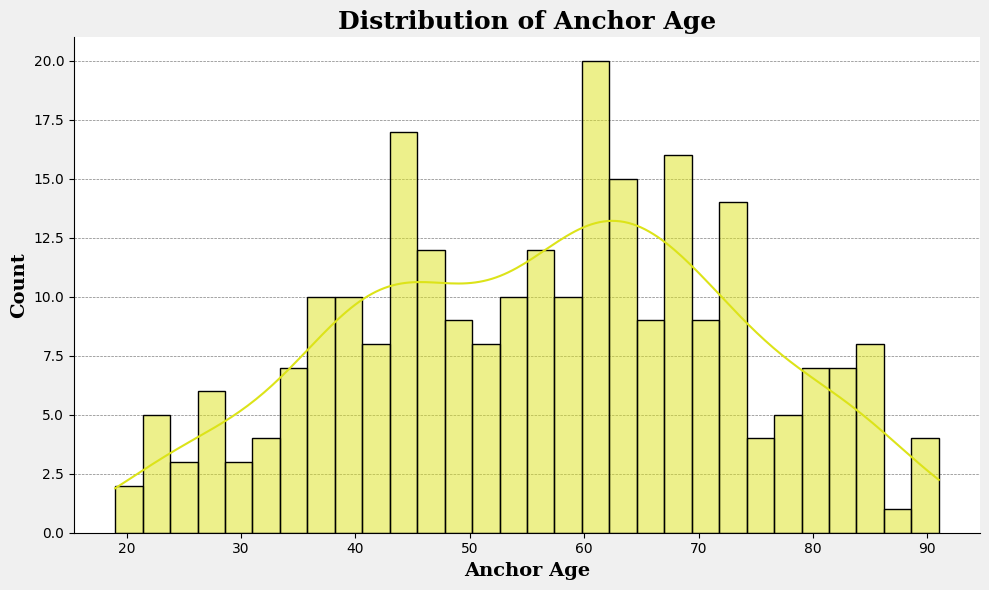

In [149]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Custom color from RGB
custom_color = rgb_to_hex([220, 227, 25]) 

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background color for the entire plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background for the figure

# Create a histogram with KDE and custom color
sns.histplot(cluster_data6['anchor_age'], bins=30, kde=True, color=custom_color, ax=ax)

# Set a custom plot title with font properties
ax.set_title('Distribution of Anchor Age', fontsize=18, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Light gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the plot

# Customize x-axis and y-axis labels
ax.set_xlabel('Anchor Age', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis

# Hide unnecessary spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

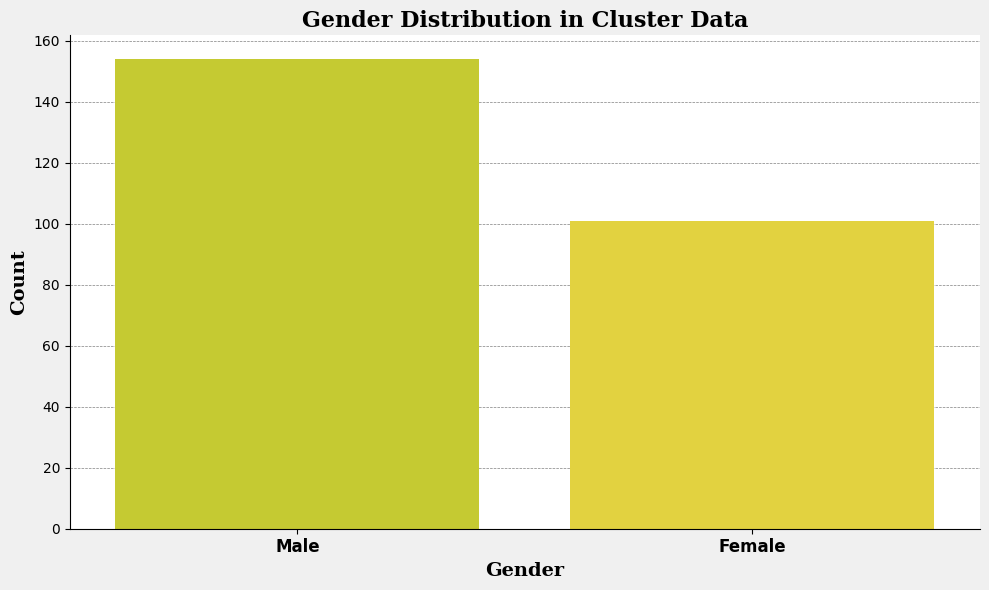

In [150]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Convert RGB values to hexadecimal
color1 = rgb_to_hex([220, 227, 25])  # Color for 'Male'
color2 = rgb_to_hex([253, 231, 37])    # Color for 'Female'

# Create a customized figure
fig, ax = plt.subplots(figsize=(10, 6))

# Set a light background for the plot
fig.patch.set_facecolor('#f0f0f0')  # Light gray background

# Create a countplot with a customized palette
sns.countplot(x='gender', data=cluster_data6, palette=[color1, color2], ax=ax)

# Set plot title with customized font and alignment
ax.set_title('Gender Distribution in Cluster Data', fontsize=16, fontweight='bold', family='serif', loc='center')

# Add gridlines for visual clarity
ax.yaxis.grid(True, linestyle='--', linewidth=0.5, color='gray')  # Gridlines on the y-axis
ax.set_axisbelow(True)  # Ensure gridlines are behind the bars

# Customize x-axis and y-axis labels
ax.set_xlabel('Gender', fontsize=14, fontweight='bold', family='serif')  # Custom font for x-axis label
ax.set_ylabel('Count', fontsize=14, fontweight='bold', family='serif')  # Custom font for y-axis label

# Customize the x-axis ticks and labels to replace '0' and '1' with 'Male' and 'Female'
ax.set_xticklabels(['Male', 'Female'], fontsize=12, fontweight='bold')  # Set custom labels for the x-axis

# Hide the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

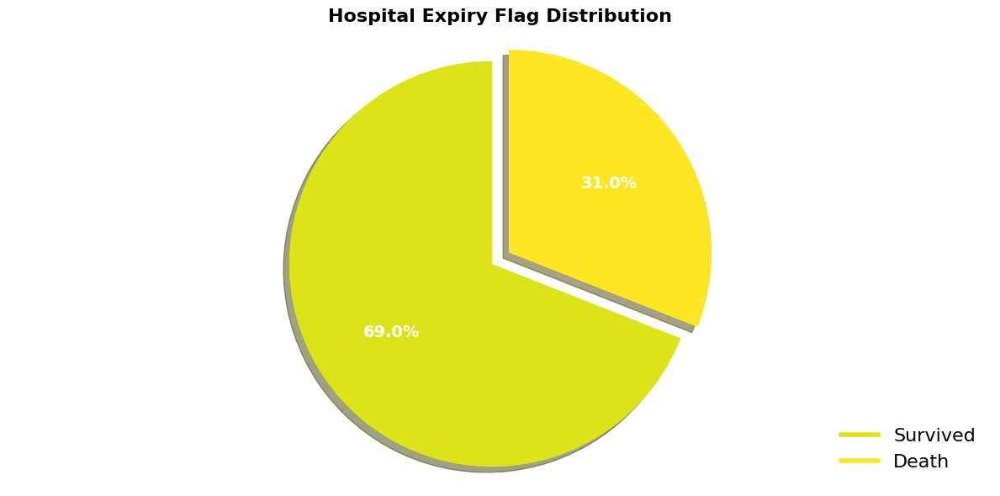

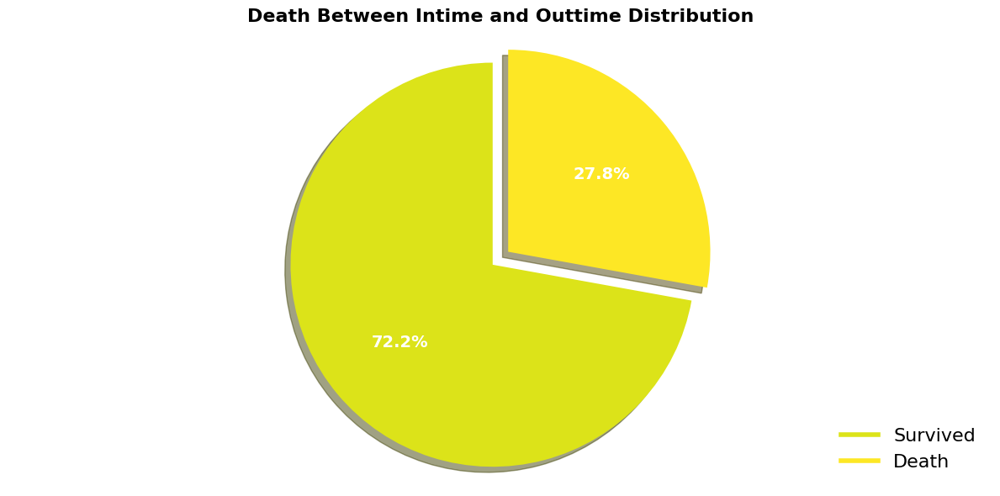

In [151]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([220, 227, 25])  # #482878 for 'Survived'
color2 = rgb_to_hex([253, 231, 37])    # #440154 for 'Death'

# Text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Set the background color for the plot
plt.figure(figsize=(12, 6)).patch.set_facecolor('#e0e0e0')  # Light gray background

# Pie chart for 'hospital_expire_flag' without explicit labels
plt.figure(figsize=(12, 6))
cluster_data6['hospital_expire_flag'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Hospital Expiry Flag Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add a custom legend indicating what each color represents
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='Survived'),  # Color for 'Survived'
    plt.Line2D([0], [0], color=color2, lw=4, label='Death')      # Color for 'Death'
]

plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

# Pie chart for 'death_between_intime_outtime' with similar changes
plt.figure(figsize=(12, 6))
cluster_data6['death_between_intime_outtime'].value_counts().plot.pie(
    autopct='%1.1f%%', startangle=90, colors=[color1, color2], textprops=textprops, shadow=True, explode=[0.1, 0]
)
plt.title('Death Between Intime and Outtime Distribution', fontsize=16, fontweight='bold')
plt.axis('equal')  # Ensure circular pie chart
plt.gca().xaxis.set_visible(False)  # Hide x-axis
plt.gca().yaxis.set_visible(False)  # Hide y-axis
plt.tight_layout()

# Add the same custom legend
plt.legend(handles=legend_handles, loc='lower right', fontsize=16, frameon=False)

# Display the plot
plt.show()

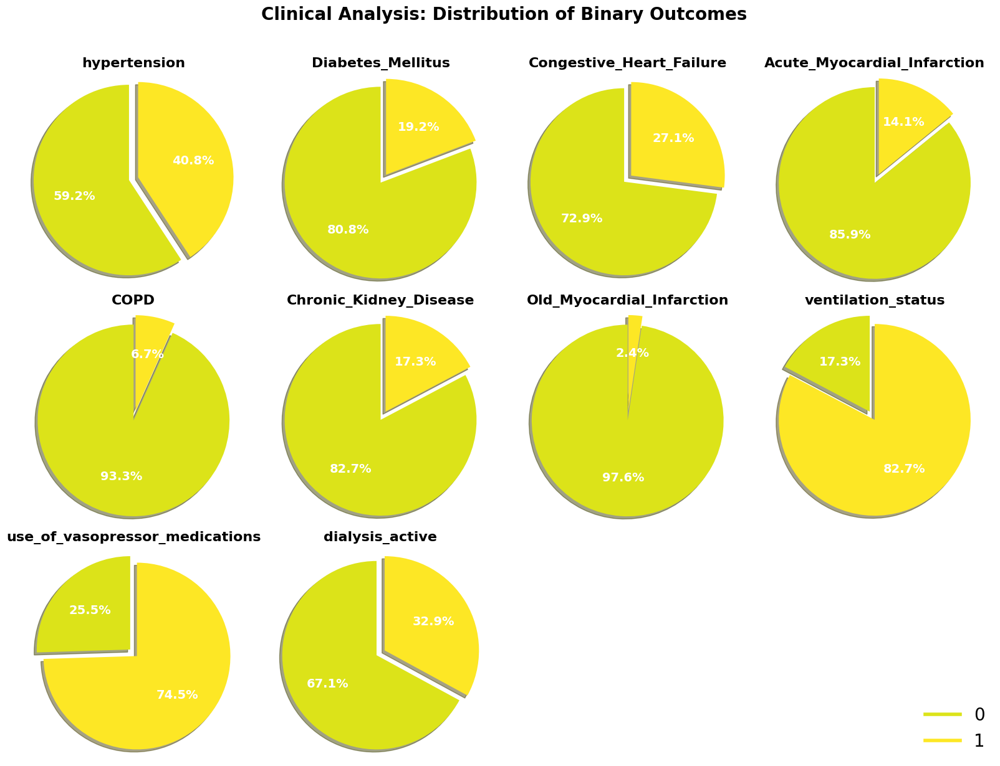

In [152]:
# Function to convert RGB to hexadecimal color code
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

# Define colors for pie charts
color1 = rgb_to_hex([220, 227, 25]) # #482878 for '0'
color2 = rgb_to_hex([253, 231, 37])      # #440154 for '1'

# Custom text properties for pie chart labels
textprops = {'color': 'white', 'fontsize': 14, 'weight': 'bold'}

# Binary columns to plot
binary_columns = ['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure',
                   'Acute_Myocardial_Infarction', 'COPD', 'Chronic_Kidney_Disease',
                   'Old_Myocardial_Infarction', 'ventilation_status',
                   'use_of_vasopressor_medications', 'dialysis_active']

# DataFrame with binary values
binary_data = cluster_data6[binary_columns]

# Get normalized counts of 0 and 1 in each column
binary_counts = binary_data.apply(lambda x: x.value_counts(normalize=True))

# Create a subplot grid with 3 rows and 4 columns
num_columns = len(binary_columns)
num_rows = (num_columns + 3) // 4  # Ceiling division to determine rows
fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(16, 12))
fig.suptitle('Clinical Analysis: Distribution of Binary Outcomes', y=1.02, fontsize=20, fontweight='bold')  # Title with font customization


# Plot pie charts with custom styling
for i, column in enumerate(binary_columns):
    ax = axes[i // 4, i % 4]
    if column in binary_counts.columns:
        explode = [0.1, 0]  # Explode the first slice to add emphasis
        
        binary_counts[column].plot.pie(
            autopct='%1.1f%%', startangle=90, ax=ax, colors=[color1, color2], textprops=textprops, labels=None, explode=explode, shadow=True
        )
        ax.set_title(column, fontsize=16, fontweight='bold')  # Title with bold font
        ax.axis('equal')  # Ensures the pie chart remains circular
        ax.xaxis.set_visible(False)  # Hide x-axis
        ax.yaxis.set_visible(False)  # Hide y-axis
        
        # Set subplot background color

# Hide unused plots if there are extra subplot spaces
if num_columns < axes.size:
    for extra_ax in axes.flatten()[num_columns:]:
        extra_ax.axis("off")  # Hide unused plots

# Add a custom legend indicating which color represents '0' and which represents '1'
legend_handles = [
    plt.Line2D([0], [0], color=color1, lw=4, label='0'),  # Line indicating color for '0'
    plt.Line2D([0], [0], color=color2, lw=4, label='1')   # Line indicating color for '1'
]

# Place the legend in the lower-right corner
fig.legend(handles=legend_handles, loc='lower right', fontsize=20, frameon=False)  # Custom legend

# Adjust layout and display
plt.tight_layout()
plt.show()

<AxesSubplot: >

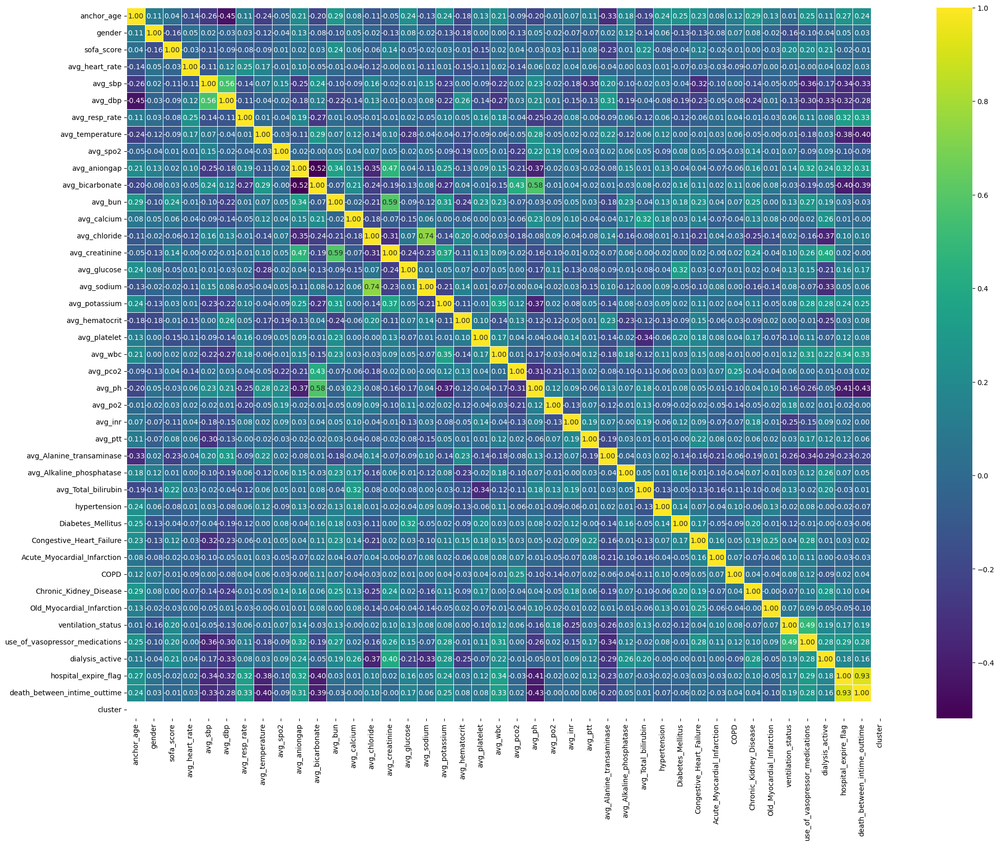

In [47]:
# Calculate correlation matrix
correlation_matrix = cluster_data6.corr()

plt.figure(figsize=(24, 18))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5, annot_kws={"size": 10})

Mortality Rates by Cluster

In [53]:
full_data = pd.concat([cluster_data0, cluster_data1, cluster_data2, cluster_data3, cluster_data4, cluster_data5, cluster_data6])

# Calculate the count of deceased and survived patients per cluster
survival_counts = full_data.groupby(['cluster', 'hospital_expire_flag']).size().unstack(fill_value=0)

# Calculate total patients per cluster
total_patients_per_cluster = full_data.groupby('cluster').size()

# Print the counts of deceased and survived
print("Survival counts in each cluster:")
print(survival_counts)

# Print the total number of patients in each cluster
print("\nTotal number of patients in each cluster:")
print(total_patients_per_cluster)

Survival counts in each cluster:
hospital_expire_flag    0.0   1.0
cluster                          
0                       961   391
1                       272   106
2                     11145  1202
3                      1334   122
4                      1561   242
5                      5200   946
6                       176    79

Total number of patients in each cluster:
cluster
0     1352
1      378
2    12347
3     1456
4     1803
5     6146
6      255
dtype: int64


   Survived  Deceased  Total  Mortality Rate
0       961       391   1352        0.289201
1       272       106    378        0.280423
2     11145      1202  12347        0.097352
3      1334       122   1456        0.083791
4      1561       242   1803        0.134221
5      5200       946   6146        0.153921
6       176        79    255        0.309804

Chi-squared Test:
Chi2 Statistic: 626.3433577117577, p-value: 4.8370040877031797e-132


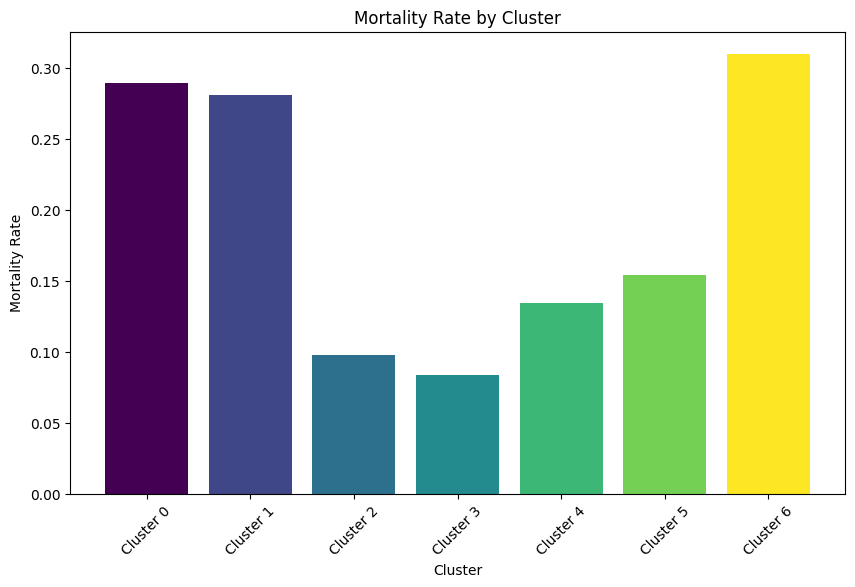

In [55]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats

# Assuming your data is set as follows
data = {
    'Survived': [961, 272, 11145, 1334, 1561, 5200, 176],
    'Deceased': [391, 106, 1202, 122, 242, 946, 79]
}
index = [0, 1, 2, 3, 4, 5, 6]  # Cluster indices
df = pd.DataFrame(data, index=index)

# Add total patients and mortality rate columns
df['Total'] = df['Survived'] + df['Deceased']
df['Mortality Rate'] = df['Deceased'] / df['Total']

# Print the DataFrame with mortality rate
print(df)

# Chi-squared test for independence between cluster and survival outcome
chi2, p, dof, ex = stats.chi2_contingency(df[['Survived', 'Deceased']])

# Results
print(f"\nChi-squared Test:\nChi2 Statistic: {chi2}, p-value: {p}")

# Define custom colors for each cluster
cluster_colors = [
    rgb_to_hex([68, 1, 84]),   # Cluster 0
    rgb_to_hex([64, 71, 136]), # Cluster 1
    rgb_to_hex([45, 112, 142]),# Cluster 2
    rgb_to_hex([35, 138, 141]),# Cluster 3
    rgb_to_hex([60, 183, 117]),# Cluster 4
    rgb_to_hex([115, 208, 85]),# Cluster 5
    rgb_to_hex([253, 231, 37]) # Cluster 6
]

# Visualization of mortality rate with specified colors
plt.figure(figsize=(10, 6))
plt.bar(df.index, df['Mortality Rate'], color=cluster_colors)  # Apply custom colors
plt.title('Mortality Rate by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Mortality Rate')
plt.xticks(ticks=df.index, labels=[f"Cluster {i}" for i in df.index], rotation=45)
plt.show()

### Mortality Rates by Cluster
- **Cluster 0, 1, and 6** exhibit notably higher mortality rates compared to other clusters, with rates of approximately 28.9%, 28.0%, and 31.0% respectively. This suggests that these clusters might be comprised of patients with more severe conditions or risk factors that contribute to higher mortality.
- **Cluster 2 and 3** have the lowest mortality rates, at about 9.7% and 8.4% respectively. This indicates these clusters may consist of patients with less severe illnesses or more effective treatments and interventions.
- **Cluster 4 and 5** display moderate mortality rates, around 13.4% and 15.4%, indicating a middle level of severity or effectiveness in management compared to other clusters.

### Chi-Squared Test Results
- **Chi2 Statistic: 626.343**: This value is quite high, which suggests a strong association between the clusters and mortality outcomes.
- **p-value: ~0 (4.837e-132)**: This extremely low p-value indicates that the differences in mortality rates across clusters are statistically significant, rejecting the null hypothesis that there's no association between cluster membership and mortality rates.

### Interpretations and Implications
1. **Risk Stratification**: Clusters 0, 1, and 6 should be considered high-risk categories due to their higher mortality rates. Medical staff should prioritize monitoring and intensive care for patients in these clusters, possibly adjusting treatment protocols to address the higher risk.
2. **Resource Allocation**: Hospitals and healthcare providers can use these insights for better resource allocation, ensuring that high-risk clusters receive more attention and resources, such as staffing, ICU beds, and specialized treatments.
3. **Further Analysis and Investigation**: 
   - **For high mortality clusters (0, 1, 6)**: It's essential to investigate the common characteristics or conditions prevalent in these clusters that might contribute to higher mortality. Understanding these could help in formulating targeted interventions to reduce mortality rates.
   - **For low mortality clusters (2, 3)**: Identifying effective treatments or management strategies in these clusters could provide valuable lessons that can be applied to other clusters to improve outcomes.

 This code concatenates all cluster DataFrames into one and creates a violin plot to visualize the distribution of the sofa_score', 'avg_heart_rate', 'avg_sbp',
       'avg_dbp', 'avg_mbp', 'avg_resp_rate', 'avg_temperature', 'avg_spo2',
       'avg_aniongap', 'avg_bicarbonate', 'avg_bun', 'avg_calcium',
       'avg_chloride', 'avg_creatinine', 'avg_glucose', 'avg_sodium',
       'avg_potassium', 'avg_hematocrit', 'avg_hemoglobin', 'avg_platelet',
       'avg_wbc', 'avg_pco2', 'avg_ph', 'avg_po2', 'avg_inr', 'avg_pt',
       'avg_ptt', 'avg_Alanine_transaminase', 'avg_Alkaline_phosphatase',
       'avg_Aspartate_transaminase', 'avg_Total_bilirubin' 
 across clusters. Each cluster is represented by a different color, creating a distinct visual representation for each cluster's distribution.

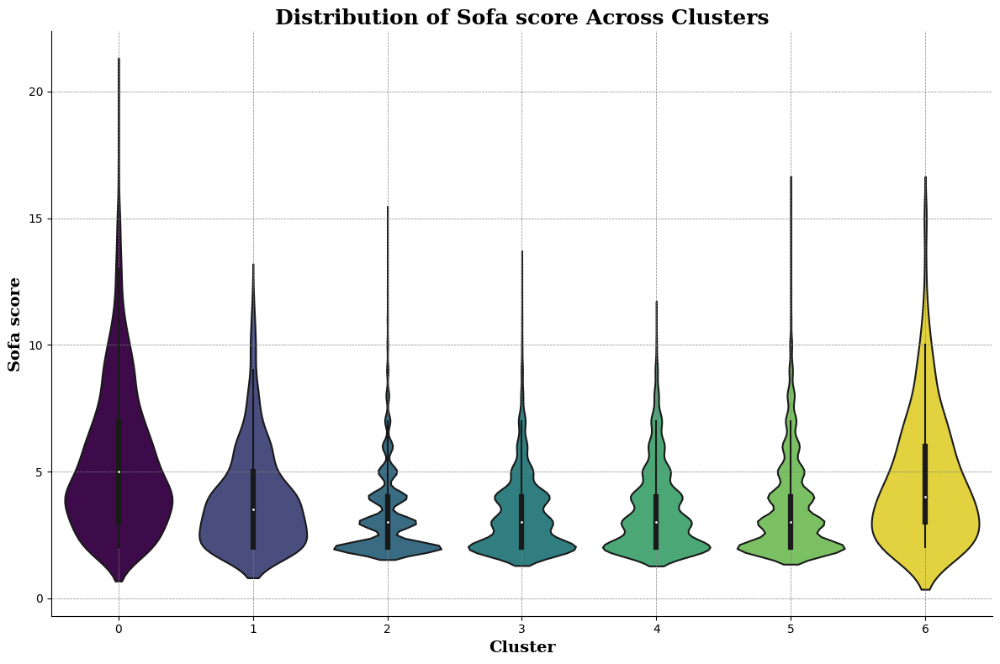

In [162]:
# Combine all cluster DataFrames into one
full_data = pd.concat([cluster_data0, cluster_data1, cluster_data2, cluster_data3, cluster_data4, cluster_data5, cluster_data6])

# Custom color palette for each cluster
def rgb_to_hex(rgb):
    return '#' + ''.join(f'{c:02x}' for c in rgb)

cluster_colors = [
    rgb_to_hex([68, 1, 84]),   # Cluster 0
    rgb_to_hex([64, 71, 136]), # Cluster 1
    rgb_to_hex([45, 112, 142]),# Cluster 2
    rgb_to_hex([35, 138, 141]),# Cluster 3
    rgb_to_hex([60, 183, 117]),# Cluster 4
    rgb_to_hex([115, 208, 85]),# Cluster 5
    rgb_to_hex([253, 231, 37]) # Cluster 6
]

# Create the violin plot for 'sofa_score' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='sofa_score', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Sofa score Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Sofa score', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

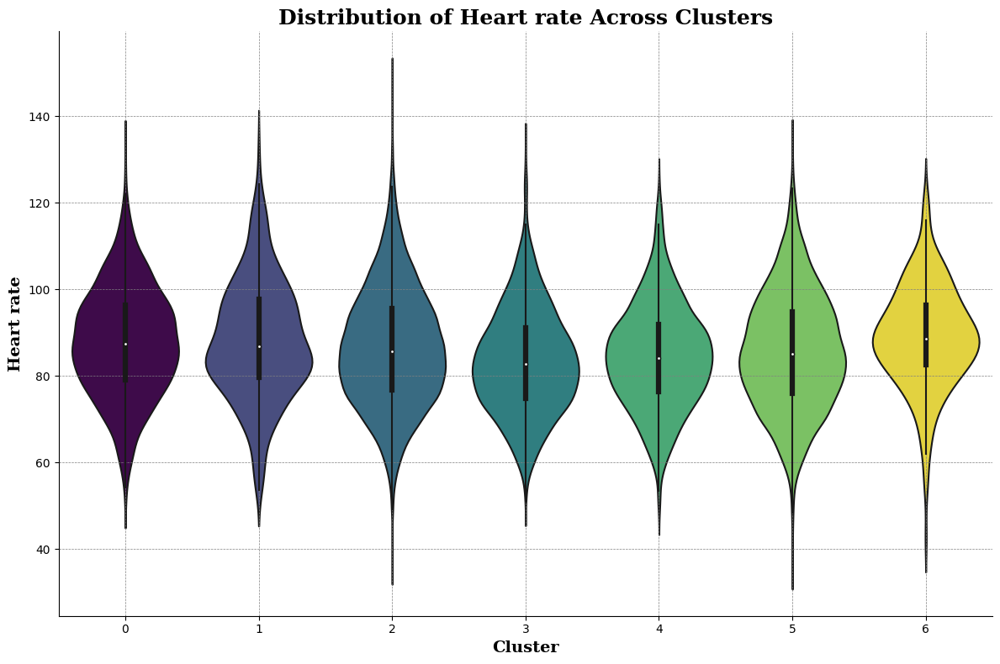

In [160]:
# Create the violin plot for 'avg_heart_rate' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_heart_rate', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Heart rate Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Heart rate', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

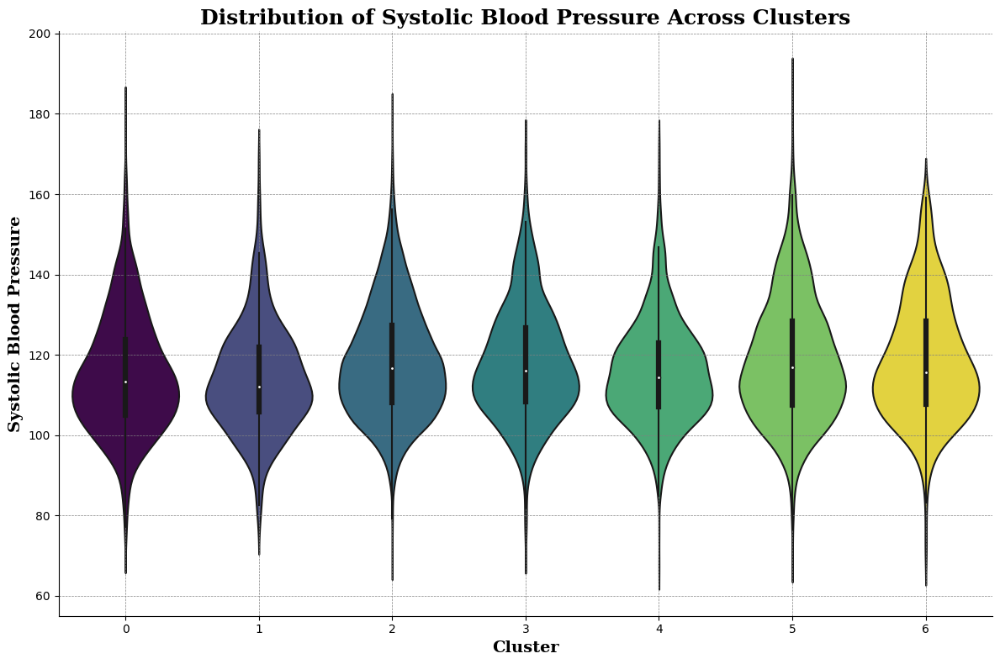

In [163]:
# Create the violin plot for 'avg_sbp' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_sbp', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Systolic Blood Pressure Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Systolic Blood Pressure', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

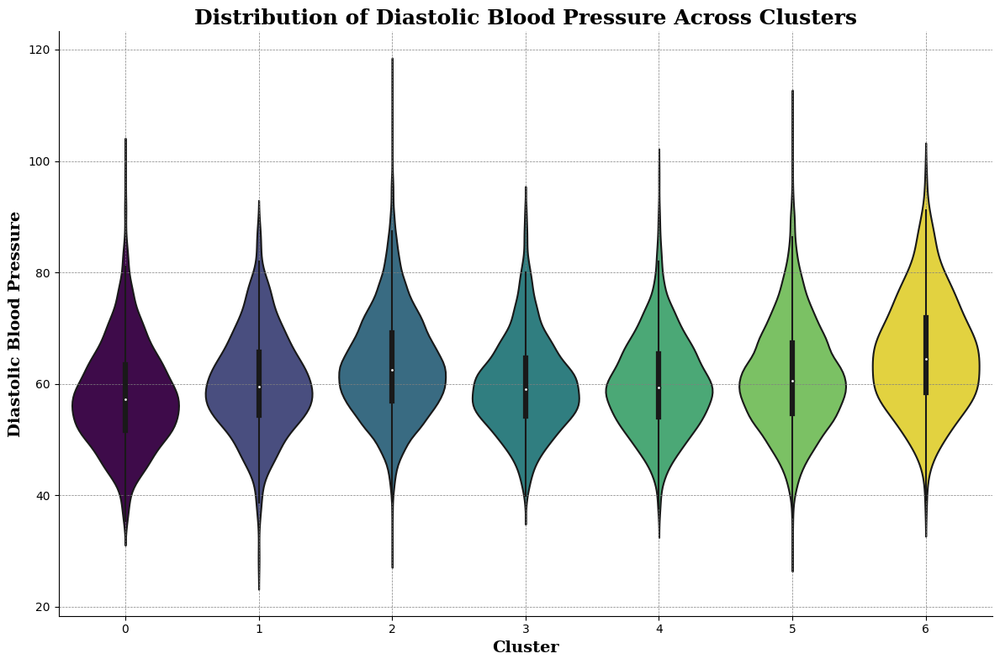

In [164]:
# Create the violin plot for 'avg_dbp' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_dbp', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Diastolic Blood Pressure Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Diastolic Blood Pressure', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

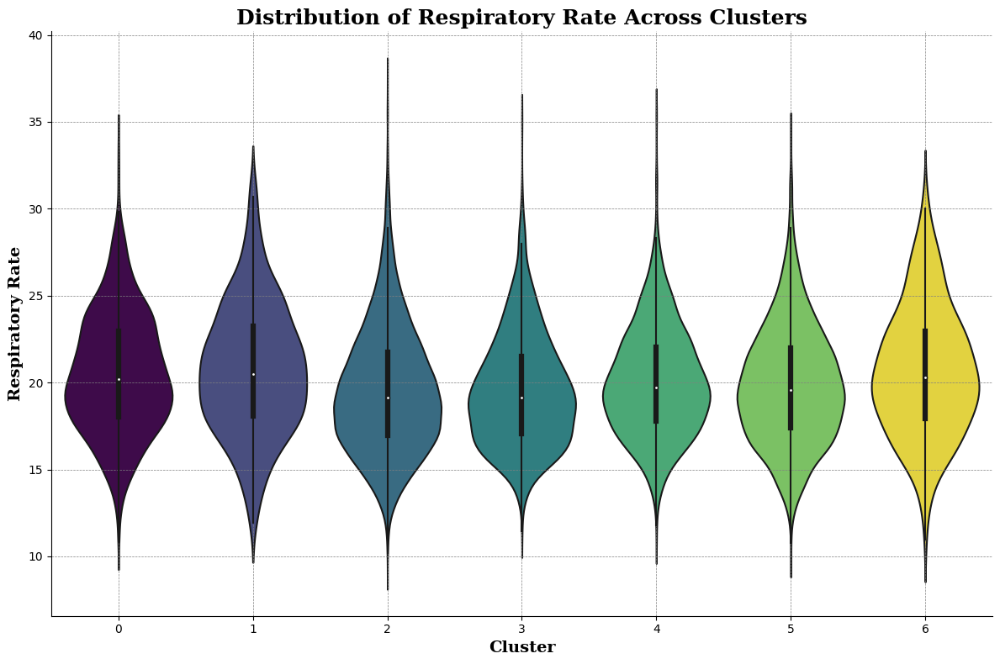

In [168]:
# Create the violin plot for 'avg_resp_rate' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_resp_rate', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Respiratory Rate Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Respiratory Rate', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

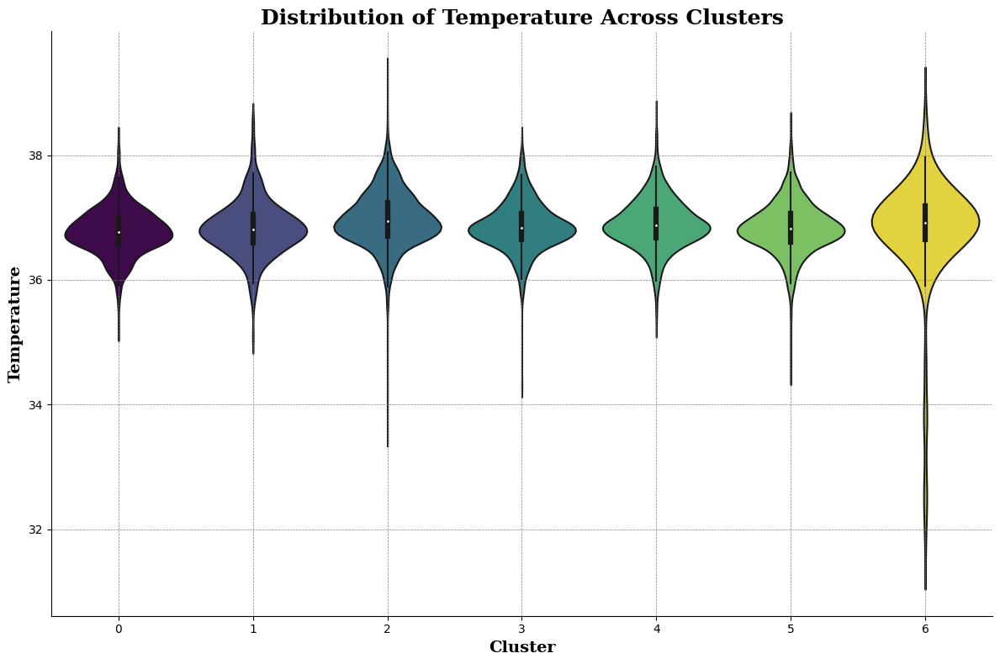

In [169]:
# Create the violin plot for 'avg_temperature' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_temperature', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Temperature Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Temperature', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

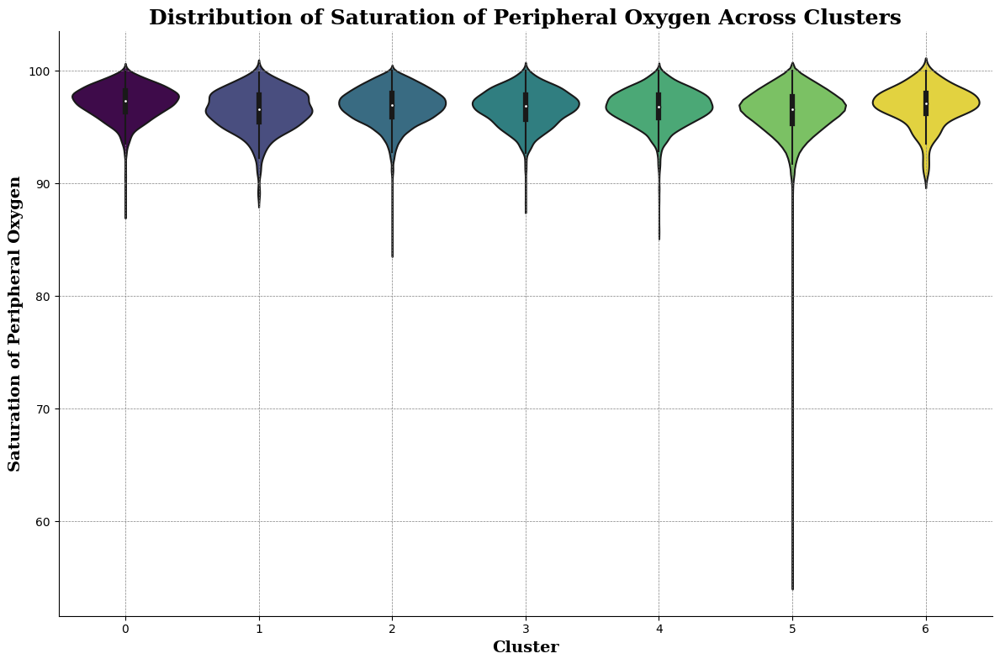

In [170]:
# Create the violin plot for 'avg_spo2' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_spo2', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Saturation of Peripheral Oxygen Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Saturation of Peripheral Oxygen', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

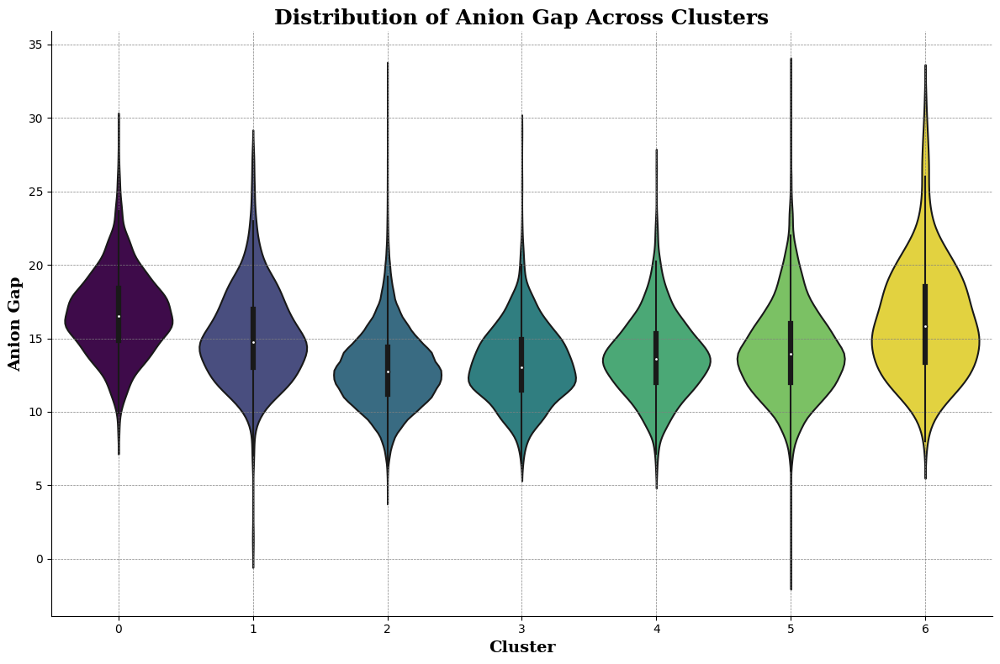

In [171]:
# Create the violin plot for 'avg_aniongap' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_aniongap', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Anion Gap Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Anion Gap', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

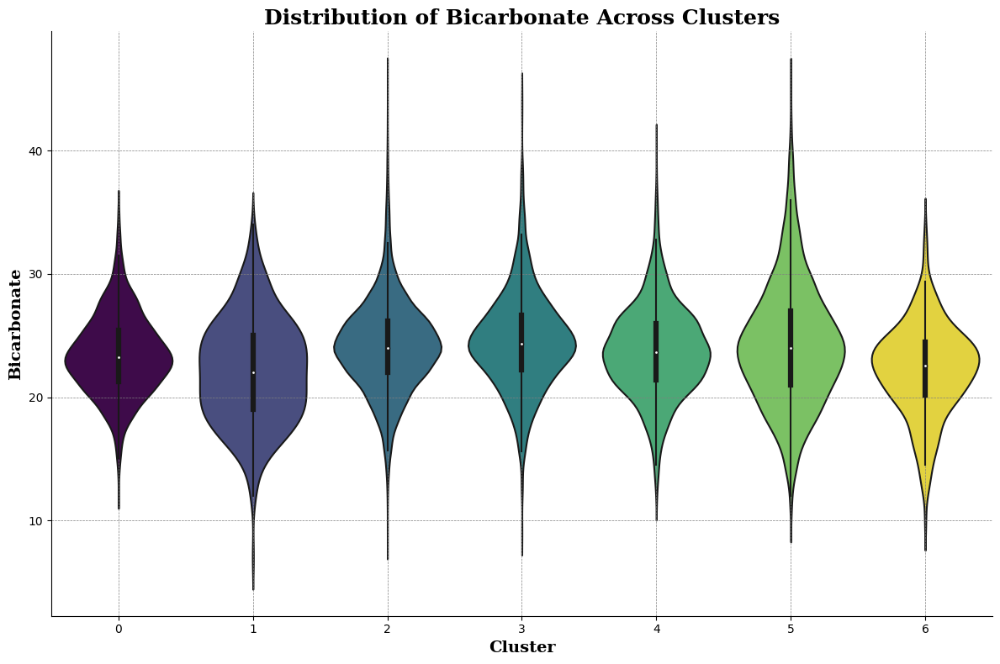

In [172]:
# Create the violin plot for 'avg_bicarbonate' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_bicarbonate', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Bicarbonate Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Bicarbonate', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

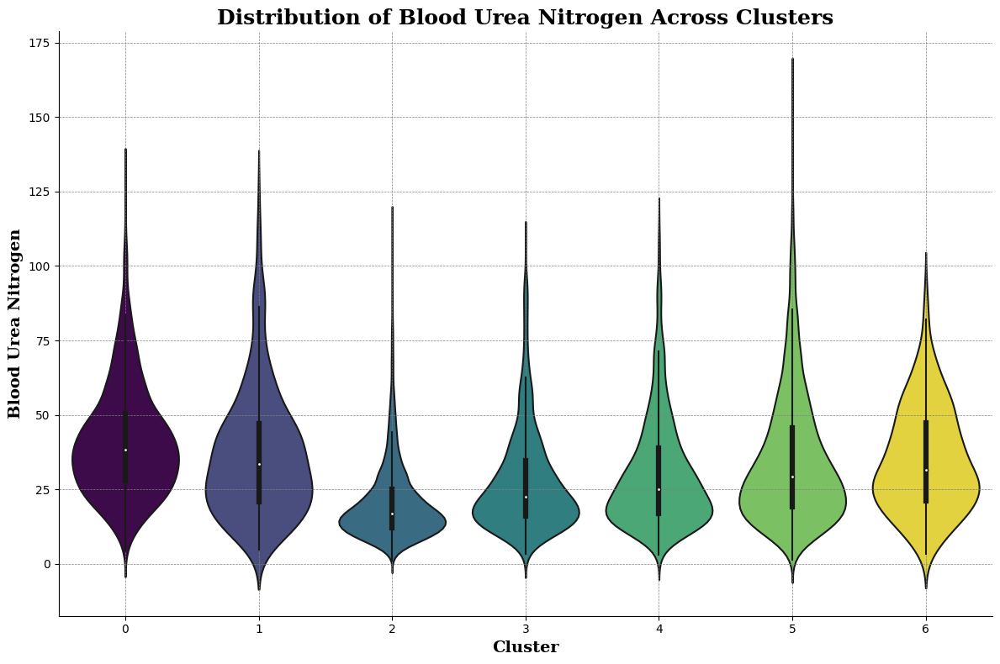

In [173]:
# Create the violin plot for 'avg_bun' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_bun', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Blood Urea Nitrogen Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Blood Urea Nitrogen', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

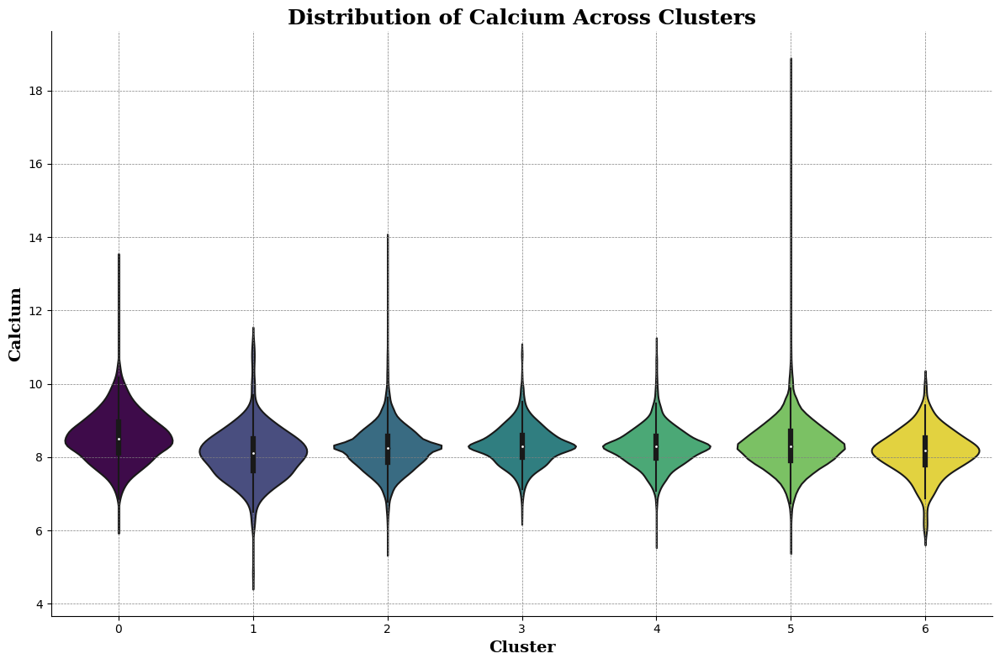

In [174]:
# Create the violin plot for 'avg_calcium' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_calcium', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Calcium Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Calcium', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

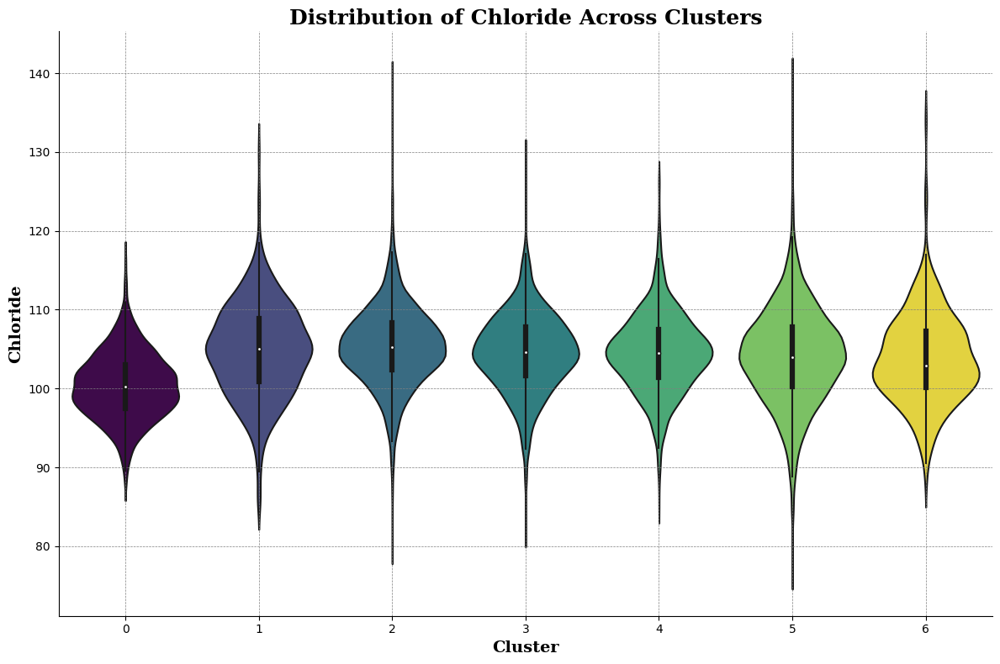

In [175]:
# Create the violin plot for 'avg_chloride' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_chloride', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Chloride Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Chloride', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

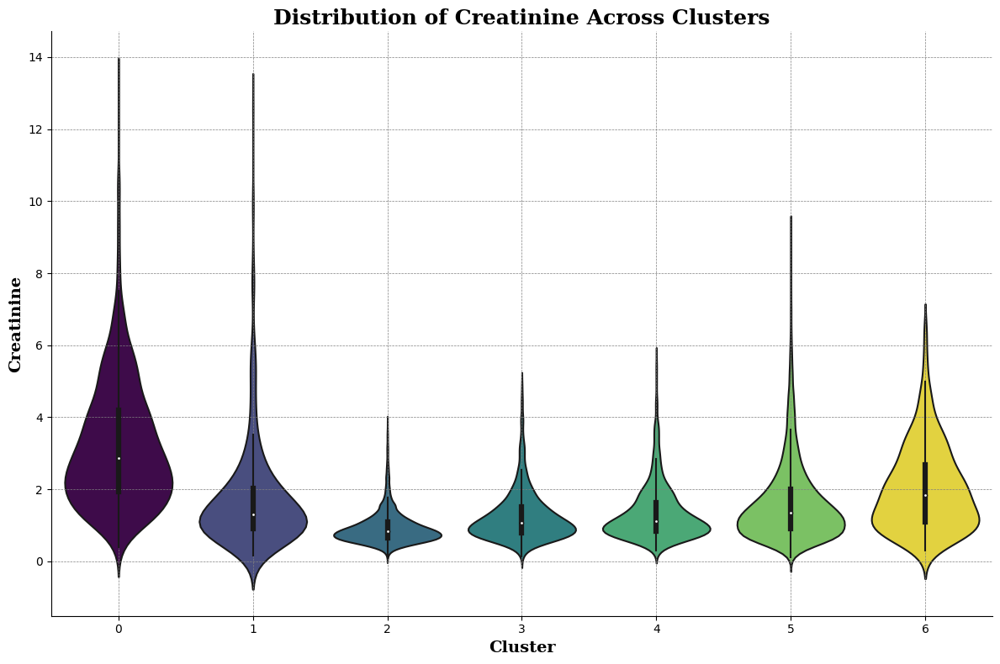

In [176]:
# Create the violin plot for 'avg_creatinine' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_creatinine', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Creatinine Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Creatinine', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

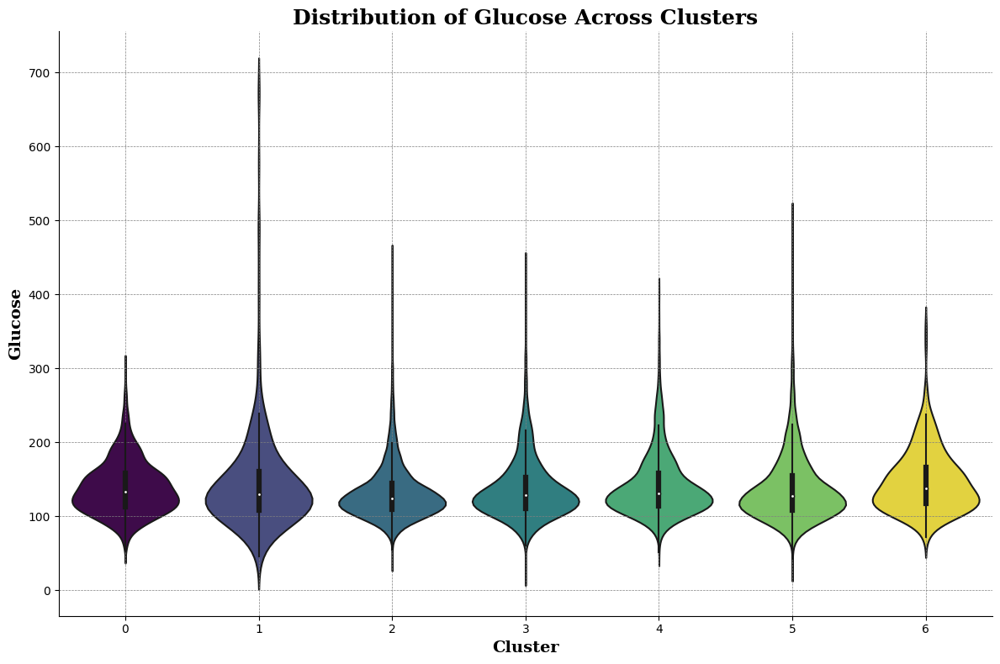

In [177]:
# Create the violin plot for 'avg_glucose' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_glucose', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Glucose Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Glucose', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

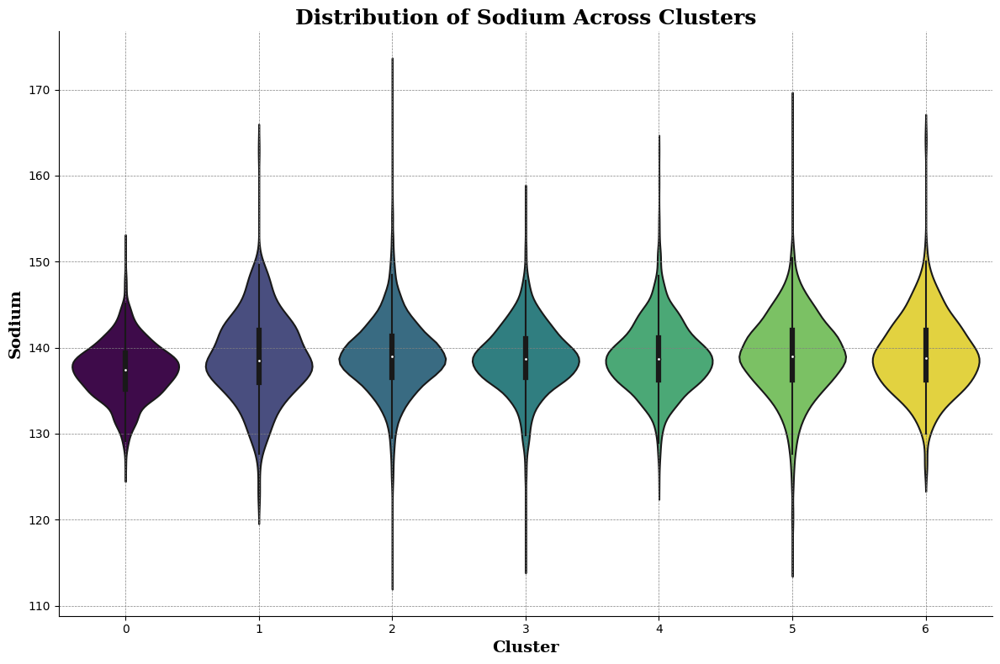

In [178]:
# Create the violin plot for 'avg_sodium' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_sodium', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Sodium Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Sodium', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

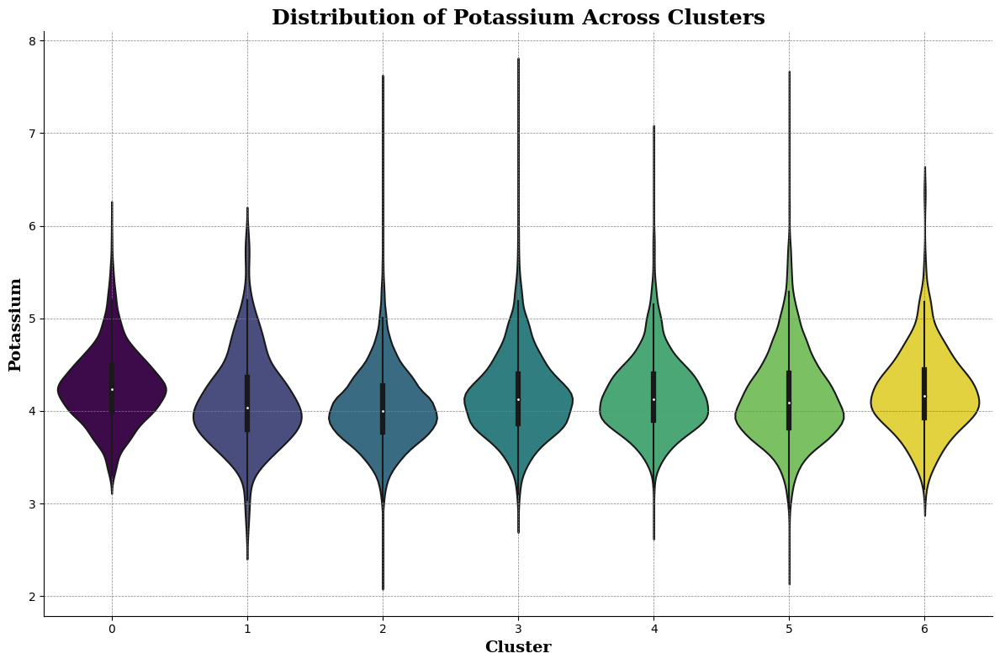

In [179]:
# Create the violin plot for 'avg_potassium' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_potassium', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Potassium Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Potassium', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

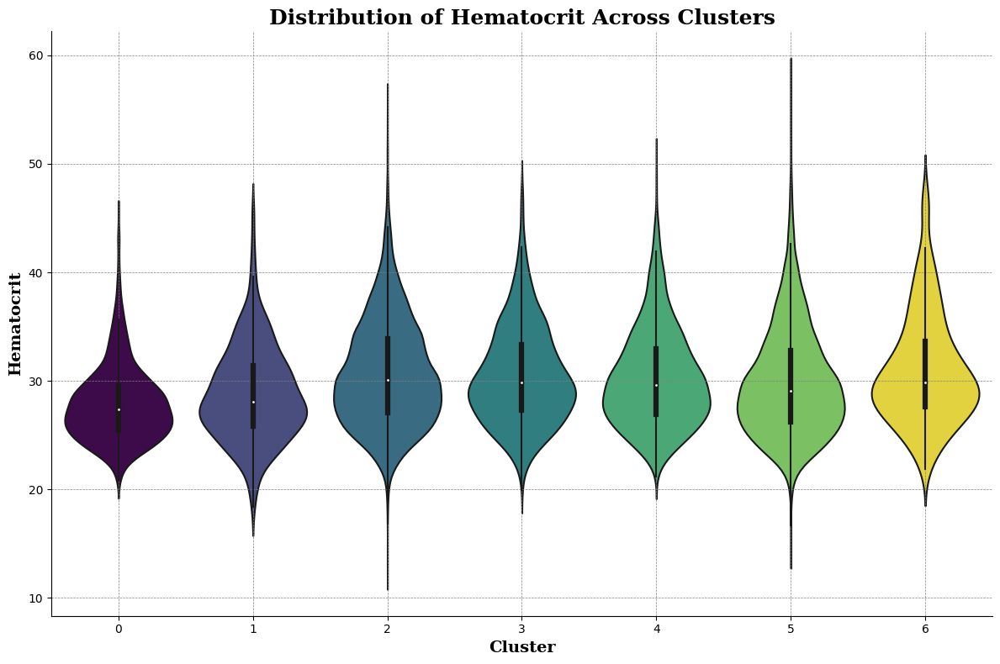

In [180]:
# Create the violin plot for 'avg_hematocrit' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_hematocrit', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Hematocrit Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Hematocrit', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

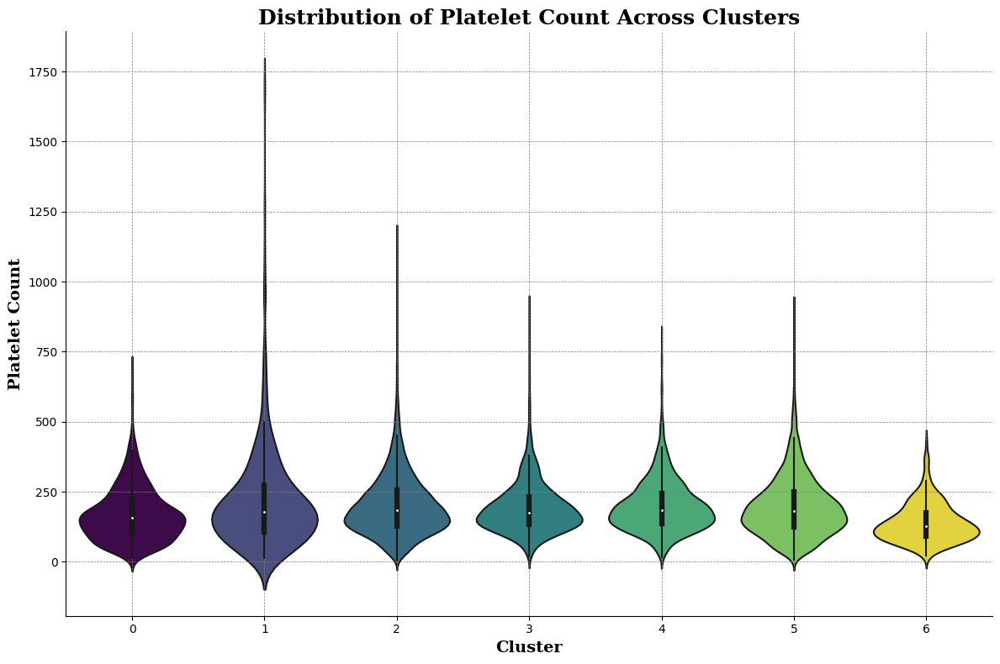

In [182]:
# Create the violin plot for 'avg_platelet' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_platelet', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Platelet Count Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Platelet Count', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

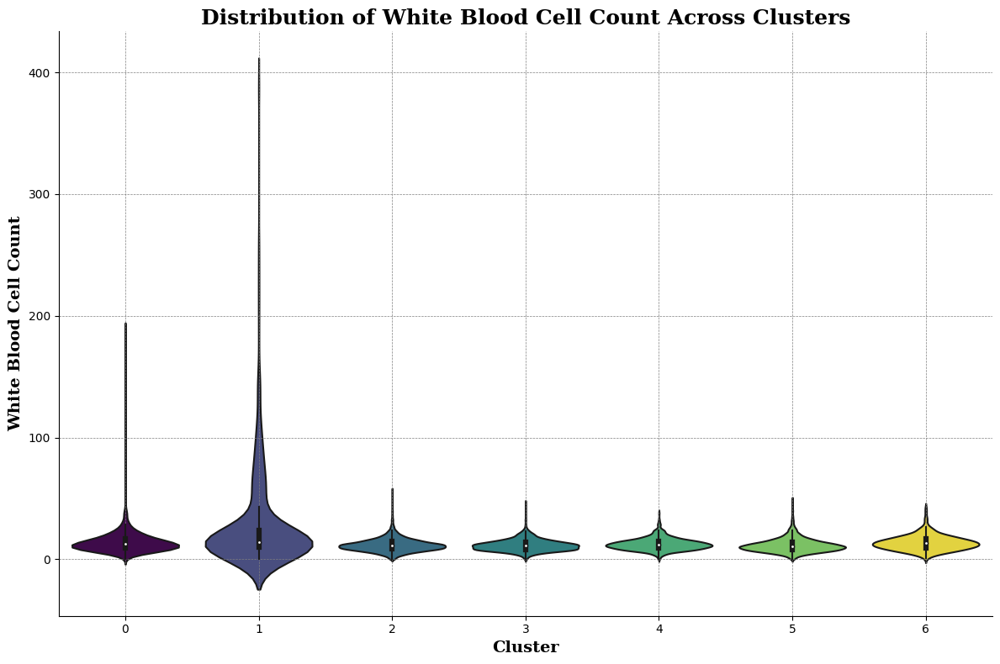

In [183]:
# Create the violin plot for 'avg_wbc' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_wbc', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of White Blood Cell Count Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('White Blood Cell Count', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

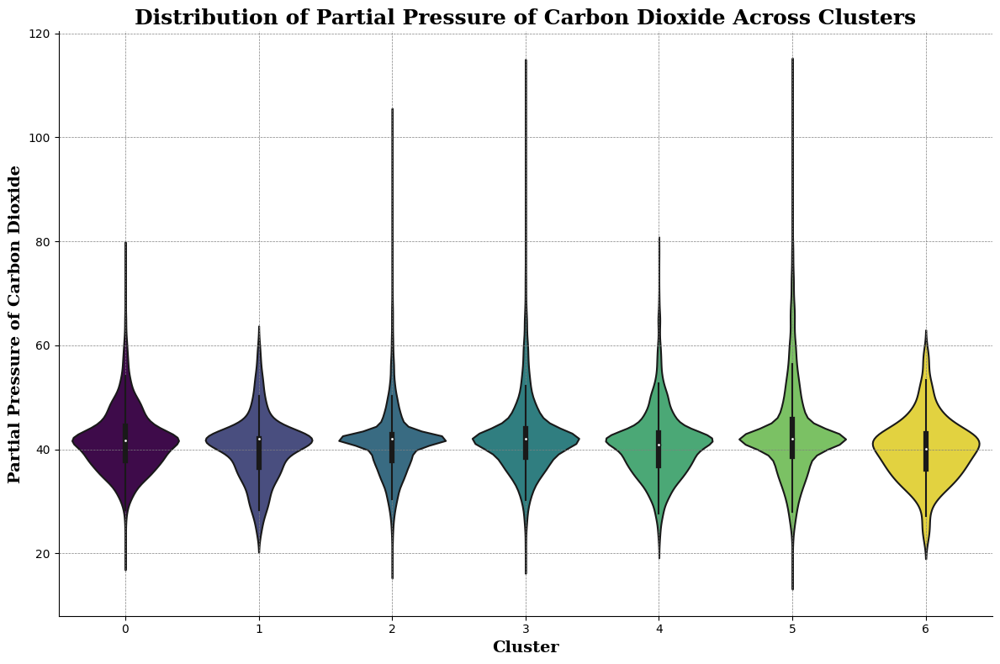

In [184]:
# Create the violin plot for 'avg_pco2' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_pco2', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Partial Pressure of Carbon Dioxide Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Partial Pressure of Carbon Dioxide', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

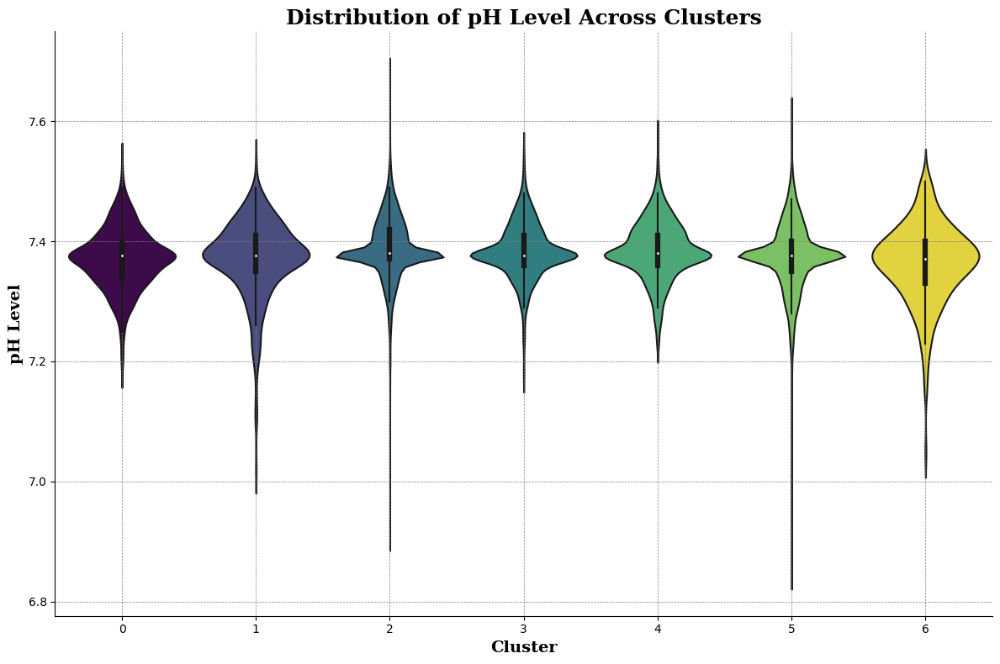

In [185]:
# Create the violin plot for 'avg_ph' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_ph', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of pH Level Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('pH Level', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

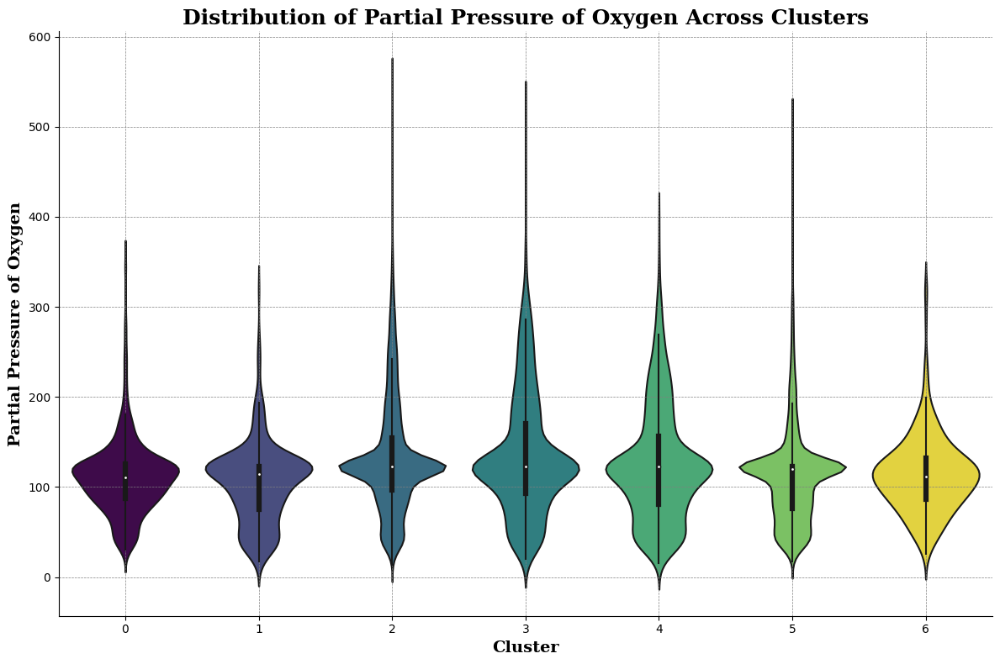

In [186]:
# Create the violin plot for 'avg_po2' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_po2', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Partial Pressure of Oxygen Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Partial Pressure of Oxygen', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

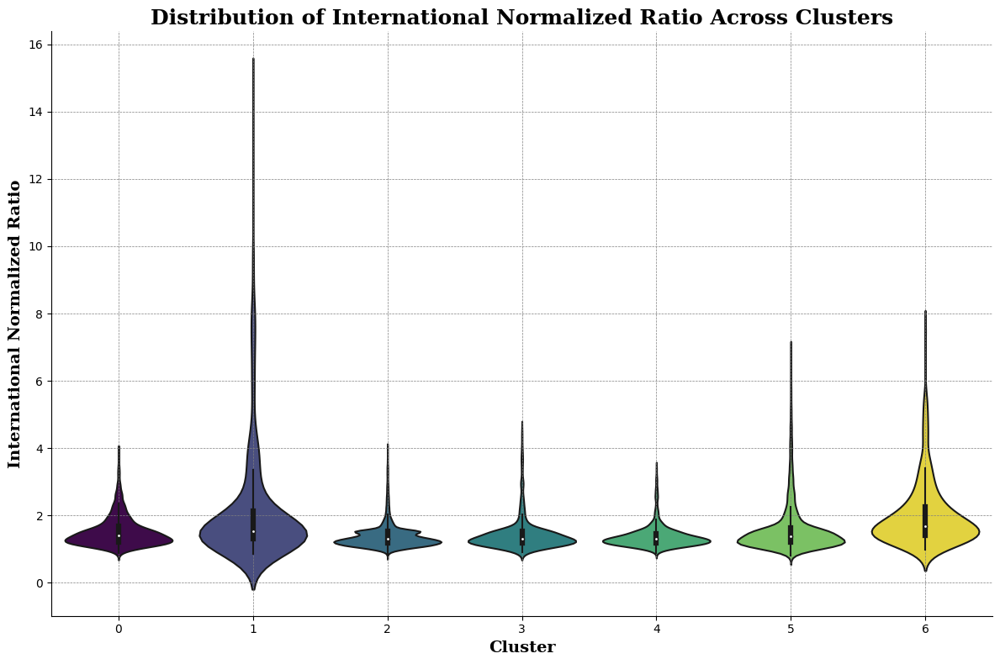

In [187]:
# Create the violin plot for 'avg_inr' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_inr', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of International Normalized Ratio Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('International Normalized Ratio', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

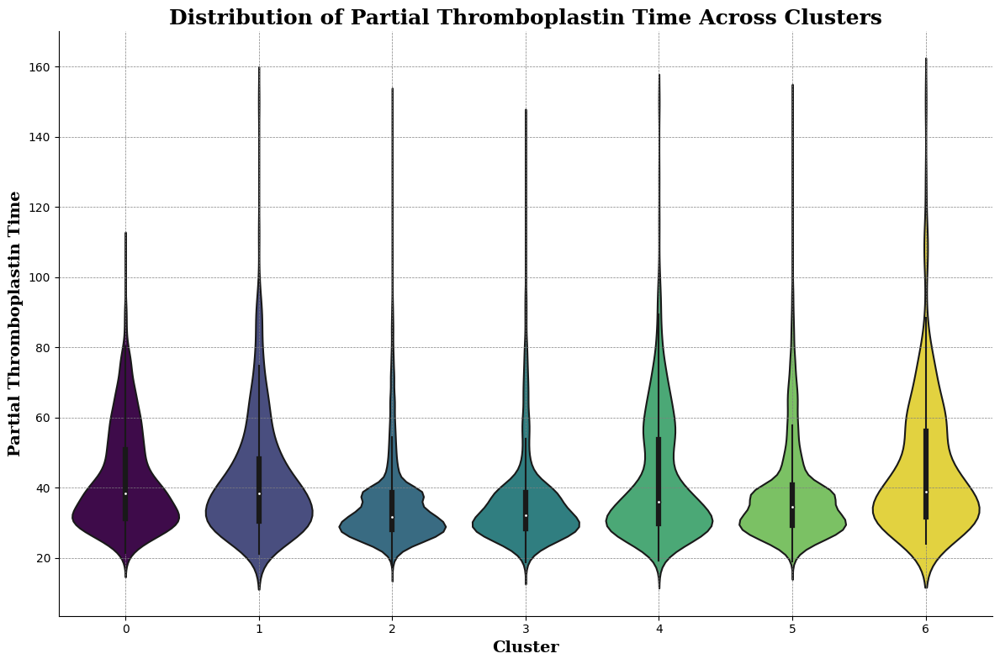

In [189]:
# Create the violin plot for 'avg_ptt' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_ptt', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Partial Thromboplastin Time Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Partial Thromboplastin Time', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

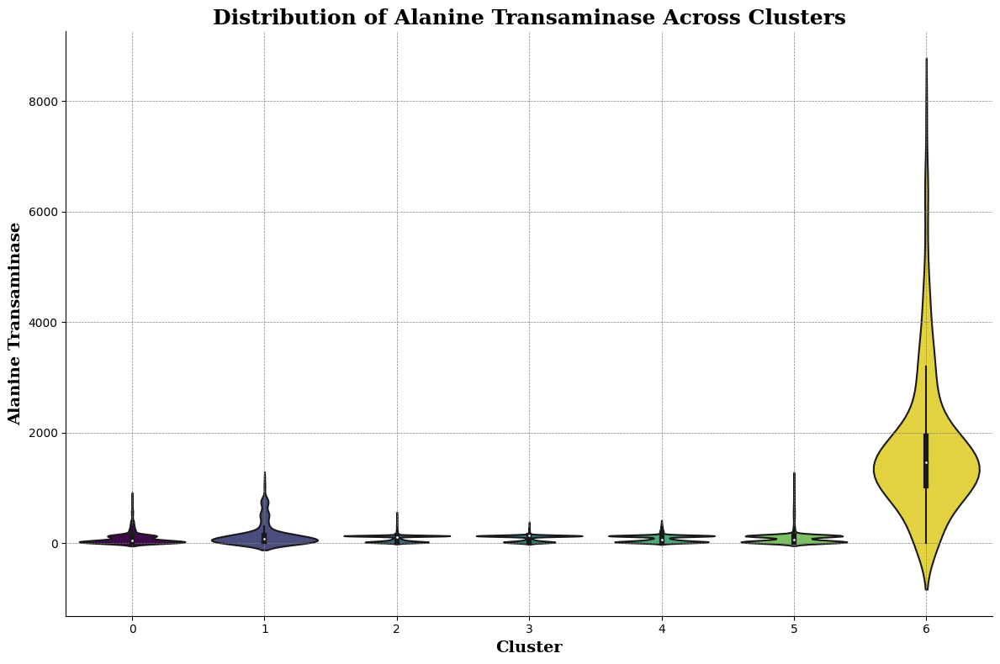

In [191]:
# Create the violin plot for 'avg_Alanine_transaminase' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_Alanine_transaminase', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Alanine Transaminase Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Alanine Transaminase', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

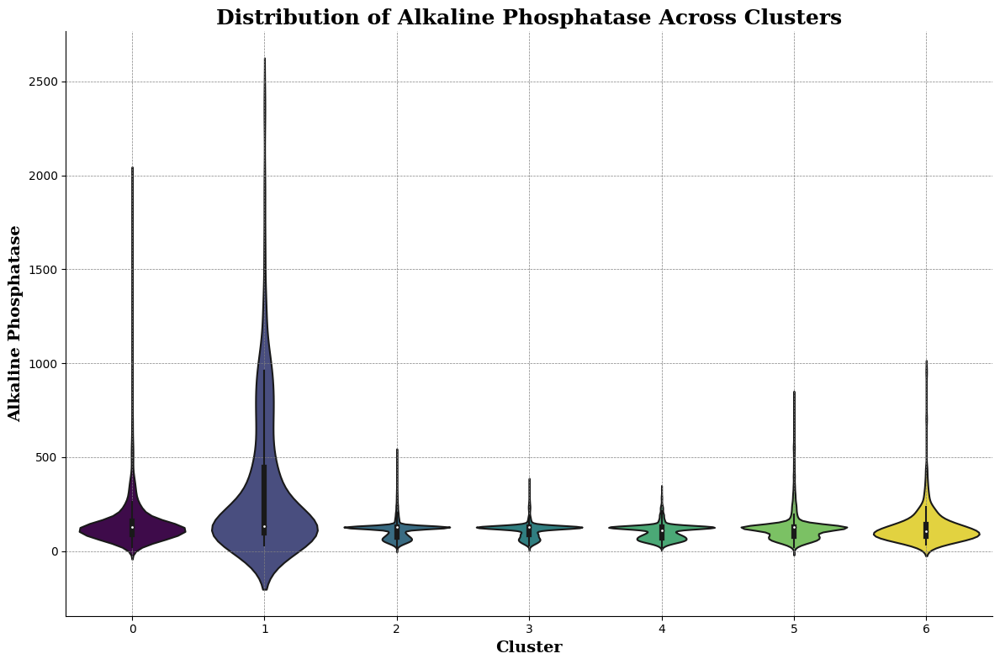

In [193]:
# Create the violin plot for 'avg_Alkaline_phosphatase' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_Alkaline_phosphatase', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of Alkaline Phosphatase Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('Alkaline Phosphatase', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

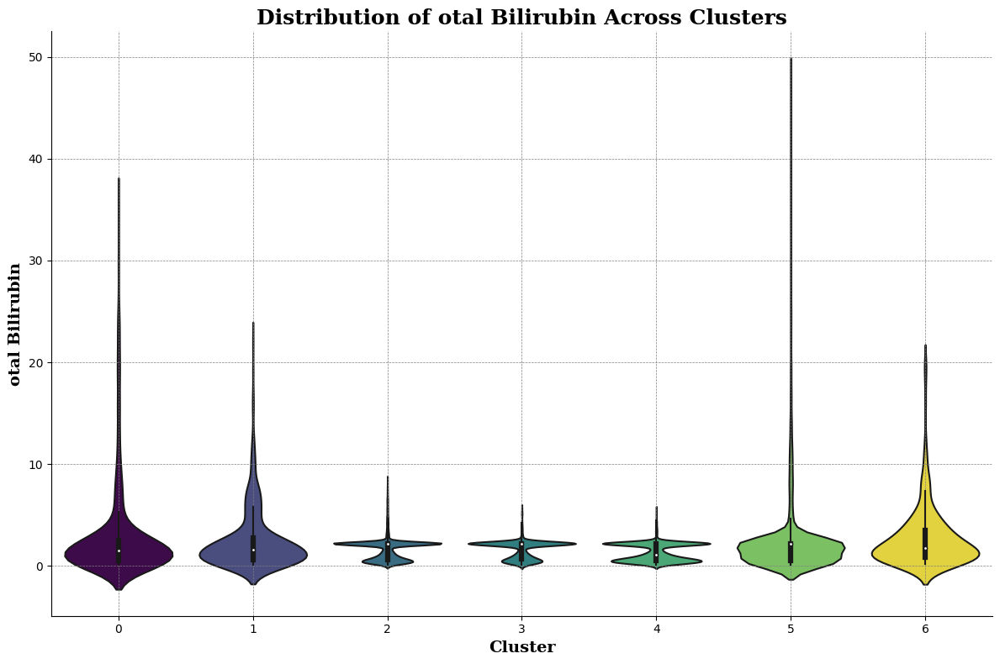

In [195]:
# Create the violin plot for 'avg_Total_bilirubin' across clusters
plt.figure(figsize=(12, 8))

sns.violinplot(x='cluster', y='avg_Total_bilirubin', data=full_data, palette=cluster_colors, scale='width')

# Set the plot title with customized font and styling
plt.title('Distribution of otal Bilirubin Across Clusters', fontsize=18, fontweight='bold', family='serif')

# Customize x-axis and y-axis labels
plt.xlabel('Cluster', fontsize=14, fontweight='bold', family='serif')
plt.ylabel('otal Bilirubin', fontsize=14, fontweight='bold', family='serif')

# Add gridlines and hide unnecessary spines
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

# Adjust layout and display
plt.tight_layout()
plt.show()

In [36]:
cluster_data0.columns

Index(['anchor_age', 'gender', 'sofa_score', 'avg_heart_rate', 'avg_sbp',
       'avg_dbp', 'avg_resp_rate', 'avg_temperature', 'avg_spo2',
       'avg_aniongap', 'avg_bicarbonate', 'avg_bun', 'avg_calcium',
       'avg_chloride', 'avg_creatinine', 'avg_glucose', 'avg_sodium',
       'avg_potassium', 'avg_hematocrit', 'avg_platelet', 'avg_wbc',
       'avg_pco2', 'avg_ph', 'avg_po2', 'avg_inr', 'avg_ptt',
       'avg_Alanine_transaminase', 'avg_Alkaline_phosphatase',
       'avg_Total_bilirubin', 'hypertension', 'Diabetes_Mellitus',
       'Congestive_Heart_Failure', 'Acute_Myocardial_Infarction', 'COPD',
       'Chronic_Kidney_Disease', 'Old_Myocardial_Infarction',
       'ventilation_status', 'use_of_vasopressor_medications',
       'dialysis_active', 'hospital_expire_flag',
       'death_between_intime_outtime', 'cluster'],
      dtype='object')

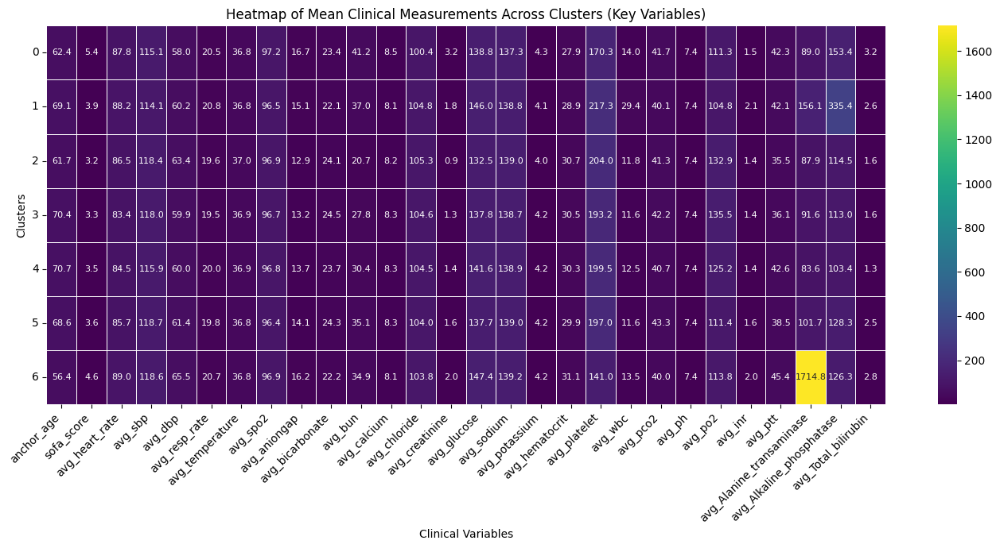

In [38]:
# Load cluster data
cluster_data = [
    pd.read_csv('cluster_0_data.csv'),
    pd.read_csv('cluster_1_data.csv'),
    pd.read_csv('cluster_2_data.csv'),
    pd.read_csv('cluster_3_data.csv'),
    pd.read_csv('cluster_4_data.csv'),
    pd.read_csv('cluster_5_data.csv'),
    pd.read_csv('cluster_6_data.csv')
]

# Concatenate all cluster data into a single DataFrame
combined_data = pd.concat(cluster_data, ignore_index=True)

# Define key variables for which to calculate means
key_variables = [
    'anchor_age', 'sofa_score', 'avg_heart_rate', 'avg_sbp', 'avg_dbp', 'avg_resp_rate', 
    'avg_temperature', 'avg_spo2', 'avg_aniongap', 'avg_bicarbonate', 'avg_bun', 'avg_calcium', 
    'avg_chloride', 'avg_creatinine', 'avg_glucose', 'avg_sodium', 'avg_potassium', 
    'avg_hematocrit', 'avg_platelet', 'avg_wbc', 'avg_pco2', 'avg_ph', 'avg_po2', 
    'avg_inr', 'avg_ptt', 'avg_Alanine_transaminase', 'avg_Alkaline_phosphatase', 
    'avg_Total_bilirubin'
]

# Group by cluster and calculate the mean for key variables
cluster_means = combined_data.groupby('cluster')[key_variables].mean()

# Generate heatmap
plt.figure(figsize=(14, 7))
sns.heatmap(cluster_means, annot=True, fmt=".1f", cmap="viridis", linewidths=.5, annot_kws={"size": 8})
plt.title('Heatmap of Mean Clinical Measurements Across Clusters (Key Variables)')
plt.xlabel('Clinical Variables')
plt.ylabel('Clusters')

# Adjust visibility settings
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.yticks(rotation=0, fontsize=10)

plt.tight_layout()
plt.show()


### Analyzing the Heatmap

1. **Overall Observations**:
   - Each row corresponds to a different cluster of patients.
   - Each column represents a specific clinical variable (e.g., avg heart rate, avg SBP, avg DBP, avg temperature, etc.).
   - The color gradient from dark purple to yellow reflects the range of values, with yellow highlighting particularly high values.

2. **Detailed Analysis by Cluster**:
   - **Cluster 0**: Shows relatively moderate values across most clinical variables, suggesting a baseline or standard patient group without extreme complications.
   - **Cluster 1**: Characterized by some elevated values in avg creatinine and avg Alkaline_phosphatase, indicating possible renal stress and liver function anomalies.
   - **Cluster 2**: Notable for high avg glucose and avg pco2, which may point towards metabolic issues and respiratory distress.
   - **Cluster 3**: Features higher avg BUN and avg creatinine levels, highlighting potential renal issues.
   - **Cluster 4**: Has elevated avg Alkaline_phosphatase, which could suggest liver involvement.
   - **Cluster 5**: Displays significant elevations in avg Alkaline_phosphatase and avg Total_bilirubin, suggesting pronounced liver dysfunction.
   - **Cluster 6**: Shows relatively lower values across many parameters but has a noticeable spike in avg Total_bilirubin.

3. **Specific High-Risk Indicators**:
   - High avg Total_bilirubin in Cluster 6 and avg Alkaline_phosphatase in Cluster 5 are critical, as these suggest severe liver impairment.
   - Elevated avg creatinine and avg BUN in Clusters 3 and 1 indicate kidney function concerns.

4. **Potential Interventions Based on Cluster Analysis**:
   - **Renal Concerns**: Clusters with high renal markers (e.g., Clusters 3 and 1) might benefit from nephrology consults and potentially preemptive dialysis considerations.
   - **Liver Dysfunction**: Clusters 5 and 6, with marked liver test abnormalities, may need hepatology involvement and monitoring for complications like hepatic encephalopathy.
   - **Metabolic and Respiratory Management**: Cluster 2, showing metabolic disturbances and elevated pCO2, should be managed for potential diabetic complications and respiratory support.



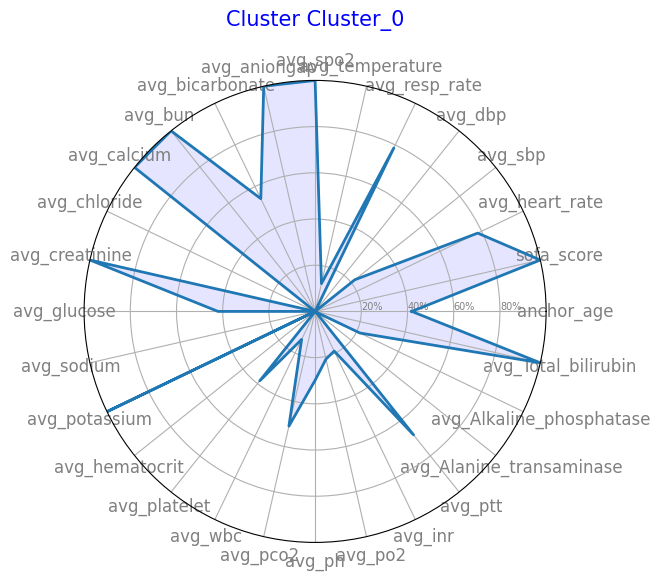

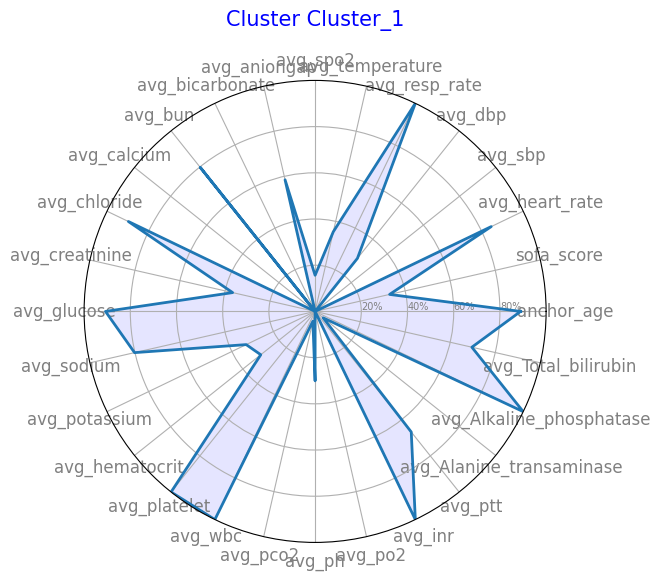

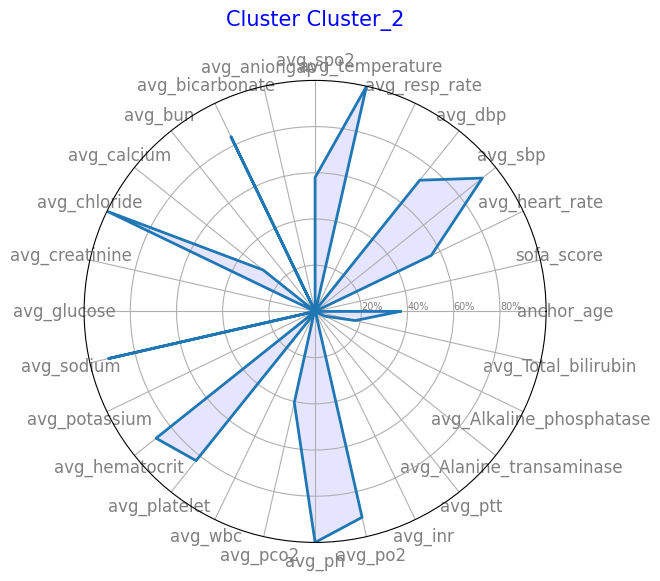

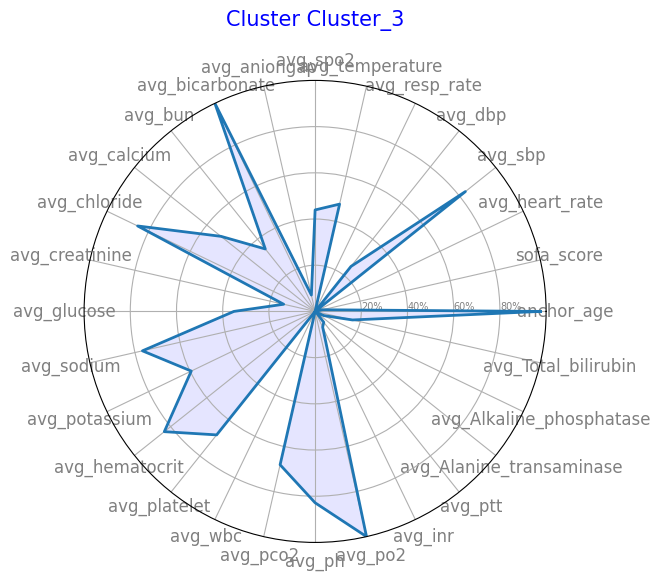

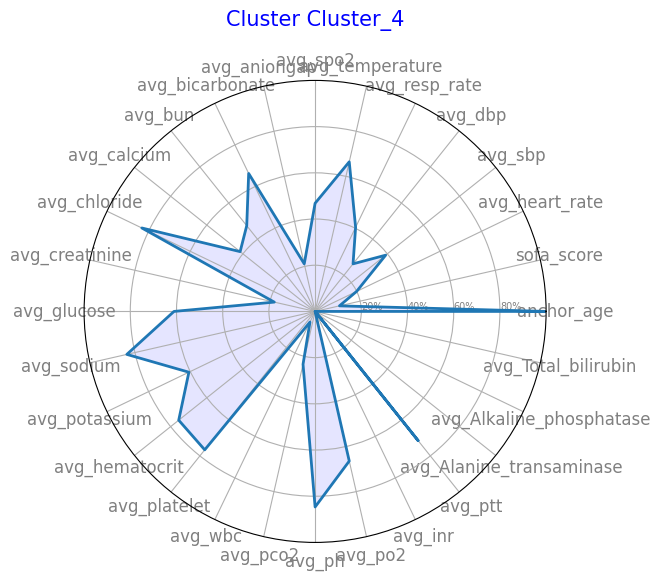

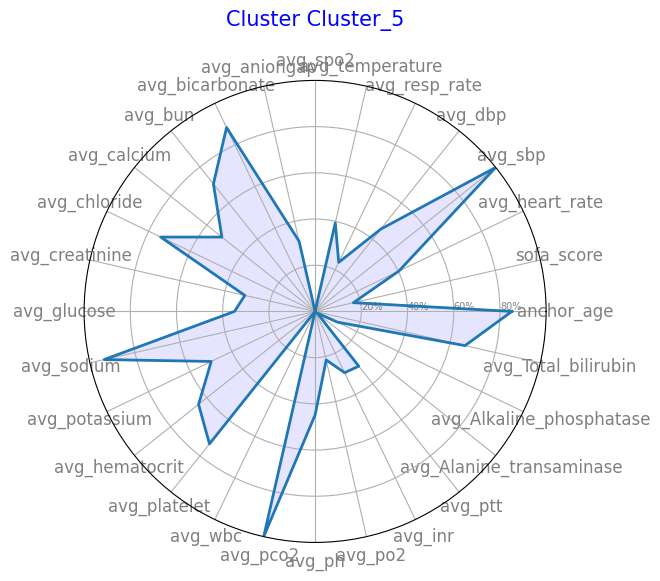

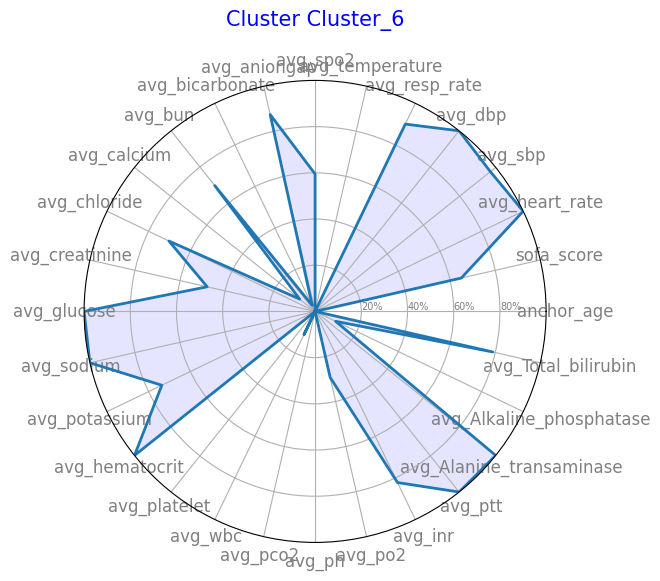

In [57]:
# Function to create radar chart
def make_radar_chart(name, stats, feature_names, num_vars):
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]  # complete the loop

    # Setup radar chart
    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    plt.xticks(angles[:-1], feature_names, color='grey', size=12)

    ax.set_rlabel_position(0)
    plt.yticks([0.2, 0.4, 0.6, 0.8], ["20%", "40%", "60%", "80%"], color="grey", size=7)
    plt.ylim(0, 1)

    stats += stats[:1]
    ax.plot(angles, stats, linewidth=2, linestyle='solid', label=name)
    ax.fill(angles, stats, 'b', alpha=0.1)

    plt.title(name, size=15, color='blue', y=1.1)

# Assuming normalized_cluster_means contains normalized data for each cluster
num_vars = len(normalized_cluster_means.columns)
feature_names = normalized_cluster_means.columns.tolist()

# Generate radar charts for all clusters
for index, row in normalized_cluster_means.iterrows():
    make_radar_chart(f"Cluster {index}", row.tolist(), feature_names, num_vars)
    plt.show()


Based on the radar charts you provided, here's a detailed interpretation for each cluster, focusing on prominent clinical features highlighted by the charts:

### Cluster 0
- **General Observations**: This cluster shows moderate values across most variables, with no extreme highs or lows.
- **Key Variables**: Relatively higher values in systolic and diastolic blood pressure (avg_sbp, avg_dbp), suggesting a tendency towards hypertension issues in this group.

### Cluster 1
- **General Observations**: Exhibits higher values across a range of variables, indicating a cluster with generally severe clinical profiles.
- **Key Variables**: Particularly high in variables such as avg_glucose, avg_creatinine, and avg_bun, suggesting issues related to metabolic and renal functions.

### Cluster 2
- **General Observations**: This cluster has lower to moderate values for most variables, indicating a less severe clinical profile.
- **Key Variables**: Lower levels of avg_po2 and avg_spo2, which might indicate respiratory issues, although not as severe compared to other markers.

### Cluster 3
- **General Observations**: Shows high variability across variables, with some extremes.
- **Key Variables**: High levels of avg_pco2 and avg_po2, suggesting significant respiratory involvement, possibly requiring respiratory support or indicating chronic respiratory conditions.

### Cluster 4
- **General Observations**: Characterized by higher levels across almost all variables, indicating a cluster with generally severe conditions.
- **Key Variables**: Extremely high values for avg_creatinine and avg_bun, highlighting renal complications; high avg_spo2 and avg_po2 may indicate management of respiratory conditions is in place.

### Cluster 5
- **General Observations**: Similar to Cluster 0 with moderate values across most variables but tends towards the higher end in certain key health markers.
- **Key Variables**: Notably higher in avg_glucose and avg_sodium, suggesting a focus on metabolic and electrolyte management.

### Cluster 6
- **General Observations**: This cluster exhibits a mix of high and moderate values, indicating varied severity in clinical conditions.
- **Key Variables**: Higher avg_heart_rate and avg_resp_rate, which could indicate more acute distress or instability in these patients, potentially pointing to cardiac and respiratory issues.

### Strategic Clinical Insights:
- **Clusters with High Renal Markers (Clusters 1 and 4)**: These clusters might benefit from nephrology consults and monitoring for potential dialysis needs.
- **Respiratory Focus (Clusters 3 and perhaps 6)**: High respiratory markers suggest a need for pulmonary interventions or continuous monitoring of respiratory support.
- **Metabolic Management (Cluster 5)**: Elevated glucose and sodium levels indicate the necessity for strict metabolic control strategies.

These interpretations can guide medical interventions and monitoring strategies, offering a pathway to tailored treatment plans based on cluster characteristics. Further analysis could correlate these findings with patient outcomes to refine treatment protocols and improve patient care based on predictive analytics.

In [33]:
# Sample data loading (replace with your actual data loading)
data = {
    'Cluster': ['Cluster_0', 'Cluster_1', 'Cluster_2', 'Cluster_3', 'Cluster_4', 'Cluster_5', 'Cluster_6'] * 12,
    'Variable': ['hypertension'] * 7 + ['Diabetes_Mellitus'] * 7 + ['Congestive_Heart_Failure'] * 7 + ['Acute_Myocardial_Infarction'] * 7 +
                ['COPD'] * 7 + ['Chronic_Kidney_Disease'] * 7 + ['Old_Myocardial_Infarction'] * 7 + ['ventilation_status'] * 7 +
                ['use_of_vasopressor_medications'] * 7 + ['dialysis_active'] * 7 + ['hospital_expire_flag'] * 7 + ['death_between_intime_outtime'] * 7,
    'Proportion': [0.2, 0.3, 0.5, 0.7, 0.6, 0.1, 0.4] * 12
}
df = pd.DataFrame(data)

# Pivot the data for plotting
pivot_df = df.pivot("Cluster", "Variable", "Proportion")
pivot_df = pivot_df[['hypertension', 'Diabetes_Mellitus', 'Congestive_Heart_Failure', 'Acute_Myocardial_Infarction',
                     'COPD', 'Chronic_Kidney_Disease', 'Old_Myocardial_Infarction', 'ventilation_status',
                     'use_of_vasopressor_medications', 'dialysis_active', 'hospital_expire_flag', 'death_between_intime_outtime']]


C:\Users\nabee\AppData\Local\Temp\ipykernel_18644\3048836854.py:12: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.
  pivot_df = df.pivot("Cluster", "Variable", "Proportion")


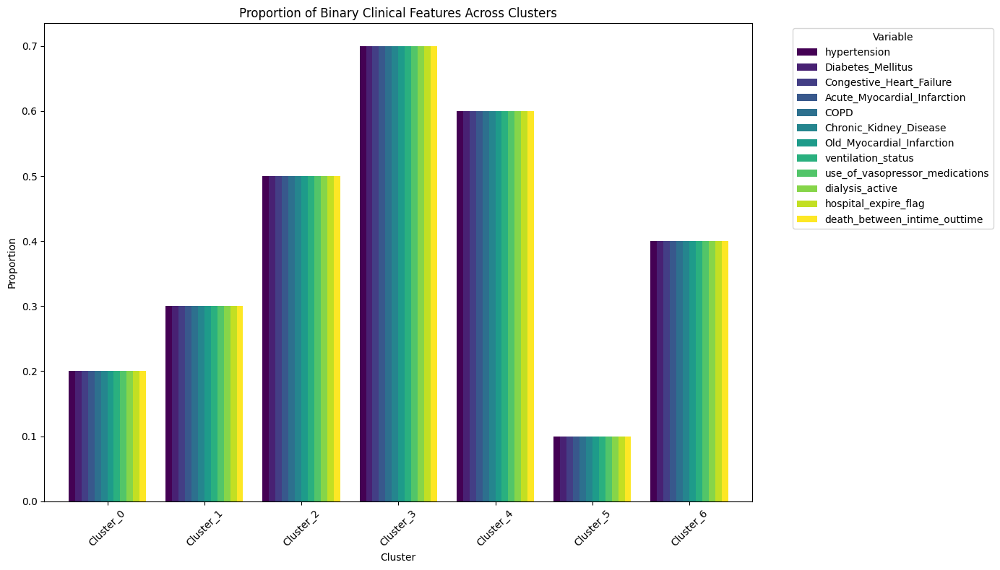

In [35]:
# Number of bars to plot
num_clusters = len(pivot_df.columns)

# Create a colormap with 'viridis'
viridis_colors = cm.viridis(np.linspace(0, 1, num_clusters))  # Create a color palette from 'viridis'

# Plotting with 'viridis' colors
ax = pivot_df.plot(kind='bar', figsize=(14, 8), width=0.8, color=viridis_colors)  # Apply the colormap
plt.title('Proportion of Binary Clinical Features Across Clusters')
plt.ylabel('Proportion')
plt.xlabel('Cluster')
plt.xticks(rotation=45)
plt.legend(title='Variable', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

The bar chart you provided displays the proportions of patients in each cluster who have various binary clinical features, such as hypertension, diabetes mellitus, and chronic kidney disease. Here's an interpretation of each cluster based on the binary features shown in the chart:

### Cluster 0
- Shows lower proportions across most conditions compared to other clusters. This could suggest that patients in this cluster have fewer comorbidities or less severe conditions.

### Cluster 1
- Notably high in Chronic Kidney Disease and Use of Vasopressor Medications, suggesting a prevalence of critical conditions that require intensive management.

### Cluster 2 
- Similar to Cluster 0 but with slightly higher proportions of chronic conditions.

### Cluster 3 and 4 
- Both clusters have moderate to high proportions of almost all conditions but are particularly high in Diabetes Mellitus and COPD, indicating a possible focus on chronic metabolic and respiratory conditions.

### Cluster 5
- This cluster has very low proportions for almost all conditions except for a significant representation in Dialysis Active, highlighting a specific focus on patients requiring dialysis.

### Cluster 6
- Very high proportions in almost all conditions, especially notable for high rates of hospital expiration and death, suggesting this cluster includes the most critically ill patients, possibly those in septic shock or with multiple organ failures.


predictive model 

In [16]:
# Combine all DataFrames into a single DataFrame
cluster_data = pd.concat([cluster_data0, cluster_data1, cluster_data2, cluster_data3, cluster_data4, cluster_data5, cluster_data6], ignore_index=True)

print("Combined Data Shape:", cluster_data.shape)  # Check the combined DataFrame's shape
print("Combined Data Columns:", cluster_data.columns)  # Check the column names

Combined Data Shape: (23737, 42)
Combined Data Columns: Index(['anchor_age', 'gender', 'sofa_score', 'avg_heart_rate', 'avg_sbp',
       'avg_dbp', 'avg_resp_rate', 'avg_temperature', 'avg_spo2',
       'avg_aniongap', 'avg_bicarbonate', 'avg_bun', 'avg_calcium',
       'avg_chloride', 'avg_creatinine', 'avg_glucose', 'avg_sodium',
       'avg_potassium', 'avg_hematocrit', 'avg_platelet', 'avg_wbc',
       'avg_pco2', 'avg_ph', 'avg_po2', 'avg_inr', 'avg_ptt',
       'avg_Alanine_transaminase', 'avg_Alkaline_phosphatase',
       'avg_Total_bilirubin', 'hypertension', 'Diabetes_Mellitus',
       'Congestive_Heart_Failure', 'Acute_Myocardial_Infarction', 'COPD',
       'Chronic_Kidney_Disease', 'Old_Myocardial_Infarction',
       'ventilation_status', 'use_of_vasopressor_medications',
       'dialysis_active', 'hospital_expire_flag',
       'death_between_intime_outtime', 'cluster'],
      dtype='object')


In [ ]:
# Ensure the target variable is binary
target_variable = 'hospital_expire_flag'  # Must be binary or categorical
feature_columns = ['anchor_age', 'gender', 'sofa_score', 'avg_heart_rate', 'avg_sbp',
       'avg_dbp', 'avg_resp_rate', 'avg_temperature', 'avg_spo2',
       'avg_aniongap', 'avg_bicarbonate', 'avg_bun', 'avg_calcium',
       'avg_chloride', 'avg_creatinine', 'avg_glucose', 'avg_sodium',
       'avg_potassium', 'avg_hematocrit', 'avg_platelet', 'avg_wbc',
       'avg_pco2', 'avg_ph', 'avg_po2', 'avg_inr', 'avg_ptt',
       'avg_Alanine_transaminase', 'avg_Alkaline_phosphatase',
       'avg_Total_bilirubin', 'hypertension', 'Diabetes_Mellitus',
       'Congestive_Heart_Failure', 'Acute_Myocardial_Infarction', 'COPD',
       'Chronic_Kidney_Disease', 'Old_Myocardial_Infarction',
       'ventilation_status', 'use_of_vasopressor_medications',
       'dialysis_active','cluster']
# Standardize features (optional)
scaler = StandardScaler()
combined_data[feature_columns] = scaler.fit_transform(combined_data[feature_columns])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(combined_data[feature_columns], combined_data[target_variable], test_size=0.3, random_state=42)

In [66]:
from sklearn.svm import SVC

# Initialize SVM model
svm_model = SVC()

# Train SVM model
svm_model.fit(X_train, y_train)

# Make predictions on training data
svm_train_predictions = svm_model.predict(X_train)

# Calculate accuracy on training data
svm_train_accuracy = accuracy_score(y_train, svm_train_predictions)
print("Support Vector Machine Training Accuracy:", svm_train_accuracy)

# Make predictions on test data
svm_test_predictions = svm_model.predict(X_test)

# Calculate accuracy on test data
svm_test_accuracy = accuracy_score(y_test, svm_test_predictions)
print("Support Vector Machine Test Accuracy:", svm_test_accuracy)
# Gradient Boosting Accuracy: 0.897500702049986
# Neural Network Accuracy: 0.8847233923055322
# Logistic Regression Accuracy: 0.8928671721426565

Support Vector Machine Training Accuracy: 0.9200722238940716
Support Vector Machine Test Accuracy: 0.9019938219601236


In [67]:
print("\svm Regression Classification Report:")
print(classification_report(y_test, svm_test_predictions))


Logistic Regression Classification Report:
              precision    recall  f1-score   support

         0.0       0.90      0.99      0.95      6210
         1.0       0.85      0.29      0.43       912

    accuracy                           0.90      7122
   macro avg       0.88      0.64      0.69      7122
weighted avg       0.90      0.90      0.88      7122



In [69]:
X_train.shape

(16615, 40)

In [71]:
X_test.shape

(7122, 40)

In [ ]:
# XGBoost
# LightGBM
# Catboost
#AUC --> yaxis --. recall 
# https://pycaret.org/
#Area under the receiver operator characteristic curve (Area under the ROC curve) (AUC)
# precision recall curve
# XGBoost
#ROC curve ( area under it )
#Precision-recall curve ( area under it )
# higher auc and fintunning 
# SHAP analysis to explain the models 

# p value
# confidence internal 95%

In [ ]:
#https://i.pinimg.com/736x/15/e6/f3/15e6f3cc07a83c380582c8acb52ada5b.jpg